<a href="https://colab.research.google.com/github/SHREEMATHI-S/climate/blob/main/Time_component_and_perform_time_series_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
plt.style.use("dark_background")
plt.rcParams.update({'figure.figsize': (40, 10), 'font.size': 24})

In [3]:
from google.colab import files
uploads1 = files.upload()

Saving dataset_tk.csv to dataset_tk.csv


In [4]:
import io

ds = pd.read_csv(io.BytesIO(uploads1['dataset_tk.csv']))

In [5]:
ds["date"], ds["tn"] = ds[ds.columns[0]], ds["Tamil Nadu"]

In [6]:
ds.drop(ds.columns[:-2], axis = 1, inplace = True)

In [7]:
ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 503 entries, 0 to 502
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   date    503 non-null    object 
 1   tn      503 non-null    float64
dtypes: float64(1), object(1)
memory usage: 8.0+ KB


In [8]:
ds

,date,tn
0,02/01/2019 00:00:00,268.3
1,03/01/2019 00:00:00,285.2
2,04/01/2019 00:00:00,270.3
3,05/01/2019 00:00:00,286.8
4,06/01/2019 00:00:00,298.3
...,...,...
498,01/12/2020 00:00:00,357.3
499,02/12/2020 00:00:00,356.9
500,03/12/2020 00:00:00,355.1
501,04/12/2020 00:00:00,353.5


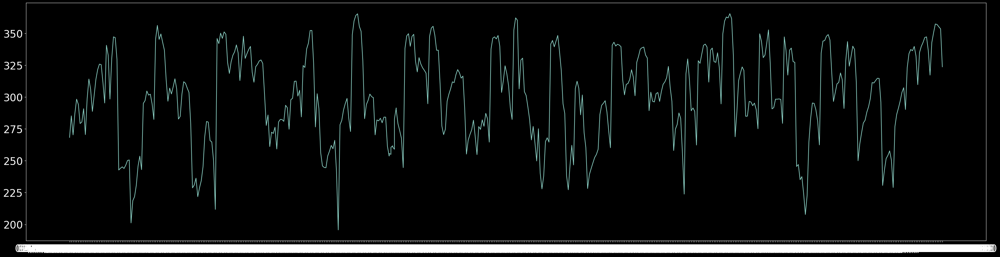

In [9]:
plt.plot(ds["date"], ds["tn"])

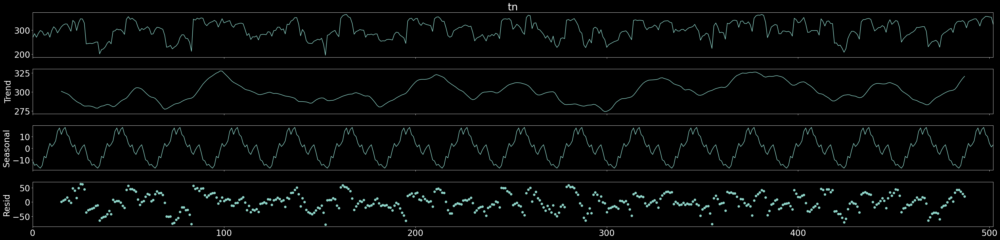

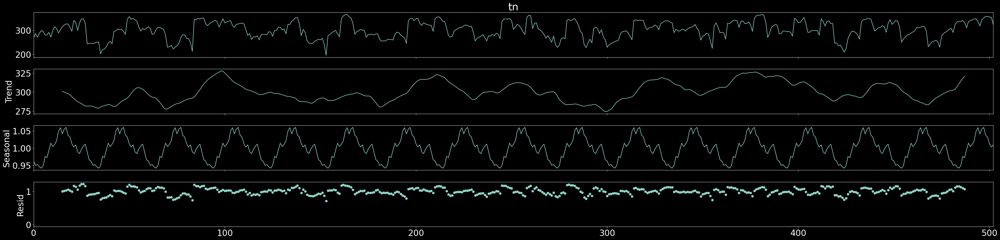

In [10]:
from statsmodels.tsa.seasonal import seasonal_decompose

seasonal_decompose(ds["tn"], model='additive', period = 30).plot().show()
m = seasonal_decompose(ds["tn"], model='multiplicative', period = 30)
m.plot().show()

In [11]:
from statsmodels.tsa.stattools import adfuller, kpss

def adf_test(result):
    print('ADF Statistic: %f' % result[0])
    print('p-value: %.18f' % result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))

    print ("\n stationary \n" if result[1] < 0.05 else "\n Non stationary \n")

def kpss_test(result):
    print('kpss Statistic: %f' % result[0])
    print('p-value: %.18f' % result[1])
    print('Critical Values:')
#     for key, value in result[4].items():
#         print('\t%s: %.3f' % (key, value))

    print ("\n stationary \n" if result[1] < 0.05 else "\n Non stationary \n")
adf_test(adfuller(ds["tn"]))
kpss_test(kpss(ds["tn"]))

ADF Statistic: -7.304888
p-value: 0.000000000130936143
Critical Values:
	1%: -3.443
	5%: -2.867
	10%: -2.570

 stationary 

kpss Statistic: 0.204046
p-value: 0.100000000000000006
Critical Values:

 Non stationary 



<ipython-input-11-8e315c02c39d>:21: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_test(kpss(ds["tn"]))


<Axes: >

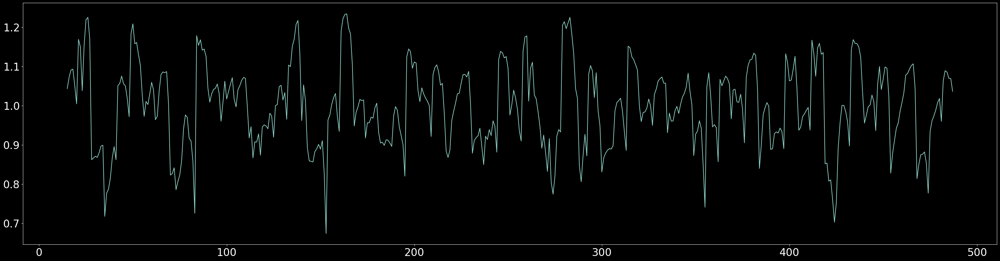

In [12]:
(ds["tn"] / m.trend).plot()

<Axes: >

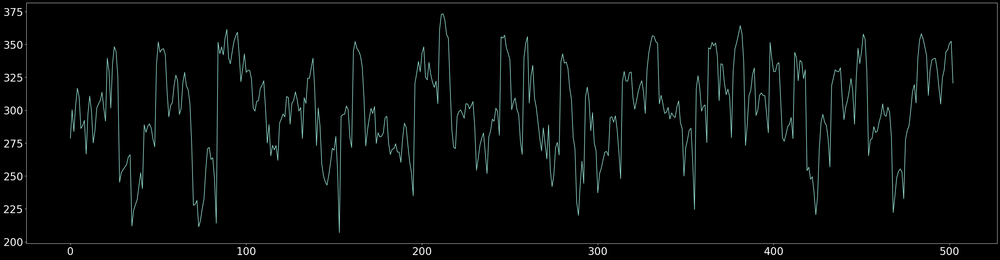

In [13]:
(ds["tn"] / m.seasonal).plot()

<Axes: xlabel='Lag', ylabel='Autocorrelation'>

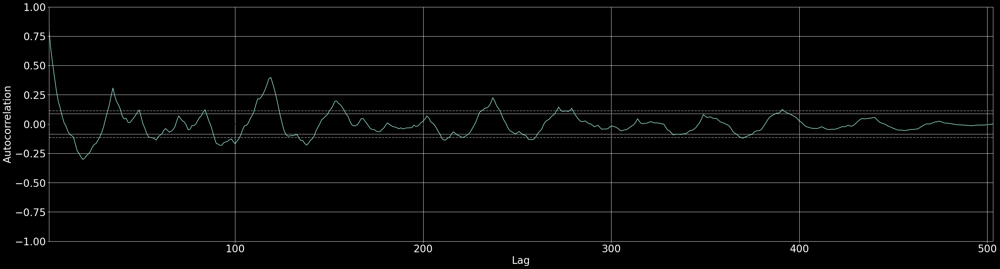

In [14]:
pd.plotting.autocorrelation_plot(ds["tn"])

Figure(4000x1000)


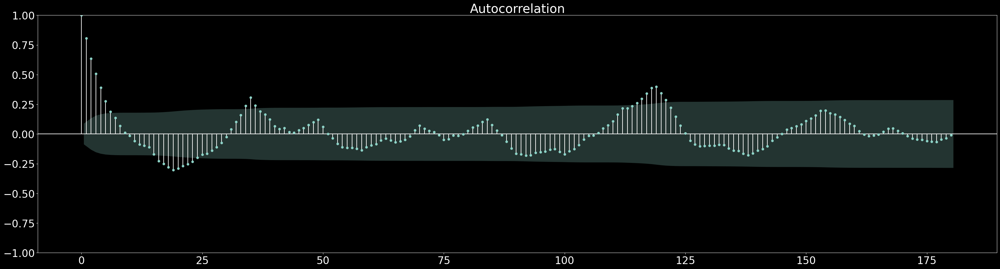

In [15]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

print (plot_acf(ds["tn"], lags = 180))

Figure(4000x1000)


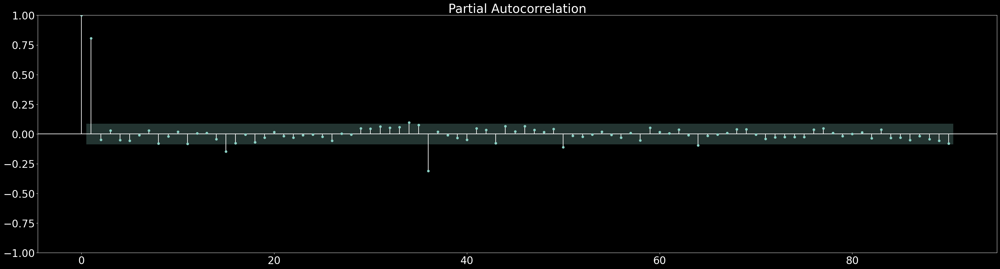

In [16]:
print (plot_pacf(ds["tn"], lags = 90))

In [17]:
df = pd.read_csv(io.BytesIO(uploads1['dataset_tk.csv']))
df.head()

,Unnamed: 0,Punjab,Haryana,Rajasthan,Delhi,UP,Uttarakhand,HP,J&K,Chandigarh,...,Odisha,West Bengal,Sikkim,Arunachal Pradesh,Assam,Manipur,Meghalaya,Mizoram,Nagaland,Tripura
0,02/01/2019 00:00:00,119.9,130.3,234.1,85.8,313.9,40.7,30.0,52.5,5.0,...,70.2,108.2,2.0,2.1,21.7,2.7,6.1,1.9,2.2,3.4
1,03/01/2019 00:00:00,121.9,133.5,240.2,85.5,311.8,39.3,30.1,54.1,4.9,...,67.9,110.2,1.9,2.2,23.4,2.4,6.5,1.8,2.2,3.6
2,04/01/2019 00:00:00,118.8,128.2,239.8,83.5,320.7,38.1,30.1,53.2,4.8,...,66.3,106.8,1.7,2.2,21.7,2.4,6.3,1.7,2.2,3.5
3,05/01/2019 00:00:00,121.0,127.5,239.1,79.2,299.0,39.2,30.2,51.5,4.3,...,65.8,107.0,2.0,2.2,22.5,2.7,5.7,1.8,2.3,3.5
4,06/01/2019 00:00:00,121.4,132.6,240.4,76.6,286.8,39.2,31.0,53.2,4.3,...,62.9,106.4,2.0,2.2,21.7,2.7,6.2,1.9,2.3,3.3


In [18]:
df = df.rename(columns={'Unnamed: 0': 'DateTime'})
df['DateTime'] = pd.to_datetime(df['DateTime'],format="%d/%m/%Y %H:%M:%S")
df['Date'] = pd.to_datetime(df['DateTime']).dt.date
df.tail()

,DateTime,Punjab,Haryana,Rajasthan,Delhi,UP,Uttarakhand,HP,J&K,Chandigarh,...,West Bengal,Sikkim,Arunachal Pradesh,Assam,Manipur,Meghalaya,Mizoram,Nagaland,Tripura,Date
498,2020-12-01,130.8,126.0,220.4,77.3,322.8,36.5,25.4,45.4,3.6,...,172.6,1.4,2.1,20.4,2.1,5.4,1.8,2.0,2.4,2020-12-01
499,2020-12-02,129.4,127.3,218.4,81.3,331.4,37.0,25.8,45.2,3.7,...,174.4,1.5,2.1,23.3,2.4,5.4,1.6,2.1,3.3,2020-12-02
500,2020-12-03,132.1,129.7,205.6,85.6,336.7,37.8,26.2,45.2,4.0,...,169.8,1.4,2.1,21.7,2.3,5.4,1.5,2.0,3.6,2020-12-03
501,2020-12-04,132.1,128.4,207.0,83.9,334.6,38.2,27.0,43.0,4.0,...,145.5,1.2,2.0,24.2,2.5,5.7,1.6,2.0,3.3,2020-12-04
502,2020-12-05,120.4,111.2,201.4,83.6,287.3,35.2,24.3,42.6,3.5,...,110.4,1.2,2.1,20.3,2.5,5.8,1.6,2.1,3.3,2020-12-05


In [19]:
df.columns

Index(['DateTime', 'Punjab', 'Haryana', 'Rajasthan', 'Delhi', 'UP',
       'Uttarakhand', 'HP', 'J&K', 'Chandigarh', 'Chhattisgarh', 'Gujarat',
       'MP', 'Maharashtra', 'Goa', 'DNH', 'Andhra Pradesh', 'Telangana',
       'Karnataka', 'Kerala', 'Tamil Nadu', 'Pondy', 'Bihar', 'Jharkhand',
       'Odisha', 'West Bengal', 'Sikkim', 'Arunachal Pradesh', 'Assam',
       'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland', 'Tripura', 'Date'],
      dtype='object')

In [21]:
cols = ['Punjab', 'Haryana', 'Rajasthan', 'Delhi', 'UP',
       'Uttarakhand', 'HP', 'J&K', 'Chandigarh', 'Chhattisgarh', 'Gujarat',
       'MP', 'Maharashtra', 'Goa', 'DNH', 'Andhra Pradesh', 'Telangana',
       'Karnataka', 'Kerala', 'Tamil Nadu', 'Pondy', 'Bihar', 'Jharkhand',
       'Odisha', 'West Bengal', 'Sikkim', 'Arunachal Pradesh', 'Assam',
       'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland', 'Tripura', 'Date']

subsetdf = df[cols]

subsetdf.set_index('Date',inplace=True)

cumsum_df = subsetdf.cumsum(axis=0)

cumsum_df

,Punjab,Haryana,Rajasthan,Delhi,UP,Uttarakhand,HP,J&K,Chandigarh,Chhattisgarh,...,Odisha,West Bengal,Sikkim,Arunachal Pradesh,Assam,Manipur,Meghalaya,Mizoram,Nagaland,Tripura
Date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,119.9,130.3,234.1,85.8,313.9,40.7,30.0,52.5,5.0,78.7,...,70.2,108.2,2.0,2.1,21.7,2.7,6.1,1.9,2.2,3.4
2019-01-03,241.8,263.8,474.3,171.3,625.7,80.0,60.1,106.6,9.9,157.5,...,138.1,218.4,3.9,4.3,45.1,5.1,12.6,3.7,4.4,7.0
2019-01-04,360.6,392.0,714.1,254.8,946.4,118.1,90.2,159.8,14.7,232.3,...,204.4,325.2,5.6,6.5,66.8,7.5,18.9,5.4,6.6,10.5
2019-01-05,481.6,519.5,953.2,334.0,1245.4,157.3,120.4,211.3,19.0,301.3,...,270.2,432.2,7.6,8.7,89.3,10.2,24.6,7.2,8.9,14.0
2019-01-06,603.0,652.1,1193.6,410.6,1532.2,196.5,151.4,264.5,23.3,369.4,...,333.1,538.6,9.6,10.9,111.0,12.9,30.8,9.1,11.2,17.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-01,70482.2,69085.2,109044.6,41606.1,156670.3,18038.8,13260.5,22088.8,2068.0,41781.2,...,40041.7,69170.1,643.3,1052.6,12465.4,1245.1,2816.5,852.0,1079.5,2041.5
2020-12-02,70611.6,69212.5,109263.0,41687.4,157001.7,18075.8,13286.3,22134.0,2071.7,41883.0,...,40154.0,69344.5,644.8,1054.7,12488.7,1247.5,2821.9,853.6,1081.6,2044.8
2020-12-03,70743.7,69342.2,109468.6,41773.0,157338.4,18113.6,13312.5,22179.2,2075.7,41986.0,...,40267.0,69514.3,646.2,1056.8,12510.4,1249.8,2827.3,855.1,1083.6,2048.4


In [22]:
count_date = cumsum_df.groupby(cumsum_df.index)[['Punjab', 'Haryana', 'Rajasthan', 'Delhi', 'UP',
       'Uttarakhand', 'HP', 'J&K', 'Chandigarh', 'Chhattisgarh', 'Gujarat',
       'MP', 'Maharashtra', 'Goa', 'DNH', 'Andhra Pradesh', 'Telangana',
       'Karnataka', 'Kerala', 'Tamil Nadu', 'Pondy', 'Bihar', 'Jharkhand',
       'Odisha', 'West Bengal', 'Sikkim', 'Arunachal Pradesh', 'Assam',
       'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland', 'Tripura']].sum()

pw_clean = pd.DataFrame(count_date)
pw_clean['Date'] = pd.to_datetime(pw_clean.index)
pw_clean = pw_clean.set_index('Date')

pw_clean.head(20)

,Punjab,Haryana,Rajasthan,Delhi,UP,Uttarakhand,HP,J&K,Chandigarh,Chhattisgarh,...,Odisha,West Bengal,Sikkim,Arunachal Pradesh,Assam,Manipur,Meghalaya,Mizoram,Nagaland,Tripura
Date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,119.9,130.3,234.1,85.8,313.9,40.7,30.0,52.5,5.0,78.7,...,70.2,108.2,2.0,2.1,21.7,2.7,6.1,1.9,2.2,3.4
2019-01-03,241.8,263.8,474.3,171.3,625.7,80.0,60.1,106.6,9.9,157.5,...,138.1,218.4,3.9,4.3,45.1,5.1,12.6,3.7,4.4,7.0
2019-01-04,360.6,392.0,714.1,254.8,946.4,118.1,90.2,159.8,14.7,232.3,...,204.4,325.2,5.6,6.5,66.8,7.5,18.9,5.4,6.6,10.5
2019-01-05,481.6,519.5,953.2,334.0,1245.4,157.3,120.4,211.3,19.0,301.3,...,270.2,432.2,7.6,8.7,89.3,10.2,24.6,7.2,8.9,14.0
2019-01-06,603.0,652.1,1193.6,410.6,1532.2,196.5,151.4,264.5,23.3,369.4,...,333.1,538.6,9.6,10.9,111.0,12.9,30.8,9.1,11.2,17.3
2019-01-07,721.0,784.2,1435.5,481.7,1826.4,236.6,181.5,317.8,27.3,442.5,...,397.1,647.9,11.1,13.1,132.4,15.4,36.9,10.9,13.5,20.6
2019-01-08,828.5,905.6,1672.7,550.7,2115.8,273.6,210.7,369.0,31.1,516.7,...,460.7,750.8,12.7,15.4,153.1,18.0,43.1,12.7,15.6,23.9
2019-01-09,961.0,1053.8,1869.7,639.9,2374.4,309.5,236.0,406.9,35.0,593.9,...,547.3,882.5,13.8,17.5,178.9,20.3,49.1,14.4,18.0,28.1
2019-01-10,1092.5,1210.8,2069.6,732.7,2658.6,344.8,262.5,438.6,38.9,672.9,...,626.1,1022.6,14.9,19.6,204.7,22.7,55.3,16.1,20.1,32.4


In [23]:
count_date = cumsum_df.groupby(cumsum_df.index)[['Punjab', 'Haryana', 'Rajasthan', 'Delhi', 'UP',
       'Uttarakhand', 'HP', 'J&K', 'Chandigarh', 'Chhattisgarh', 'Gujarat',
       'MP', 'Maharashtra', 'Goa', 'DNH', 'Andhra Pradesh', 'Telangana',
       'Karnataka', 'Kerala', 'Tamil Nadu', 'Pondy', 'Bihar', 'Jharkhand',
       'Odisha', 'West Bengal', 'Sikkim', 'Arunachal Pradesh', 'Assam',
       'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland', 'Tripura']].sum()

pw_clean = pd.DataFrame(count_date)
pw_clean['Date'] = pd.to_datetime(pw_clean.index)
pw_clean = pw_clean.set_index('Date')

pw_clean.head(20)

,Punjab,Haryana,Rajasthan,Delhi,UP,Uttarakhand,HP,J&K,Chandigarh,Chhattisgarh,...,Odisha,West Bengal,Sikkim,Arunachal Pradesh,Assam,Manipur,Meghalaya,Mizoram,Nagaland,Tripura
Date,,,,,,,,,,,,,,,,,,,,,
2019-01-02,119.9,130.3,234.1,85.8,313.9,40.7,30.0,52.5,5.0,78.7,...,70.2,108.2,2.0,2.1,21.7,2.7,6.1,1.9,2.2,3.4
2019-01-03,241.8,263.8,474.3,171.3,625.7,80.0,60.1,106.6,9.9,157.5,...,138.1,218.4,3.9,4.3,45.1,5.1,12.6,3.7,4.4,7.0
2019-01-04,360.6,392.0,714.1,254.8,946.4,118.1,90.2,159.8,14.7,232.3,...,204.4,325.2,5.6,6.5,66.8,7.5,18.9,5.4,6.6,10.5
2019-01-05,481.6,519.5,953.2,334.0,1245.4,157.3,120.4,211.3,19.0,301.3,...,270.2,432.2,7.6,8.7,89.3,10.2,24.6,7.2,8.9,14.0
2019-01-06,603.0,652.1,1193.6,410.6,1532.2,196.5,151.4,264.5,23.3,369.4,...,333.1,538.6,9.6,10.9,111.0,12.9,30.8,9.1,11.2,17.3
2019-01-07,721.0,784.2,1435.5,481.7,1826.4,236.6,181.5,317.8,27.3,442.5,...,397.1,647.9,11.1,13.1,132.4,15.4,36.9,10.9,13.5,20.6
2019-01-08,828.5,905.6,1672.7,550.7,2115.8,273.6,210.7,369.0,31.1,516.7,...,460.7,750.8,12.7,15.4,153.1,18.0,43.1,12.7,15.6,23.9
2019-01-09,961.0,1053.8,1869.7,639.9,2374.4,309.5,236.0,406.9,35.0,593.9,...,547.3,882.5,13.8,17.5,178.9,20.3,49.1,14.4,18.0,28.1
2019-01-10,1092.5,1210.8,2069.6,732.7,2658.6,344.8,262.5,438.6,38.9,672.9,...,626.1,1022.6,14.9,19.6,204.7,22.7,55.3,16.1,20.1,32.4


In [24]:
pip install bar-chart-race

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 156.8/156.8 kB 2.4 MB/s eta 0:00:00


In [ ]:
import bar_chart_race as bcr

bcr.bar_chart_race(df=pw_clean, filename =None, figsize= (6,4),title = "State Power Consumption in India")


/usr/local/lib/python3.10/dist-packages/bar_chart_race/_make_chart.py:889: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_values.iloc[:, 0] = df_values.iloc[:, 0].fillna(method='ffill')
/usr/local/lib/python3.10/dist-packages/bar_chart_race/_make_chart.py:286: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(self.df_values.columns)
/usr/local/lib/python3.10/dist-packages/bar_chart_race/_make_chart.py:287: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([max_val] * len(ax.get_xticks()))


In [25]:
import pandas as pd
pd.set_option("display.max_columns",None)

In [26]:
df1 = df.copy('Deep')
df1.head()

,DateTime,Punjab,Haryana,Rajasthan,Delhi,UP,Uttarakhand,HP,J&K,Chandigarh,Chhattisgarh,Gujarat,MP,Maharashtra,Goa,DNH,Andhra Pradesh,Telangana,Karnataka,Kerala,Tamil Nadu,Pondy,Bihar,Jharkhand,Odisha,West Bengal,Sikkim,Arunachal Pradesh,Assam,Manipur,Meghalaya,Mizoram,Nagaland,Tripura,Date
0,2019-01-02,119.9,130.3,234.1,85.8,313.9,40.7,30.0,52.5,5.0,78.7,319.5,253.0,428.6,12.8,18.6,164.6,204.2,206.3,72.7,268.3,6.3,82.3,24.8,70.2,108.2,2.0,2.1,21.7,2.7,6.1,1.9,2.2,3.4,2019-01-02
1,2019-01-03,121.9,133.5,240.2,85.5,311.8,39.3,30.1,54.1,4.9,78.8,316.7,253.6,419.6,13.7,18.2,170.1,204.5,212.2,73.6,285.2,6.5,82.0,25.6,67.9,110.2,1.9,2.2,23.4,2.4,6.5,1.8,2.2,3.6,2019-01-03
2,2019-01-04,118.8,128.2,239.8,83.5,320.7,38.1,30.1,53.2,4.8,74.8,301.9,239.3,395.8,12.6,16.7,165.2,201.2,205.3,73.4,270.3,6.4,82.9,26.3,66.3,106.8,1.7,2.2,21.7,2.4,6.3,1.7,2.2,3.5,2019-01-04
3,2019-01-05,121.0,127.5,239.1,79.2,299.0,39.2,30.2,51.5,4.3,69.0,313.2,228.2,411.1,13.0,17.6,167.4,201.7,212.4,75.4,286.8,6.6,77.0,23.0,65.8,107.0,2.0,2.2,22.5,2.7,5.7,1.8,2.3,3.5,2019-01-05
4,2019-01-06,121.4,132.6,240.4,76.6,286.8,39.2,31.0,53.2,4.3,68.1,320.7,227.4,408.6,12.9,18.6,171.2,194.9,217.5,75.4,298.3,7.2,76.4,22.6,62.9,106.4,2.0,2.2,21.7,2.7,6.2,1.9,2.3,3.3,2019-01-06


In [27]:
df1['year'] = df1['DateTime'].apply(lambda x : x.year)
df1['Quarter'] = df1['DateTime'].apply(lambda x : x.quarter)
df1['month'] = df1['DateTime'].apply(lambda x : x.month)
df1['day'] = df1['DateTime'].apply(lambda x : x.day)
df1['weekofyear'] = df1['DateTime'].apply(lambda x : x.weekofyear)
df1['hour'] = df1['DateTime'].apply(lambda x : x.hour)
df1['minute'] = df1['DateTime'].apply(lambda x : x.minute)
df1['weekday'] = df1['DateTime'].apply(lambda x : x.day_name())
df1['MonthName'] = df1['DateTime'].apply(lambda x : x.month_name())
df1.head()

,DateTime,Punjab,Haryana,Rajasthan,Delhi,UP,Uttarakhand,HP,J&K,Chandigarh,Chhattisgarh,Gujarat,MP,Maharashtra,Goa,DNH,Andhra Pradesh,Telangana,Karnataka,Kerala,Tamil Nadu,Pondy,Bihar,Jharkhand,Odisha,West Bengal,Sikkim,Arunachal Pradesh,Assam,Manipur,Meghalaya,Mizoram,Nagaland,Tripura,Date,year,Quarter,month,day,weekofyear,hour,minute,weekday,MonthName
0,2019-01-02,119.9,130.3,234.1,85.8,313.9,40.7,30.0,52.5,5.0,78.7,319.5,253.0,428.6,12.8,18.6,164.6,204.2,206.3,72.7,268.3,6.3,82.3,24.8,70.2,108.2,2.0,2.1,21.7,2.7,6.1,1.9,2.2,3.4,2019-01-02,2019,1,1,2,1,0,0,Wednesday,January
1,2019-01-03,121.9,133.5,240.2,85.5,311.8,39.3,30.1,54.1,4.9,78.8,316.7,253.6,419.6,13.7,18.2,170.1,204.5,212.2,73.6,285.2,6.5,82.0,25.6,67.9,110.2,1.9,2.2,23.4,2.4,6.5,1.8,2.2,3.6,2019-01-03,2019,1,1,3,1,0,0,Thursday,January
2,2019-01-04,118.8,128.2,239.8,83.5,320.7,38.1,30.1,53.2,4.8,74.8,301.9,239.3,395.8,12.6,16.7,165.2,201.2,205.3,73.4,270.3,6.4,82.9,26.3,66.3,106.8,1.7,2.2,21.7,2.4,6.3,1.7,2.2,3.5,2019-01-04,2019,1,1,4,1,0,0,Friday,January
3,2019-01-05,121.0,127.5,239.1,79.2,299.0,39.2,30.2,51.5,4.3,69.0,313.2,228.2,411.1,13.0,17.6,167.4,201.7,212.4,75.4,286.8,6.6,77.0,23.0,65.8,107.0,2.0,2.2,22.5,2.7,5.7,1.8,2.3,3.5,2019-01-05,2019,1,1,5,1,0,0,Saturday,January
4,2019-01-06,121.4,132.6,240.4,76.6,286.8,39.2,31.0,53.2,4.3,68.1,320.7,227.4,408.6,12.9,18.6,171.2,194.9,217.5,75.4,298.3,7.2,76.4,22.6,62.9,106.4,2.0,2.2,21.7,2.7,6.2,1.9,2.3,3.3,2019-01-06,2019,1,1,6,1,0,0,Sunday,January


In [28]:
def hours2timing(x):
    if x in [22,23,0,1,2,3]:
        timing = 'Night'
    elif x in range(4, 12):
        timing = 'Morning'
    elif x in range(12, 17):
        timing = 'Afternoon'
    elif x in range(17, 22):
        timing = 'Evening'
    else:
        timing = 'X'
    return timing

df1['timing'] = df1['hour'].apply(hours2timing)
df1.head(3)

,DateTime,Punjab,Haryana,Rajasthan,Delhi,UP,Uttarakhand,HP,J&K,Chandigarh,Chhattisgarh,Gujarat,MP,Maharashtra,Goa,DNH,Andhra Pradesh,Telangana,Karnataka,Kerala,Tamil Nadu,Pondy,Bihar,Jharkhand,Odisha,West Bengal,Sikkim,Arunachal Pradesh,Assam,Manipur,Meghalaya,Mizoram,Nagaland,Tripura,Date,year,Quarter,month,day,weekofyear,hour,minute,weekday,MonthName,timing
0,2019-01-02,119.9,130.3,234.1,85.8,313.9,40.7,30.0,52.5,5.0,78.7,319.5,253.0,428.6,12.8,18.6,164.6,204.2,206.3,72.7,268.3,6.3,82.3,24.8,70.2,108.2,2.0,2.1,21.7,2.7,6.1,1.9,2.2,3.4,2019-01-02,2019,1,1,2,1,0,0,Wednesday,January,Night
1,2019-01-03,121.9,133.5,240.2,85.5,311.8,39.3,30.1,54.1,4.9,78.8,316.7,253.6,419.6,13.7,18.2,170.1,204.5,212.2,73.6,285.2,6.5,82.0,25.6,67.9,110.2,1.9,2.2,23.4,2.4,6.5,1.8,2.2,3.6,2019-01-03,2019,1,1,3,1,0,0,Thursday,January,Night
2,2019-01-04,118.8,128.2,239.8,83.5,320.7,38.1,30.1,53.2,4.8,74.8,301.9,239.3,395.8,12.6,16.7,165.2,201.2,205.3,73.4,270.3,6.4,82.9,26.3,66.3,106.8,1.7,2.2,21.7,2.4,6.3,1.7,2.2,3.5,2019-01-04,2019,1,1,4,1,0,0,Friday,January,Night


<ipython-input-29-30fa97f56633>:9: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Q1["Delhi"],color="skyblue", ax=axes[0,0]).set_title("Q1 - Consumption")
<ipython-input-29-30fa97f56633>:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Q2["Delhi"],color="red", ax=axes[0,1]).set_title("Q2 - Consu

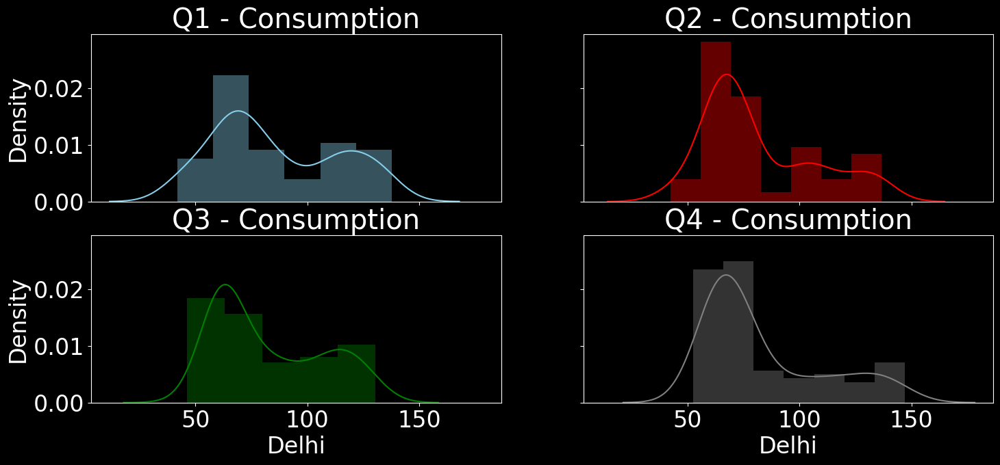

In [29]:
Q1 = df1[df1["Quarter"]==1]
Q2 = df1[df1["Quarter"]==2]
Q3 = df1[df1["Quarter"]==3]
Q4 = df1[df1["Quarter"]==4]

#Plot
fig,axes = plt.subplots(2,2,figsize=(17,7),sharex=True,sharey=True)

sns.distplot(Q1["Delhi"],color="skyblue", ax=axes[0,0]).set_title("Q1 - Consumption")
sns.distplot(Q2["Delhi"],color="red", ax=axes[0,1]).set_title("Q2 - Consumption")
sns.distplot(Q3["Delhi"],color="green", ax=axes[1,0]).set_title("Q3 - Consumption")
sns.distplot(Q4["Delhi"],color="gray", ax=axes[1,1]).set_title("Q4 - Consumption")

del Q1, Q2, Q3, Q4


In [30]:
delhi = pd.DataFrame(data=df1,columns=['Delhi','DateTime'])
delhi.head()

,Delhi,DateTime
0,85.8,2019-01-02
1,85.5,2019-01-03
2,83.5,2019-01-04
3,79.2,2019-01-05
4,76.6,2019-01-06


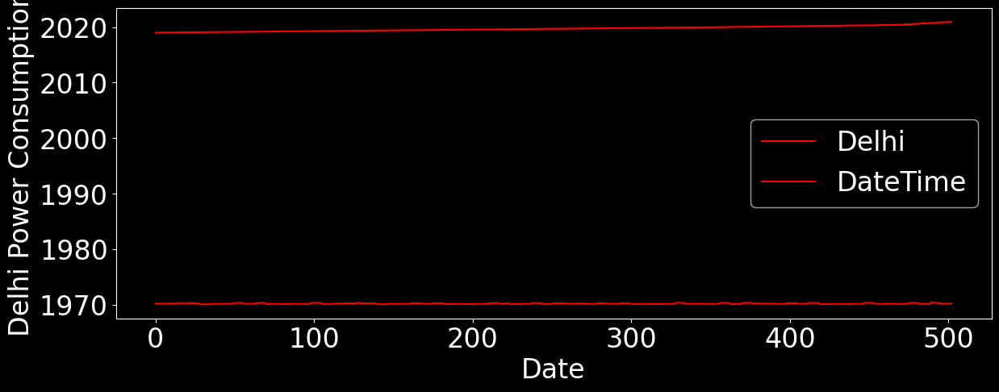

In [31]:
delhi.plot(figsize=(14,5),color='Red')
plt.xlabel('Date')
plt.ylabel('Delhi Power Consumption')
plt.show()

In [32]:
df2 = pd.DataFrame(data=df1,columns=['Delhi','DateTime'])

df2.rename(columns={"DateTime" : "ds", "Delhi" : "y"},inplace=True)
df2.head()

,y,ds
0,85.8,2019-01-02
1,85.5,2019-01-03
2,83.5,2019-01-04
3,79.2,2019-01-05
4,76.6,2019-01-06


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptlly01ad/bgk6ml0m.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptlly01ad/wg0h5emg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79631', 'data', 'file=/tmp/tmptlly01ad/bgk6ml0m.json', 'init=/tmp/tmptlly01ad/wg0h5emg.json', 'output', 'file=/tmp/tmptlly01ad/prophet_modelkb2b0olo/prophet_model-20241120111957.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
11:19:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
11:19:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


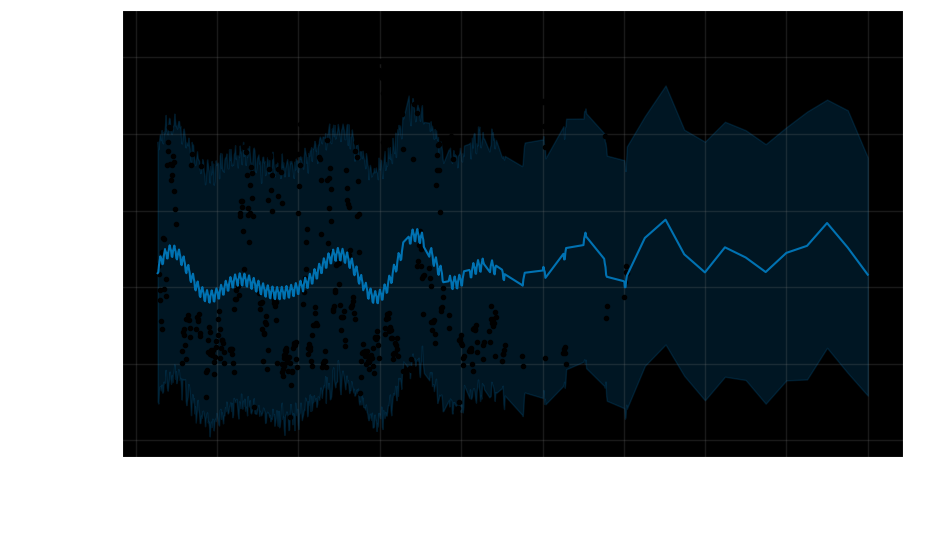

In [33]:
from prophet import Prophet
model = Prophet(seasonality_mode='multiplicative',yearly_seasonality=4)
model.fit(df2)
future = model.make_future_dataframe(periods=12 * 1, freq='MS')  #
forecast = model.predict(future)
fig = model.plot(forecast)
plt.show()

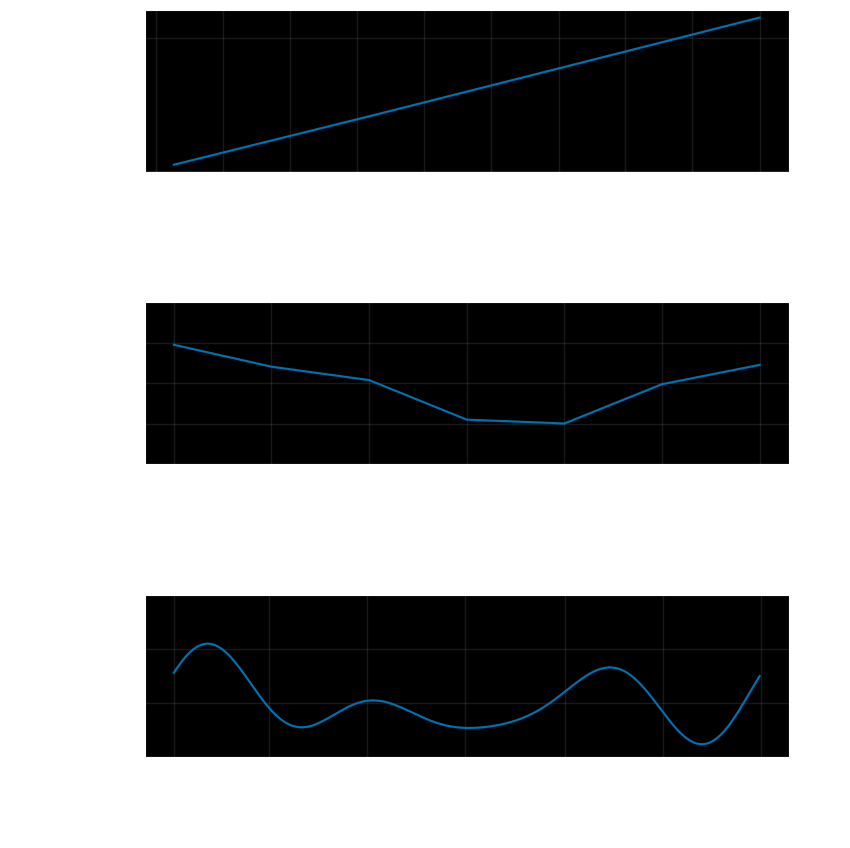

In [34]:
fig_a2 = model.plot_components(forecast)
plt.show()

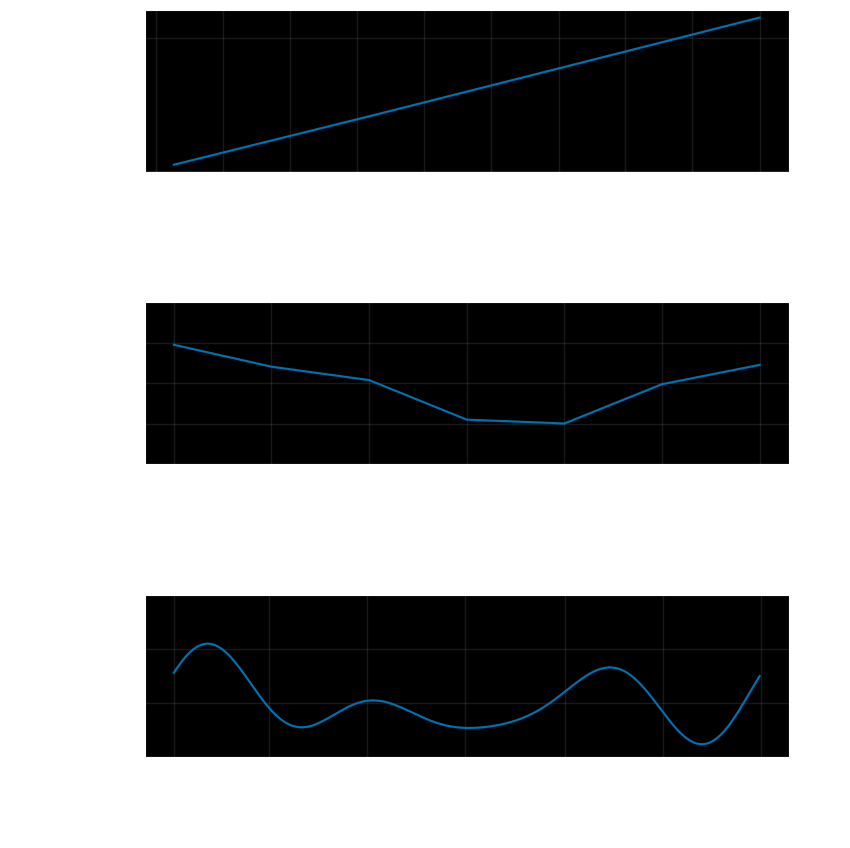

In [35]:
fig_m2 = model.plot_components(forecast)
plt.show()

In [36]:
import pandas as pd
from prophet import Prophet

# Rename columns for compatibility with Prophet
df2 = pd.DataFrame(data=df1, columns=['Delhi', 'DateTime'])
df2.rename(columns={"DateTime": "ds", "Delhi": "y"}, inplace=True)

# Initialize and fit the Prophet model
model = Prophet(seasonality_mode='multiplicative', yearly_seasonality=4)
model.fit(df2)

# Create a DataFrame for future predictions (e.g., predict the next 12 months)
future = model.make_future_dataframe(periods=12, freq='MS')  # Monthly predictions for 1 year
forecast = model.predict(future)

# Select and save relevant columns from the forecast for output
forecast_df = forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

# Save the forecast as a new CSV file
forecast_df.to_csv("future_forecast.csv", index=False)

print("Future predictions saved to 'future_forecast.csv'")


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptlly01ad/xu4fi_ee.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptlly01ad/j2drm135.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26879', 'data', 'file=/tmp/tmptlly01ad/xu4fi_ee.json', 'init=/tmp/tmptlly01ad/j2drm135.json', 'output', 'file=/tmp/tmptlly01ad/prophet_modeljk5umisl/prophet_model-20241120112003.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
11:20:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
11:20:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Future predictions saved to 'future_forecast.csv'


In [37]:
import pandas as pd
from prophet import Prophet

# Rename columns for compatibility with Prophet
df2 = pd.DataFrame(data=df1, columns=['Delhi', 'DateTime'])
df2.rename(columns={"DateTime": "ds", "Delhi": "y"}, inplace=True)

# Initialize and fit the Prophet model
model = Prophet(seasonality_mode='multiplicative', yearly_seasonality=4)
model.fit(df2)

# Create a DataFrame for future predictions (e.g., predict the next 12 months)
future = model.make_future_dataframe(periods=12, freq='MS')  # Monthly predictions for 1 year
forecast = model.predict(future)

# Select relevant columns from the forecast for output
forecast_df = forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

# Print the forecasted dataset
print(forecast_df)


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptlly01ad/6iklvjj1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptlly01ad/v9b_nafl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91948', 'data', 'file=/tmp/tmptlly01ad/6iklvjj1.json', 'init=/tmp/tmptlly01ad/v9b_nafl.json', 'output', 'file=/tmp/tmptlly01ad/prophet_modelp7o55nsz/prophet_model-20241120112005.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
11:20:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
11:20:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


            ds       yhat  yhat_lower  yhat_upper
0   2019-01-02  83.656110   50.451248  117.753993
1   2019-01-03  83.874579   48.675637  116.114859
2   2019-01-04  85.796809   54.137658  119.081942
3   2019-01-05  86.912126   53.713285  119.154967
4   2019-01-06  88.048363   56.881356  120.722955
..         ...        ...         ...         ...
505 2021-08-01  88.953021   56.679677  120.690967
506 2021-09-01  90.795400   59.458016  124.644359
507 2021-10-01  96.756426   62.579430  129.132376
508 2021-11-01  90.329447   59.998158  123.261025
509 2021-12-01  83.257607   50.435299  114.222338

[510 rows x 4 columns]


In [38]:
import pandas as pd
from prophet import Prophet

# Rename columns for compatibility with Prophet
df2 = pd.DataFrame(data=df1, columns=['Delhi', 'DateTime'])
df2.rename(columns={"DateTime": "ds", "Delhi": "y"}, inplace=True)

# Initialize and fit the Prophet model
model = Prophet(seasonality_mode='multiplicative', yearly_seasonality=4)
model.fit(df2)

# Create a DataFrame for future predictions (e.g., predict the next 12 months)
future = model.make_future_dataframe(periods=12, freq='MS')  # Monthly predictions for 1 year
forecast = model.predict(future)

# Select relevant columns from the forecast for output
forecast_df = forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

# Set pandas option to display all rows
pd.set_option('display.max_rows', None)

# Print the forecasted dataset
print(forecast_df)

# Optionally reset the max rows setting after printing
pd.reset_option('display.max_rows')


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptlly01ad/6xfxicda.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptlly01ad/0stnxprn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63160', 'data', 'file=/tmp/tmptlly01ad/6xfxicda.json', 'init=/tmp/tmptlly01ad/0stnxprn.json', 'output', 'file=/tmp/tmptlly01ad/prophet_model9mmmbzhh/prophet_model-20241120112008.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
11:20:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
11:20:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


            ds       yhat  yhat_lower  yhat_upper
0   2019-01-02  83.656110   50.335903  116.796772
1   2019-01-03  83.874579   51.553903  116.390297
2   2019-01-04  85.796809   53.655471  120.391416
3   2019-01-05  86.912126   53.288064  121.024922
4   2019-01-06  88.048363   53.880659  119.068793
5   2019-01-07  87.497548   55.130138  120.786218
6   2019-01-08  87.272315   56.696960  121.241612
7   2019-01-09  85.990222   52.422927  117.332275
8   2019-01-10  86.110803   54.055752  117.546126
9   2019-01-11  87.930262   51.406244  119.875156
10  2019-01-12  88.936044   57.824949  120.273514
11  2019-01-13  89.957097   58.231675  122.493852
12  2019-01-14  89.284324   55.200125  120.896716
13  2019-01-15  88.932566   56.631021  121.136471
14  2019-01-16  87.518579   55.624499  120.302062
15  2019-01-17  87.504530   55.518636  121.891108
16  2019-01-18  89.187346   58.001654  123.525932
17  2019-01-19  90.052704   56.565437  121.636877
18  2019-01-20  90.930768   57.371502  122.760672


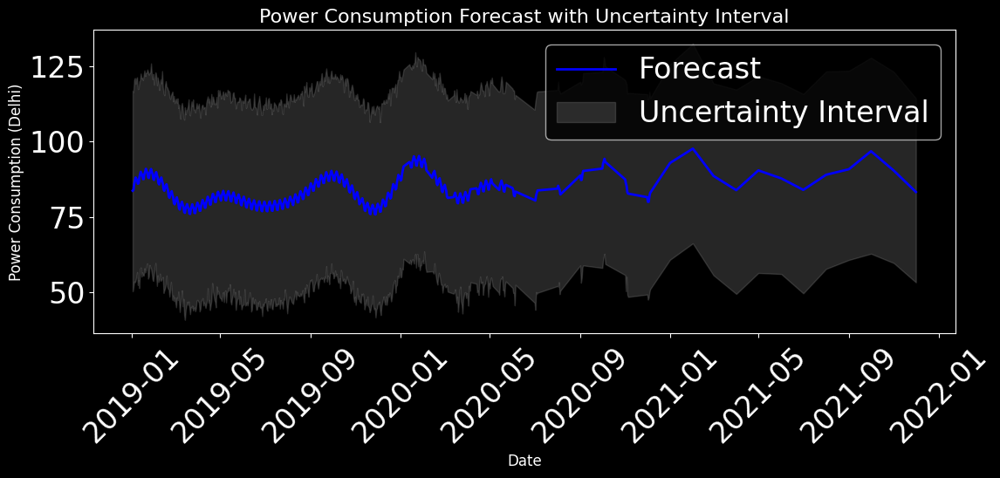

In [39]:
import matplotlib.pyplot as plt

# Create a plot for the forecasted data
plt.figure(figsize=(12, 6))

# Plot the forecasted values (yhat) with uncertainty bounds
plt.plot(forecast_df['ds'], forecast_df['yhat'], label='Forecast', color='blue', linewidth=2)
plt.fill_between(forecast_df['ds'], forecast_df['yhat_lower'], forecast_df['yhat_upper'], color='gray', alpha=0.3, label='Uncertainty Interval')

# Adding labels and title
plt.title('Power Consumption Forecast with Uncertainty Interval', fontsize=16)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Power Consumption (Delhi)', fontsize=12)
plt.xticks(rotation=45)
plt.legend()

plt.tight_layout()
plt.show()


<ipython-input-40-f689e633e77c>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  forecast_df['ds'] = pd.to_datetime(forecast_df['ds'])  # Ensure 'ds' is in datetime format


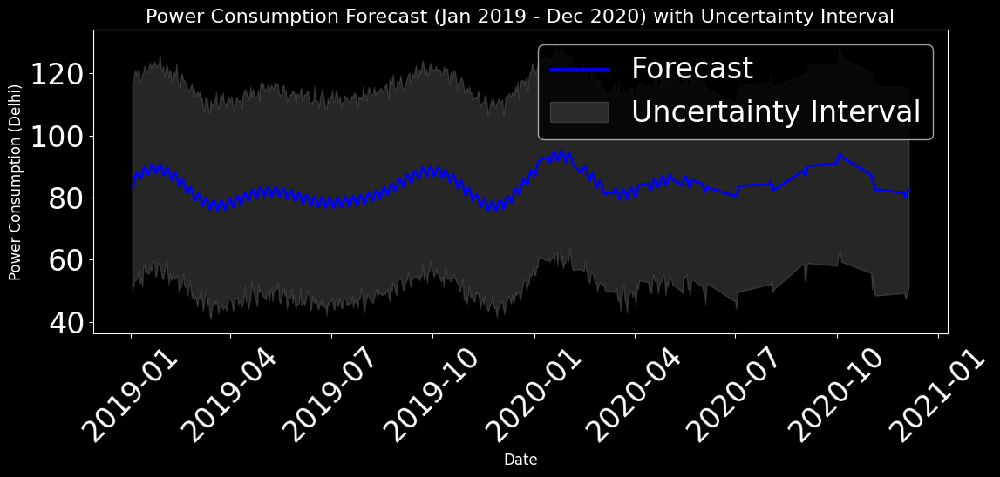

In [40]:
import matplotlib.pyplot as plt

# Filter the forecast data to include only the period from Jan 2019 to Dec 2020
forecast_df['ds'] = pd.to_datetime(forecast_df['ds'])  # Ensure 'ds' is in datetime format
forecast_filtered = forecast_df[(forecast_df['ds'] >= '2019-01-01') & (forecast_df['ds'] <= '2020-12-31')]

# Create a plot for the filtered forecast data
plt.figure(figsize=(12, 6))

# Plot the forecasted values (yhat) with uncertainty bounds
plt.plot(forecast_filtered['ds'], forecast_filtered['yhat'], label='Forecast', color='blue', linewidth=2)
plt.fill_between(forecast_filtered['ds'], forecast_filtered['yhat_lower'], forecast_filtered['yhat_upper'],
                 color='gray', alpha=0.3, label='Uncertainty Interval')

# Adding labels and title
plt.title('Power Consumption Forecast (Jan 2019 - Dec 2020) with Uncertainty Interval', fontsize=16)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Power Consumption (Delhi)', fontsize=12)
plt.xticks(rotation=45)
plt.legend()

plt.tight_layout()
plt.show()


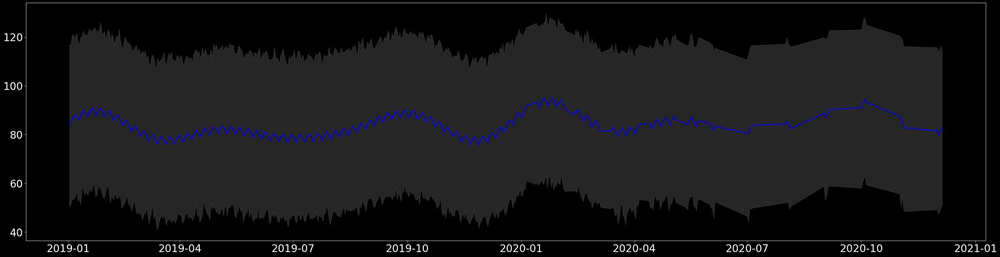

In [41]:
# Plot the forecasted values (yhat) with uncertainty bounds
plt.plot(forecast_filtered['ds'], forecast_filtered['yhat'], label='Forecast', color='blue', linewidth=2)
plt.fill_between(forecast_filtered['ds'], forecast_filtered['yhat_lower'], forecast_filtered['yhat_upper'],
                 color='gray', alpha=0.3, label='Uncertainty Interval')


<ipython-input-42-49466700d43a>:9: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg_forecast = forecast_2019['yhat'].resample('M').mean()


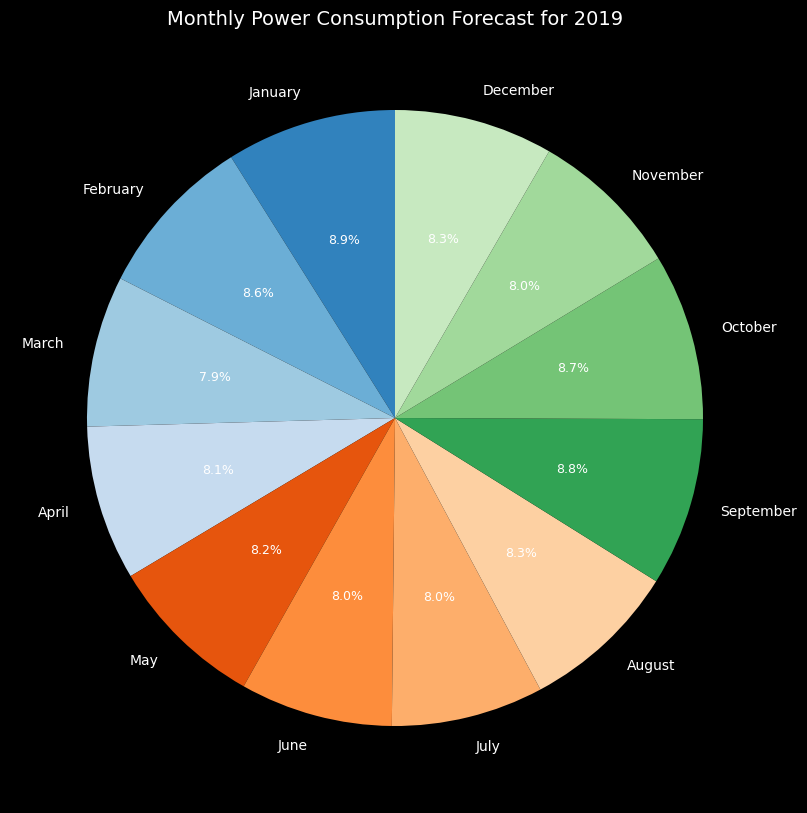

In [42]:
import matplotlib.pyplot as plt
import pandas as pd

# Filter for 2019 data
forecast_2019 = forecast[(forecast['ds'] >= '2019-01-01') & (forecast['ds'] <= '2019-12-31')]
forecast_2019.set_index('ds', inplace=True)

# Resample to get monthly averages
monthly_avg_forecast = forecast_2019['yhat'].resample('M').mean()

# Define custom colors
colors = plt.cm.tab20c.colors  # Use the same visually appealing colormap

# Plot pie chart for 2019
plt.figure(figsize=(10, 10))
wedges, texts, autotexts = plt.pie(
    monthly_avg_forecast,
    labels=monthly_avg_forecast.index.strftime('%B'),
    autopct='%1.1f%%',
    startangle=90,
    colors=colors,  # Apply custom colors
    textprops={'fontsize': 10}  # Reduce font size of labels
)

# Customize font size for percentage values
for autotext in autotexts:
    autotext.set_fontsize(9)  # Adjust percentage font size

plt.title('Monthly Power Consumption Forecast for 2019', fontsize=14)
plt.show()



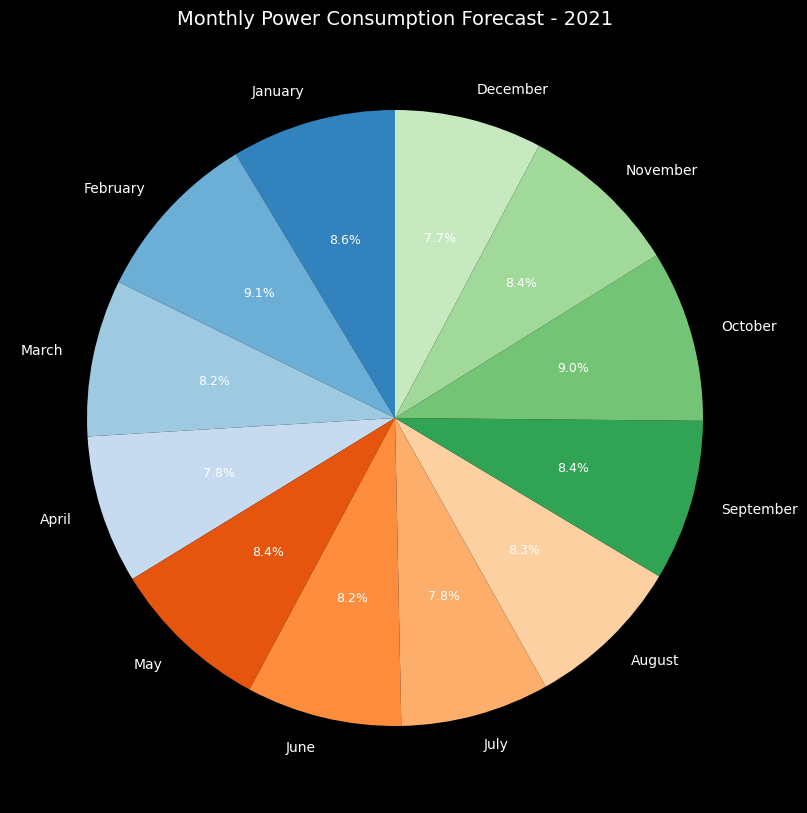

In [43]:
import pandas as pd
import matplotlib.pyplot as plt

# Define a custom color palette
colors = plt.cm.tab20c.colors  # Use a visually appealing colormap (e.g., tab20c)

# Filter for 2021 data
forecast_2021 = forecast[(forecast['ds'] >= '2021-01-01') & (forecast['ds'] <= '2021-12-31')]
forecast_2021.set_index('ds', inplace=True)

# Plot pie chart for 2021
plt.figure(figsize=(10, 10))
wedges, texts, autotexts = plt.pie(
    forecast_2021['yhat'],
    labels=forecast_2021.index.strftime('%B'),
    autopct='%1.1f%%',
    startangle=90,
    colors=colors,  # Apply the custom colors
    textprops={'fontsize': 10}  # Reduce font size of labels
)

# Customize the font size of the percentage values
for autotext in autotexts:
    autotext.set_fontsize(9)  # Reduce font size of percentages inside the chart

plt.title("Monthly Power Consumption Forecast - 2021", fontsize=14)
plt.show()



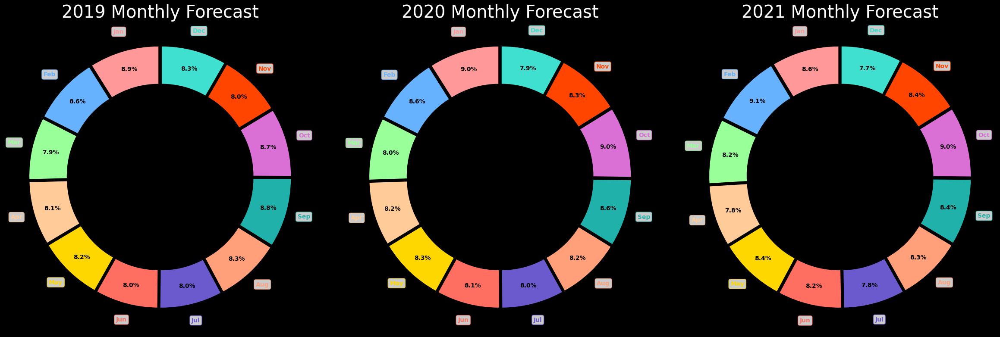

In [46]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'forecast' DataFrame has columns 'ds' (date) and 'yhat' (predicted values)
# Convert 'ds' column to datetime to enable easy filtering by year
forecast['ds'] = pd.to_datetime(forecast['ds'])

# Filter data for each year
forecast_2019 = forecast[forecast['ds'].dt.year == 2019]
forecast_2020 = forecast[forecast['ds'].dt.year == 2020]
forecast_2021 = forecast[forecast['ds'].dt.year == 2021]

# Aggregate monthly predictions by averaging each month’s predictions
forecast_2019 = forecast_2019.groupby(forecast_2019['ds'].dt.month).mean()
forecast_2020 = forecast_2020.groupby(forecast_2020['ds'].dt.month).mean()
forecast_2021 = forecast_2021.groupby(forecast_2021['ds'].dt.month).mean()

# Labels and colors
months = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
colors = ['#FF9999', '#66B2FF', '#99FF99', '#FFCC99', '#FFD700', '#FF6F61', '#6A5ACD', '#FFA07A', '#20B2AA', '#DA70D6', '#FF4500', '#40E0D0']
explode = [0.05] * 12  # Slightly "explode" each slice for visibility

# Create pie charts for each year
fig, axes = plt.subplots(1, 3, figsize=(24, 8))

# Function to add annotations outside the pie slices
def plot_pie_with_annotations(ax, data, title):
    wedges, texts, autotexts = ax.pie(
        data, labels=None, colors=colors, autopct='%1.1f%%', startangle=90,
        pctdistance=0.85, explode=explode, wedgeprops=dict(width=0.3)
    )
    # Adjust autotexts for better visibility
    for autotext in autotexts:
        autotext.set_color('black')
        autotext.set_fontsize(10)
        autotext.set_weight('bold')

    # Add annotations outside the pie chart
    for i, p in enumerate(wedges):
        ang = (p.theta2 - p.theta1) / 2. + p.theta1
        y = 1.2 * np.sin(np.deg2rad(ang))  # Increase radial distance to prevent overlaps
        x = 1.2 * np.cos(np.deg2rad(ang))
        ax.annotate(
            f'{months[i]}', xy=(x, y), ha='center', color=colors[i], fontsize=10, weight='bold',
            bbox=dict(boxstyle="round,pad=0.3", edgecolor=colors[i], facecolor='white', alpha=0.8)
        )
    ax.set_title(title)

# Plot for 2019
plot_pie_with_annotations(axes[0], forecast_2019['yhat'], "2019 Monthly Forecast")

# Plot for 2020
plot_pie_with_annotations(axes[1], forecast_2020['yhat'], "2020 Monthly Forecast")

# Plot for 2021
plot_pie_with_annotations(axes[2], forecast_2021['yhat'], "2021 Monthly Forecast")

# Display the plots
plt.tight_layout()
plt.show()


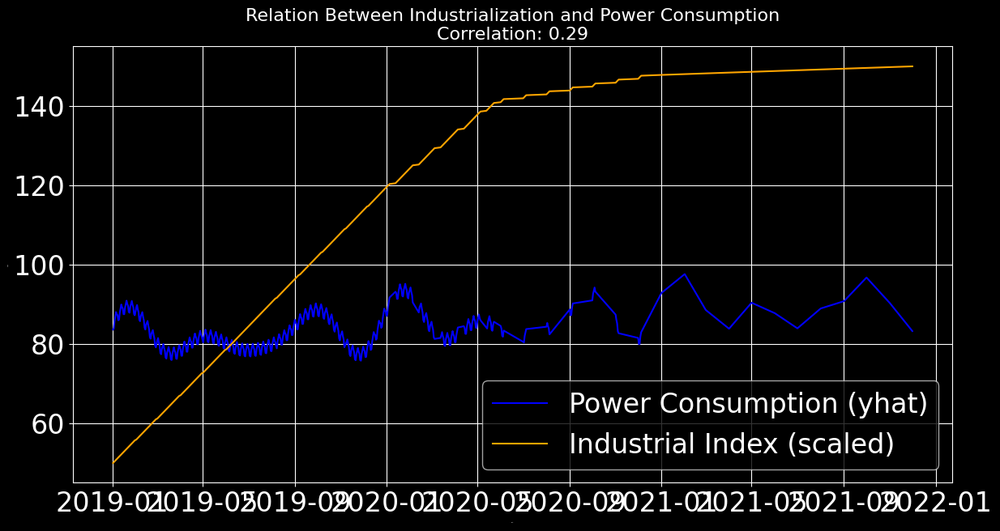

          ds       yhat  industrial_index
0 2019-01-02  83.656110         50.000000
1 2019-01-03  83.874579         50.196464
2 2019-01-04  85.796809         50.392927
3 2019-01-05  86.912126         50.589391
4 2019-01-06  88.048363         50.785855


In [47]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Assume industrialization index increases linearly over time for the demonstration
# Add 'industrial_index' to the existing forecast DataFrame
forecast['industrial_index'] = np.linspace(50, 150, len(forecast))  # Hypothetical data: values increasing from 50 to 150

# Combine power consumption predictions (yhat) and industrial index into one DataFrame for analysis
industrial_analysis = forecast[['ds', 'yhat', 'industrial_index']]

# Compute correlation between 'yhat' and 'industrial_index'
correlation = industrial_analysis[['yhat', 'industrial_index']].corr().iloc[0, 1]

# Plotting the relationship
plt.figure(figsize=(14, 7))

# Power Consumption
plt.plot(industrial_analysis['ds'], industrial_analysis['yhat'], label='Power Consumption (yhat)', color='blue')

# Industrial Index (scaled for visibility on the same plot)
plt.plot(industrial_analysis['ds'], industrial_analysis['industrial_index'], label='Industrial Index (scaled)', color='orange')

# Add labels, legend, and title
plt.title(f"Relation Between Industrialization and Power Consumption\nCorrelation: {correlation:.2f}", fontsize=16)
plt.xlabel("Date", fontsize=1)
plt.ylabel("Value", fontsize=1)
plt.legend()
plt.grid()

plt.show()

# Display sample data for verification
print(industrial_analysis.head())


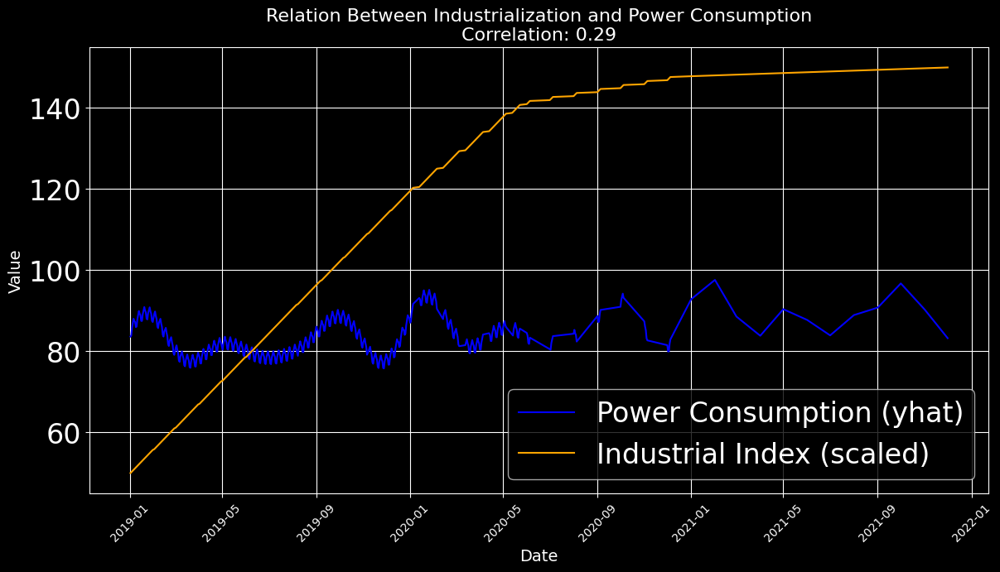

          ds       yhat  industrial_index
0 2019-01-02  83.656110         50.000000
1 2019-01-03  83.874579         50.196464
2 2019-01-04  85.796809         50.392927
3 2019-01-05  86.912126         50.589391
4 2019-01-06  88.048363         50.785855


In [48]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Assume industrialization index increases linearly over time for demonstration
forecast['industrial_index'] = np.linspace(50, 150, len(forecast))  # Hypothetical data: values increasing from 50 to 150

# Combine power consumption predictions (yhat) and industrial index into one DataFrame for analysis
industrial_analysis = forecast[['ds', 'yhat', 'industrial_index']]

# Compute correlation between 'yhat' and 'industrial_index'
correlation = industrial_analysis[['yhat', 'industrial_index']].corr().iloc[0, 1]

# Plotting the relationship
plt.figure(figsize=(14, 7))

# Power Consumption
plt.plot(industrial_analysis['ds'], industrial_analysis['yhat'], label='Power Consumption (yhat)', color='blue')

# Industrial Index (scaled for visibility on the same plot)
plt.plot(industrial_analysis['ds'], industrial_analysis['industrial_index'], label='Industrial Index (scaled)', color='orange')

# Adjusting x-axis labels
plt.xticks(fontsize=10, rotation=45)  # Reduce font size and rotate labels
plt.title(f"Relation Between Industrialization and Power Consumption\nCorrelation: {correlation:.2f}", fontsize=16)
plt.xlabel("Date", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend()
plt.grid()

plt.show()

# Display sample data for verification
print(industrial_analysis.head())


Generating pie chart for Punjab in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


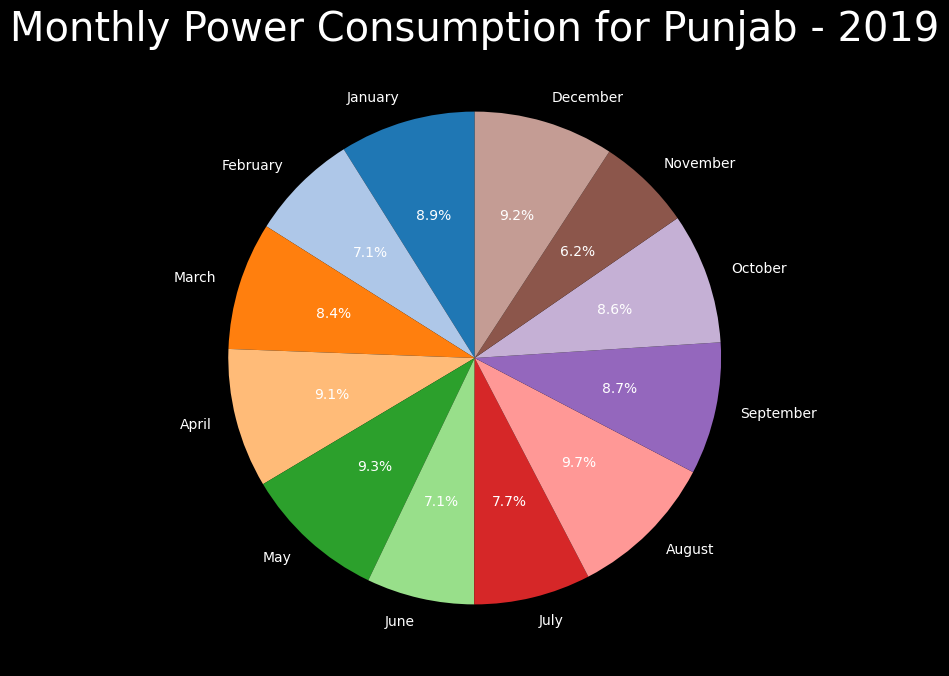

Generating pie chart for Haryana in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


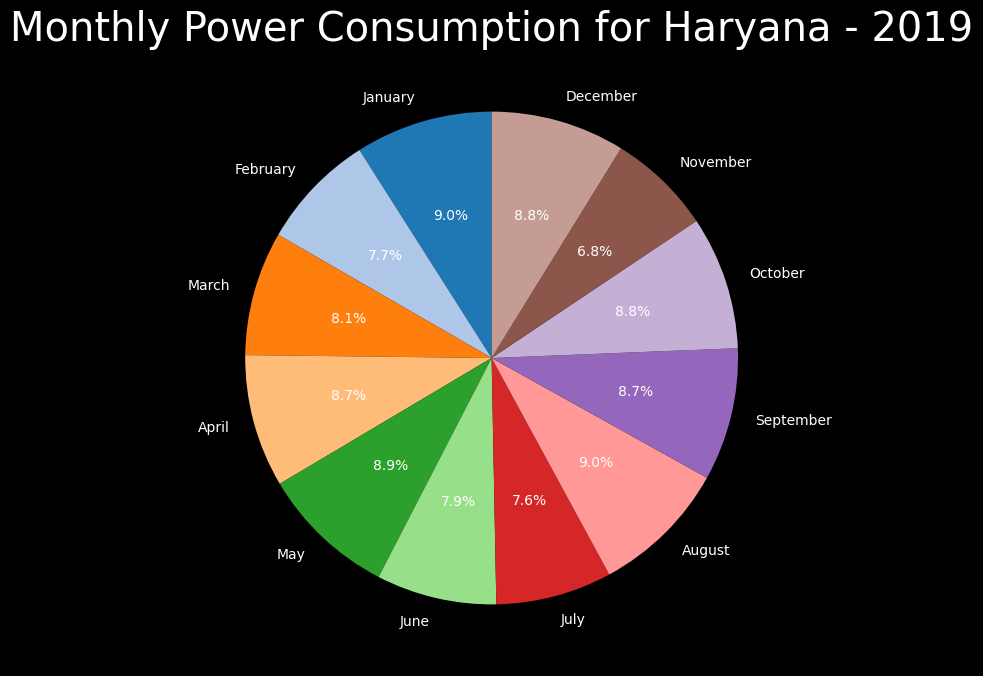

Generating pie chart for Rajasthan in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


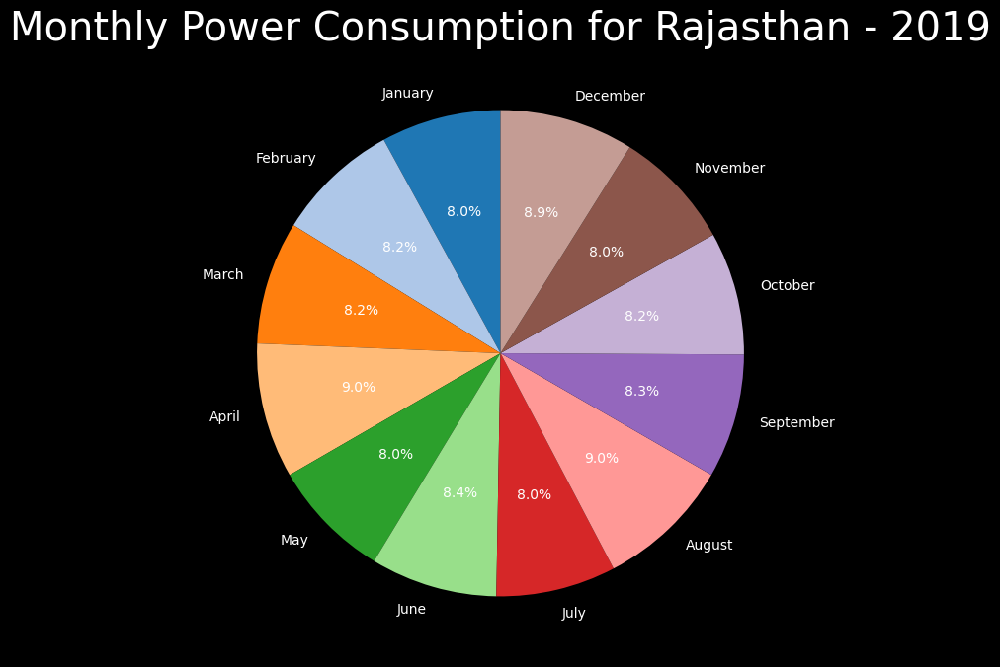

Generating pie chart for Delhi in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


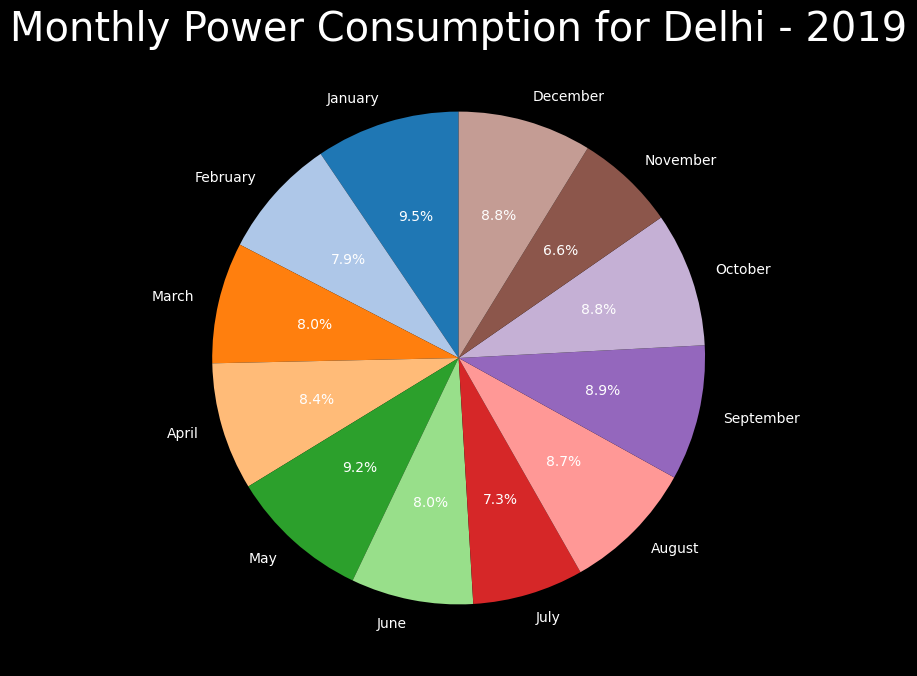

Generating pie chart for UP in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


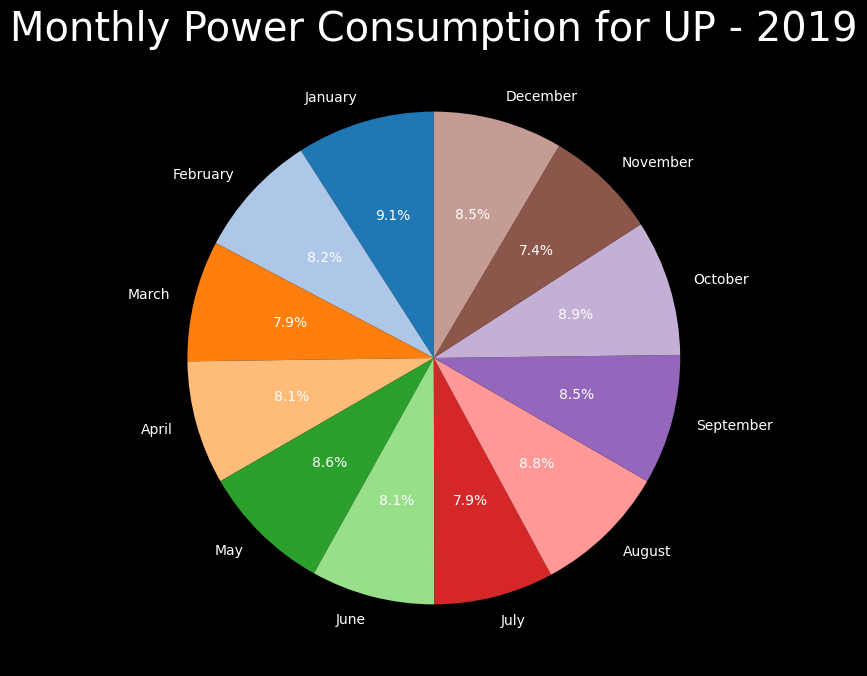

Generating pie chart for Uttarakhand in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


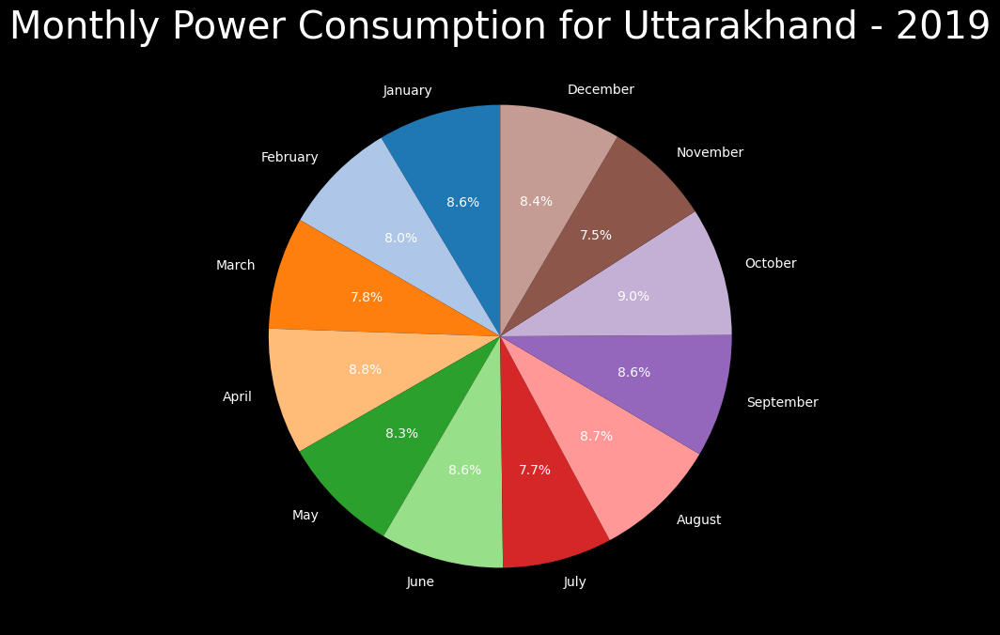

Generating pie chart for HP in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


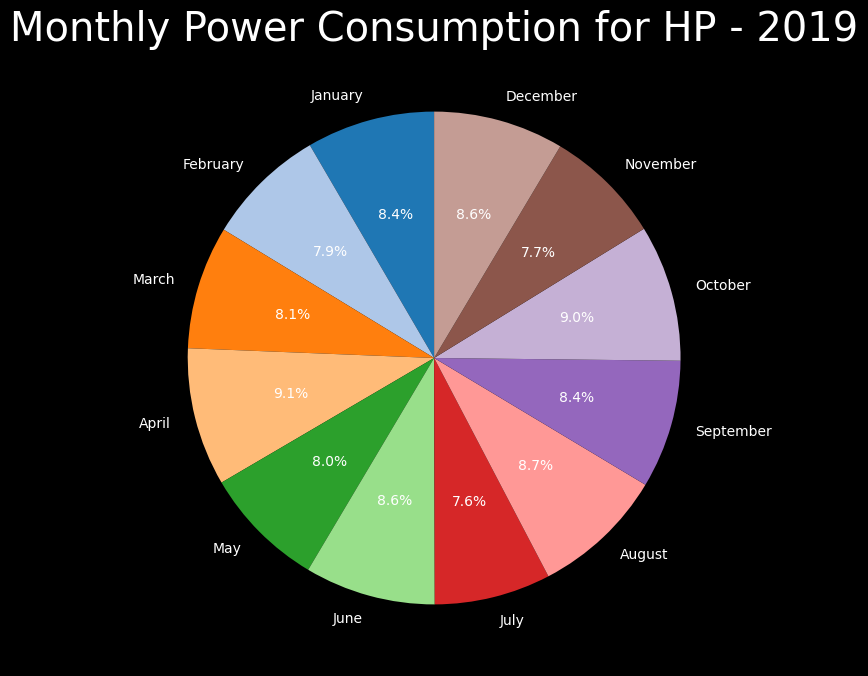

Generating pie chart for J&K in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


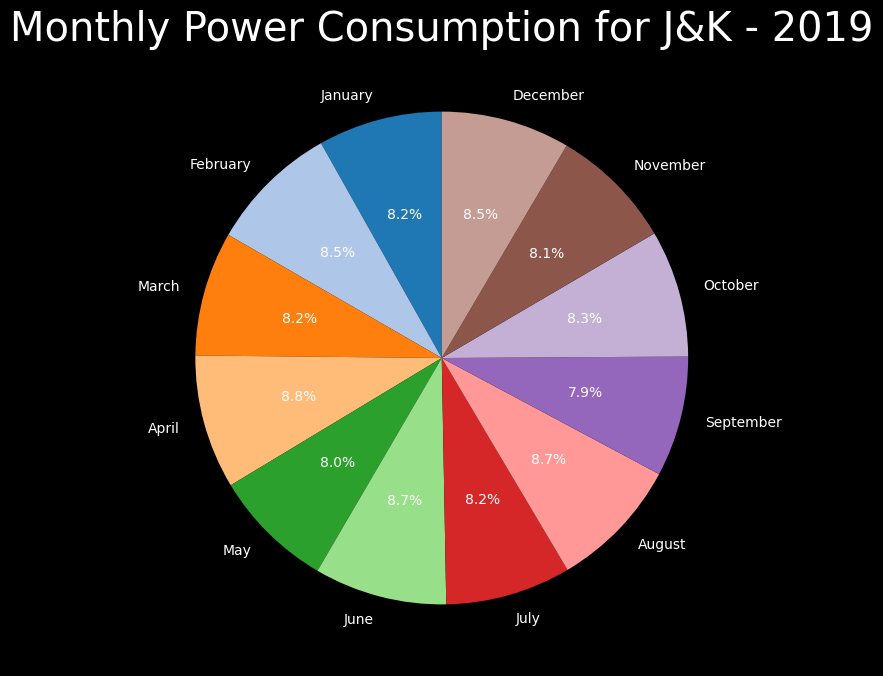

Generating pie chart for Chandigarh in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


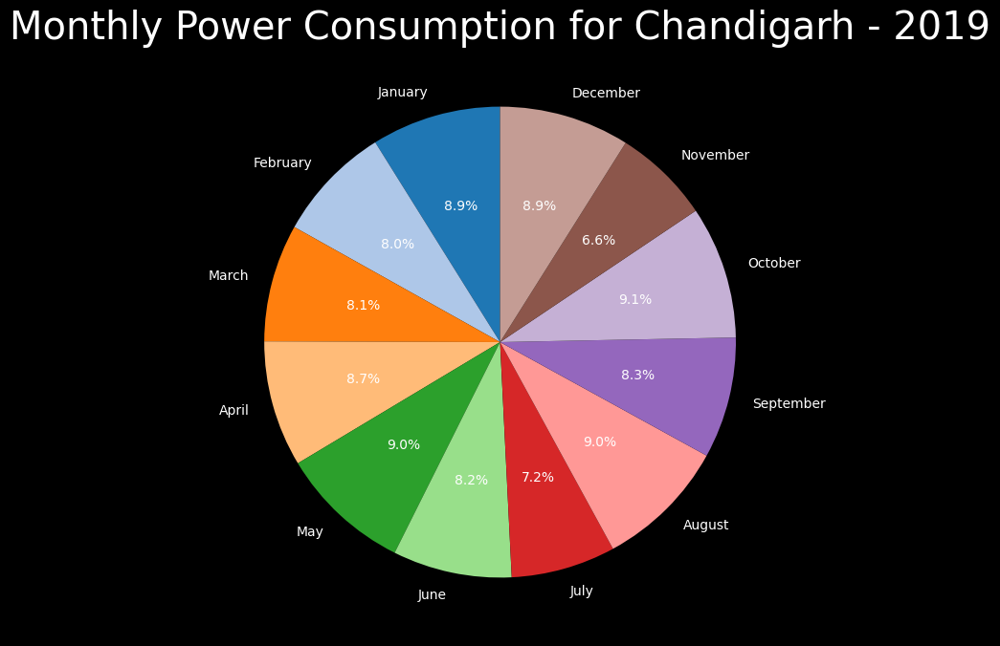

Generating pie chart for Chhattisgarh in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


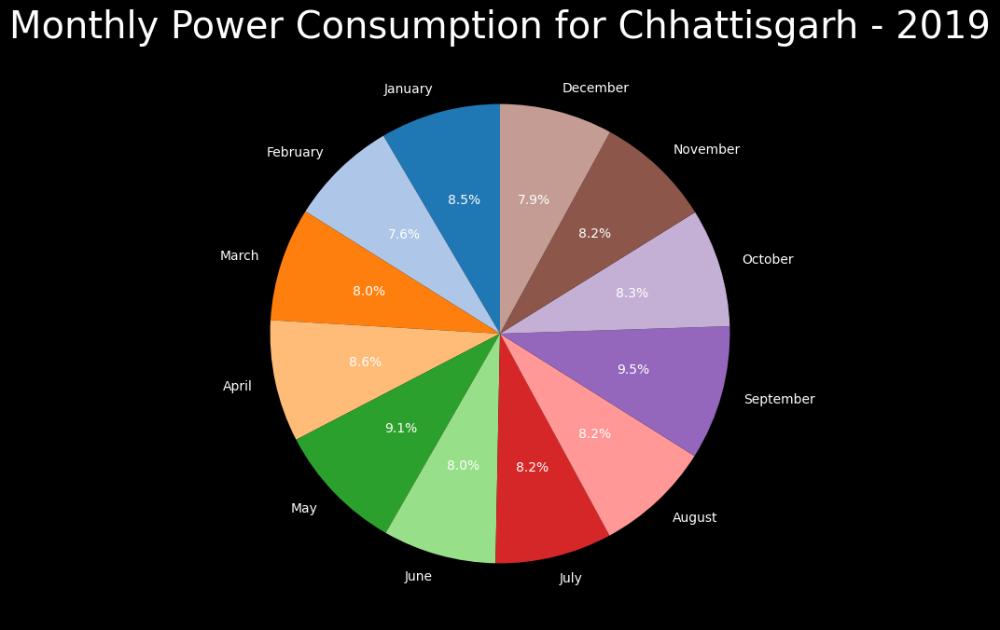

Generating pie chart for Gujarat in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


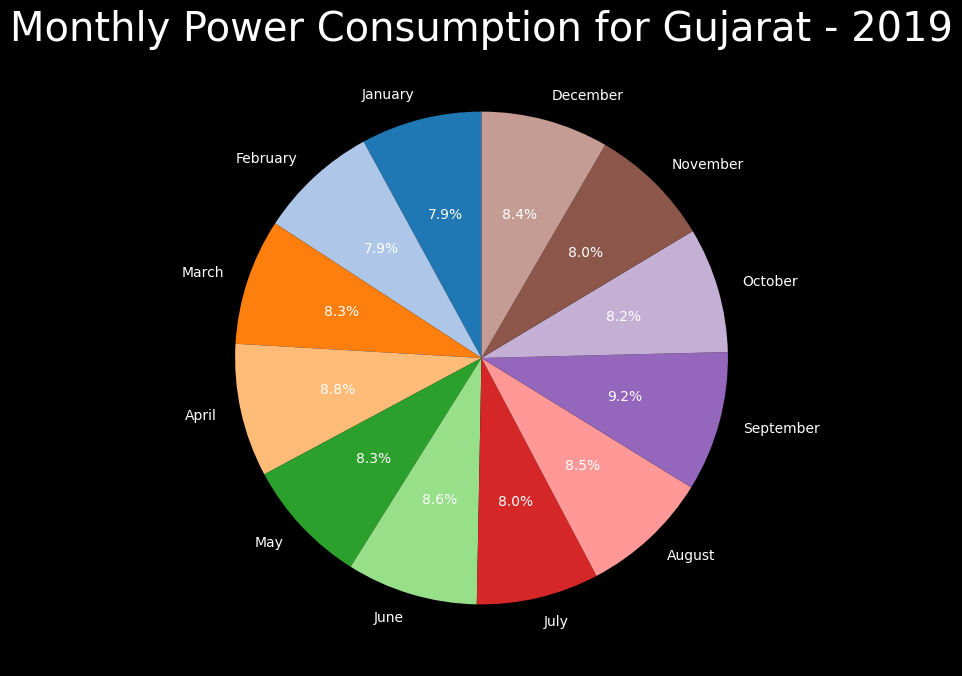

Generating pie chart for MP in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


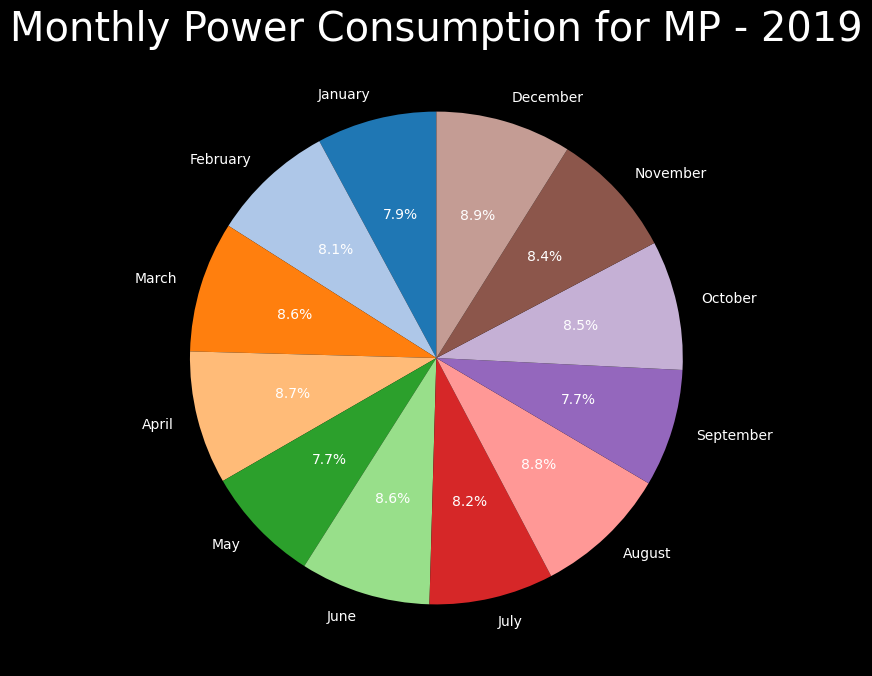

Generating pie chart for Maharashtra in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


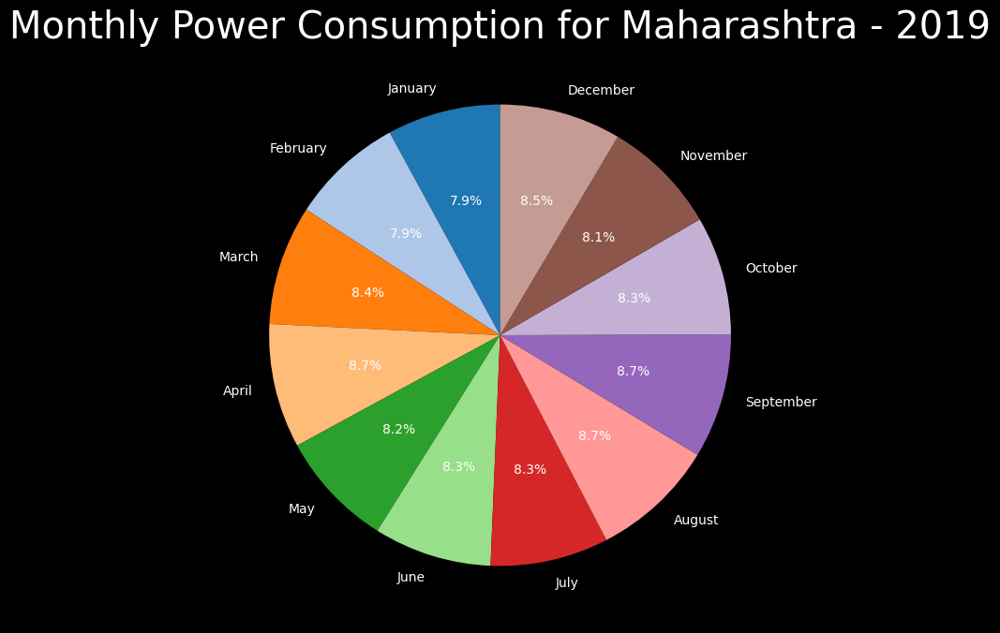

Generating pie chart for Goa in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


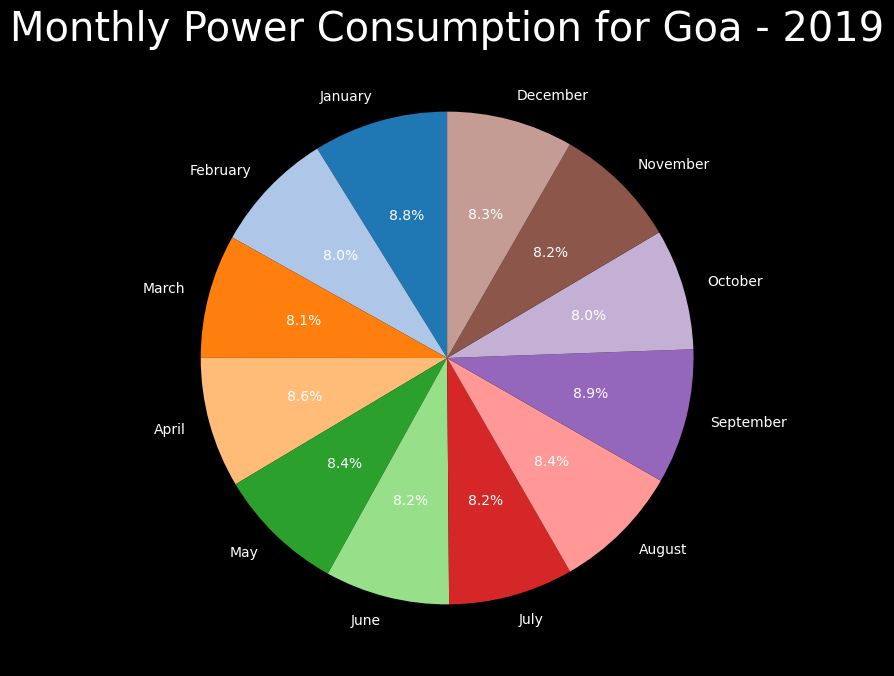

Generating pie chart for DNH in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


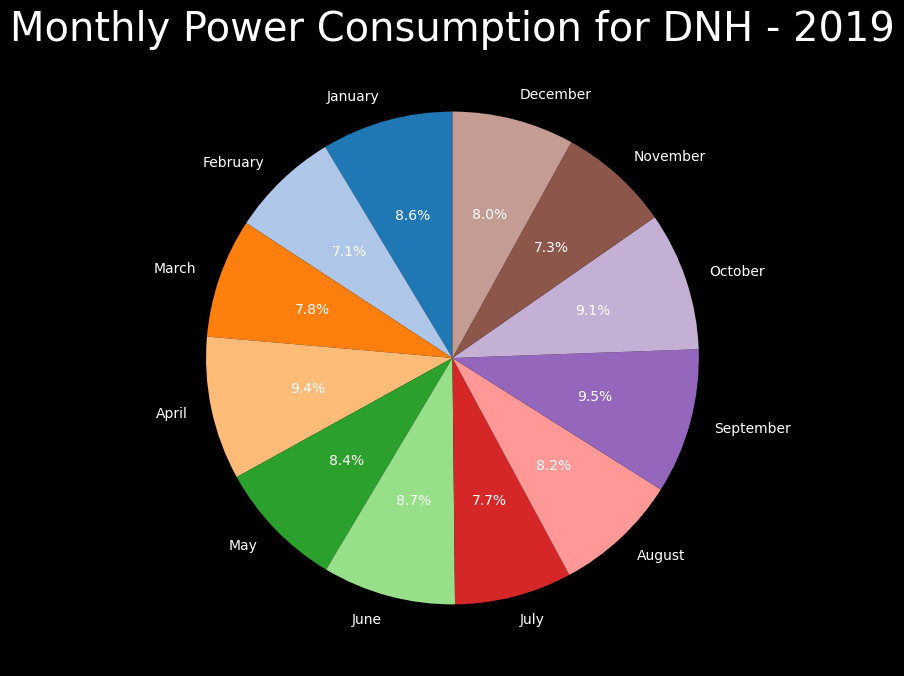

Generating pie chart for Andhra Pradesh in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


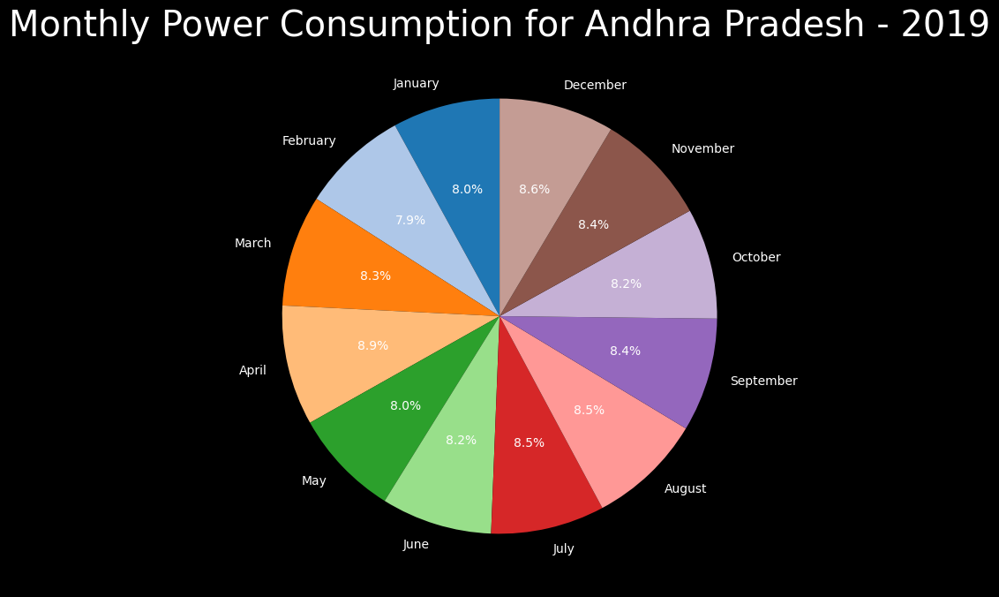

Generating pie chart for Telangana in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


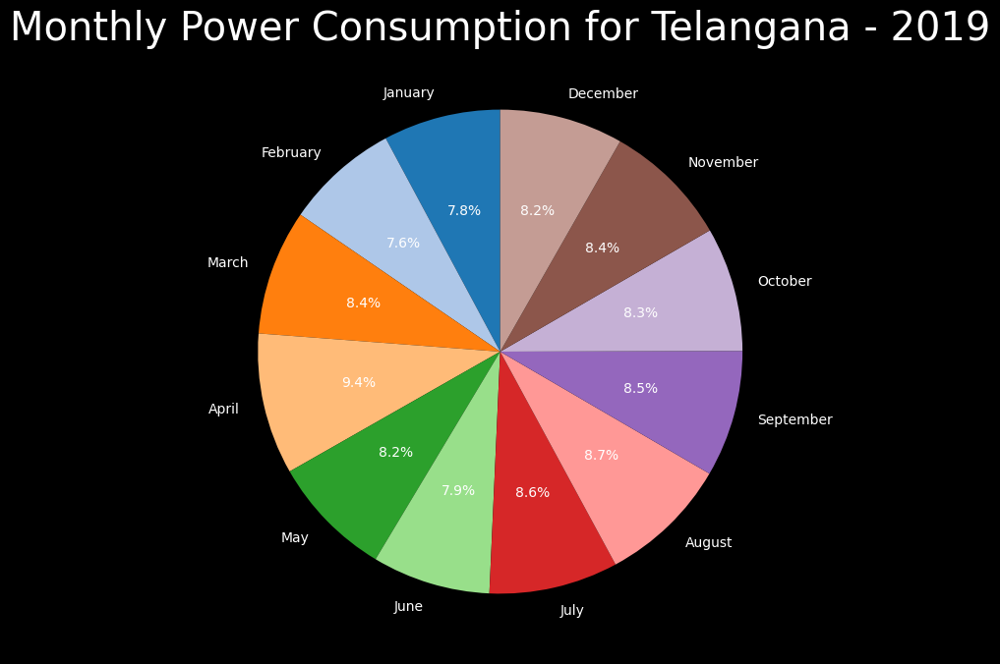

Generating pie chart for Karnataka in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


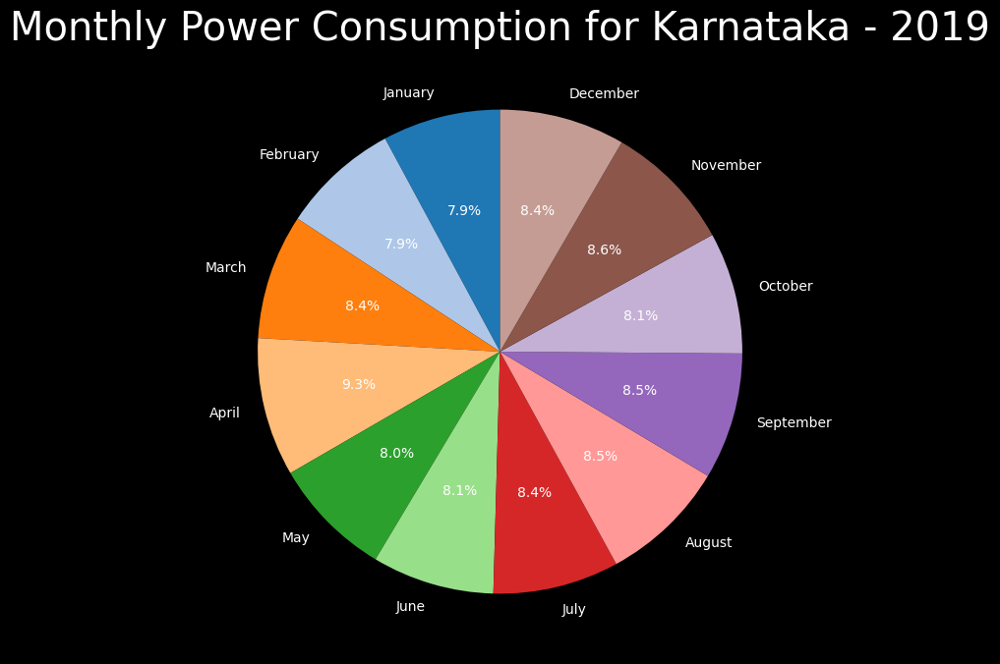

Generating pie chart for Kerala in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


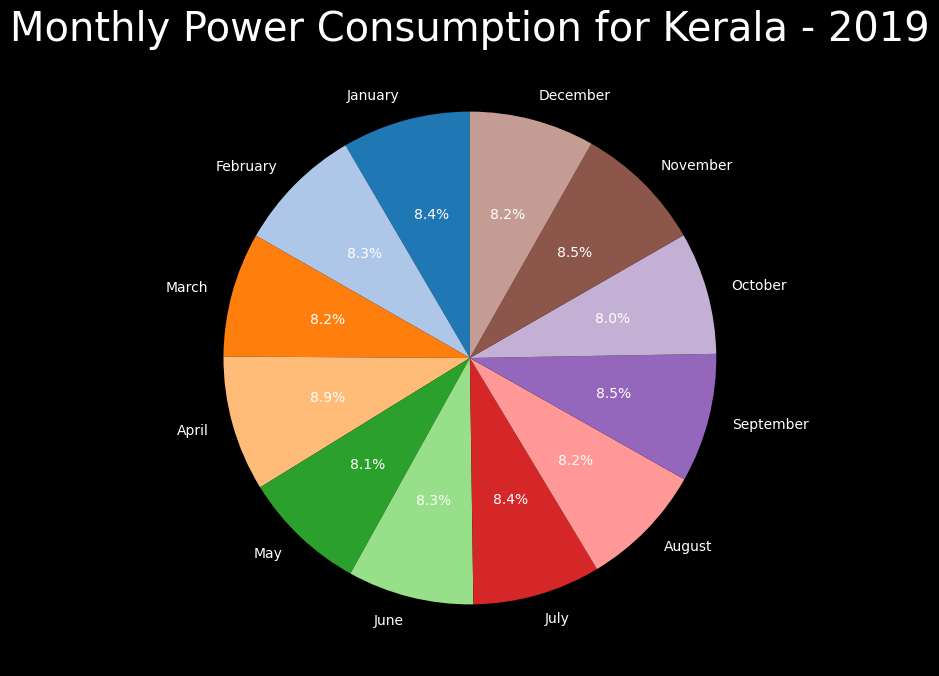

Generating pie chart for Tamil Nadu in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


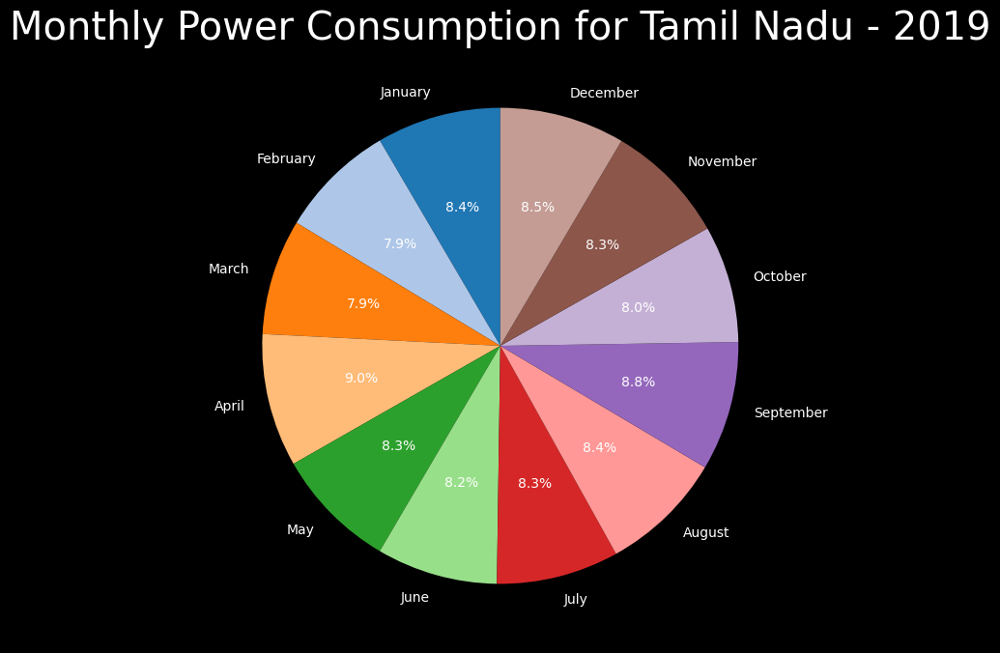

Generating pie chart for Pondy in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


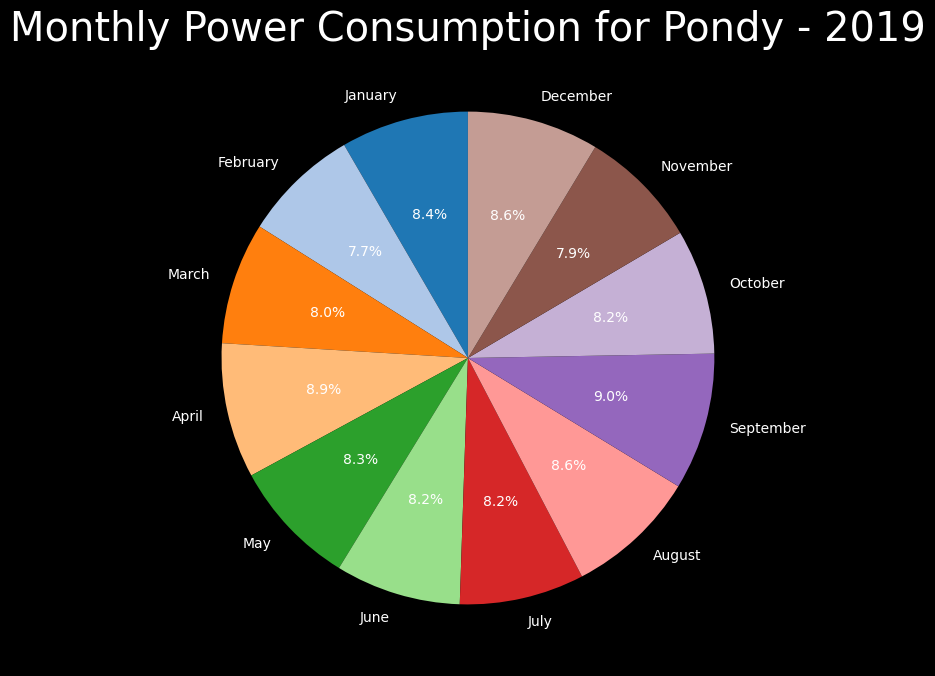

Generating pie chart for Bihar in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


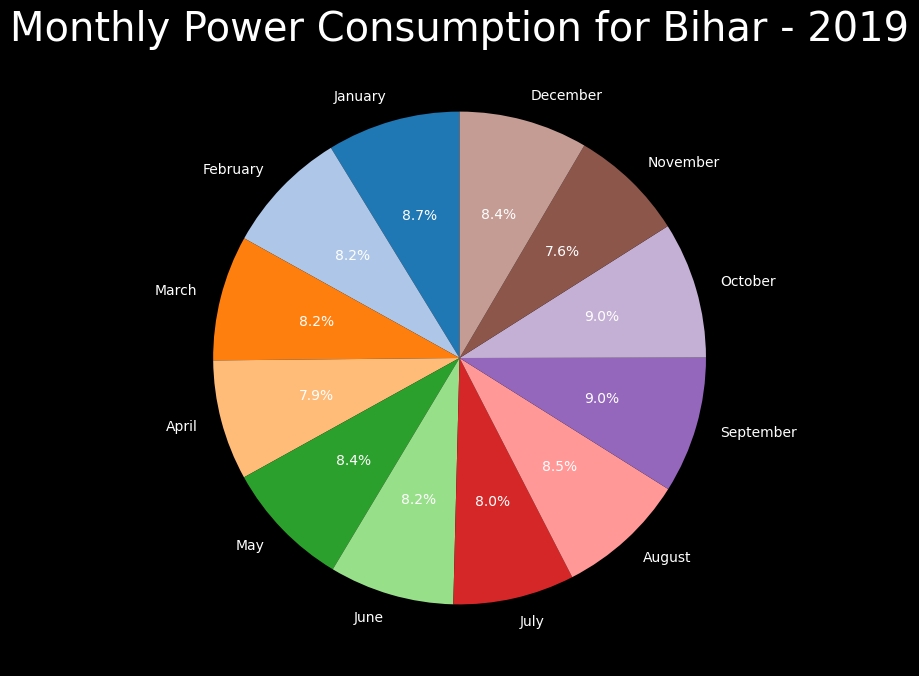

Generating pie chart for Jharkhand in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


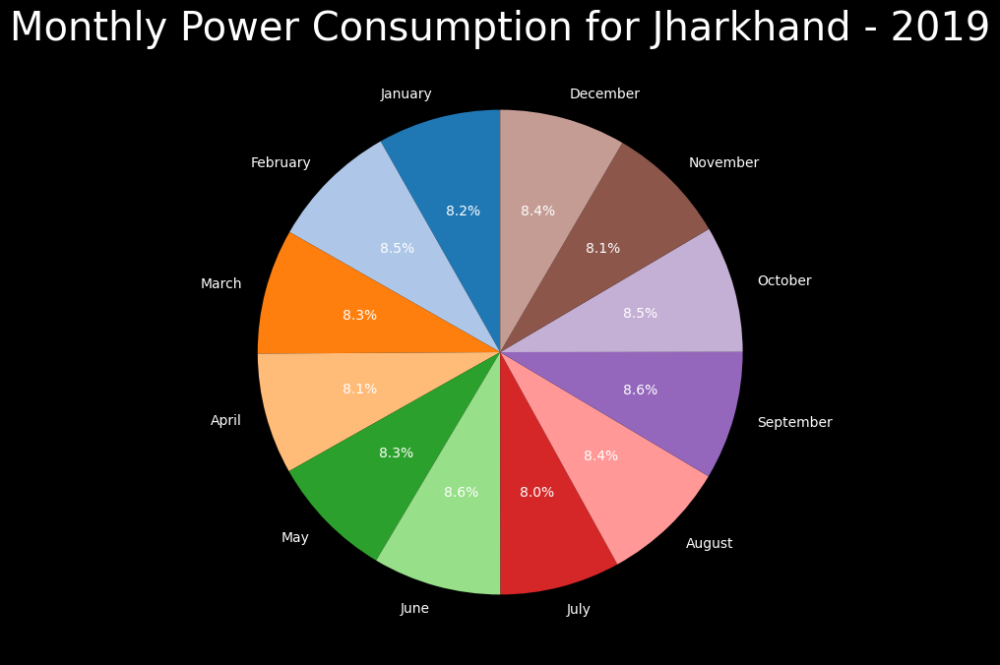

Generating pie chart for Odisha in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


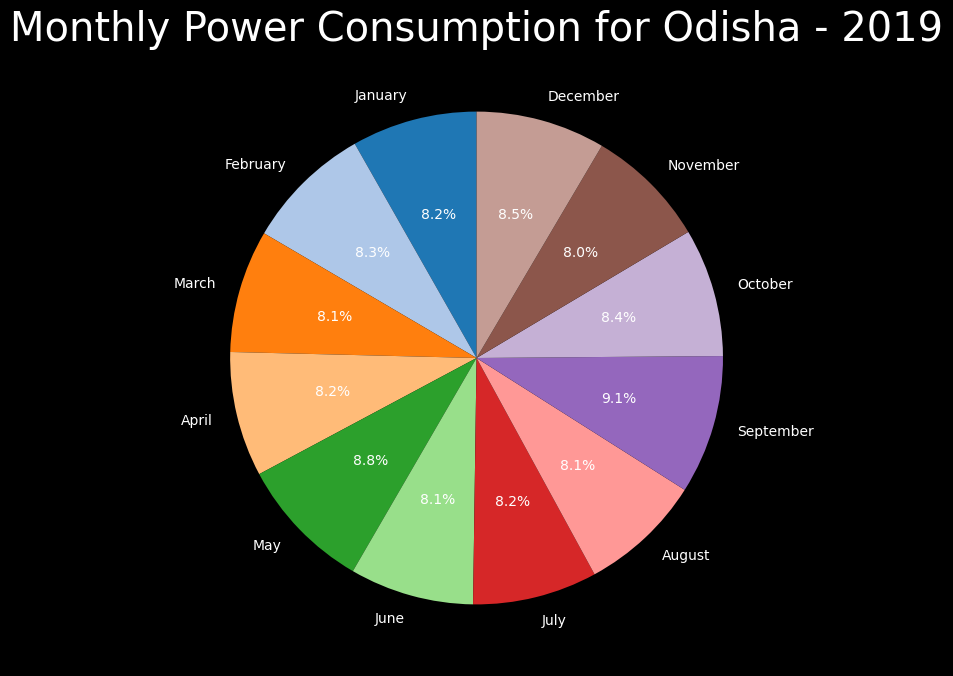

Generating pie chart for West Bengal in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


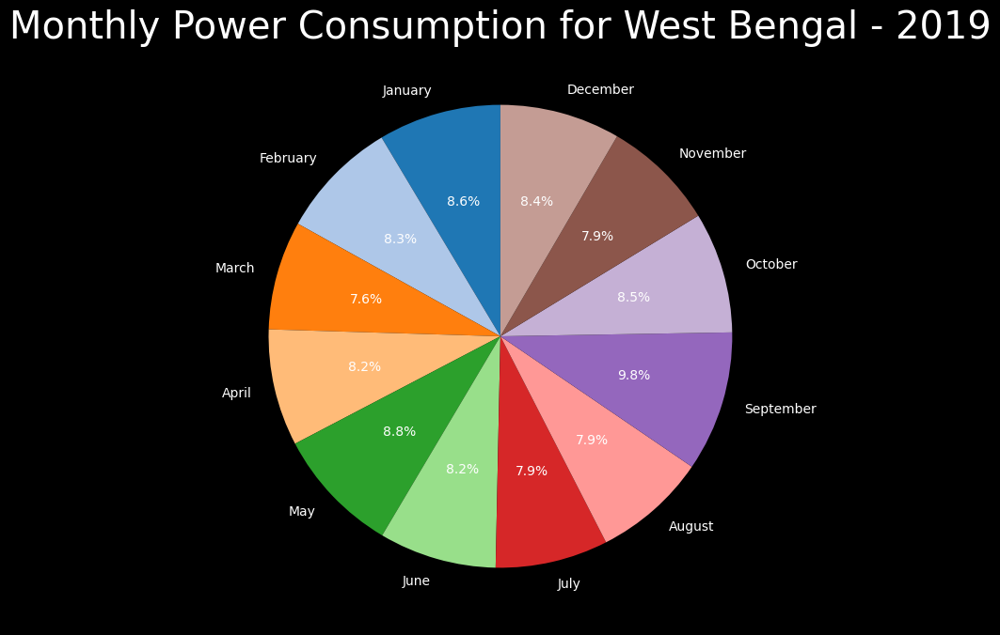

Generating pie chart for Sikkim in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


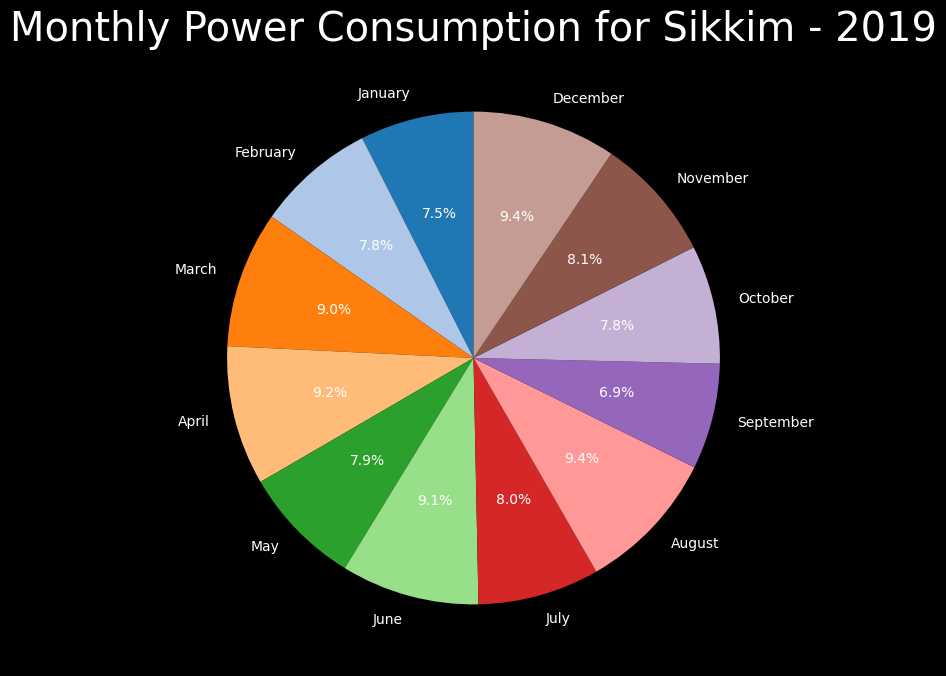

Generating pie chart for Arunachal Pradesh in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


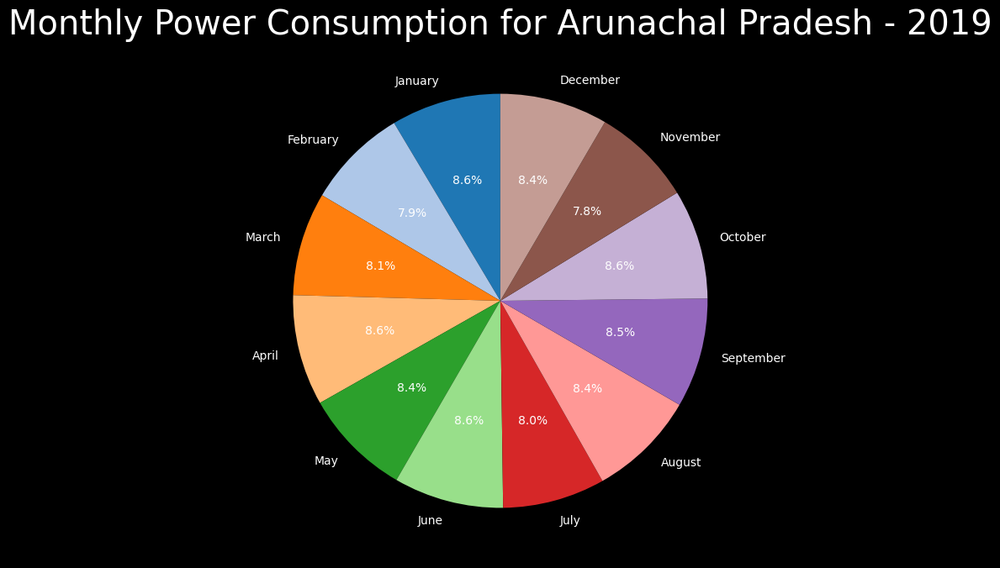

Generating pie chart for Assam in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


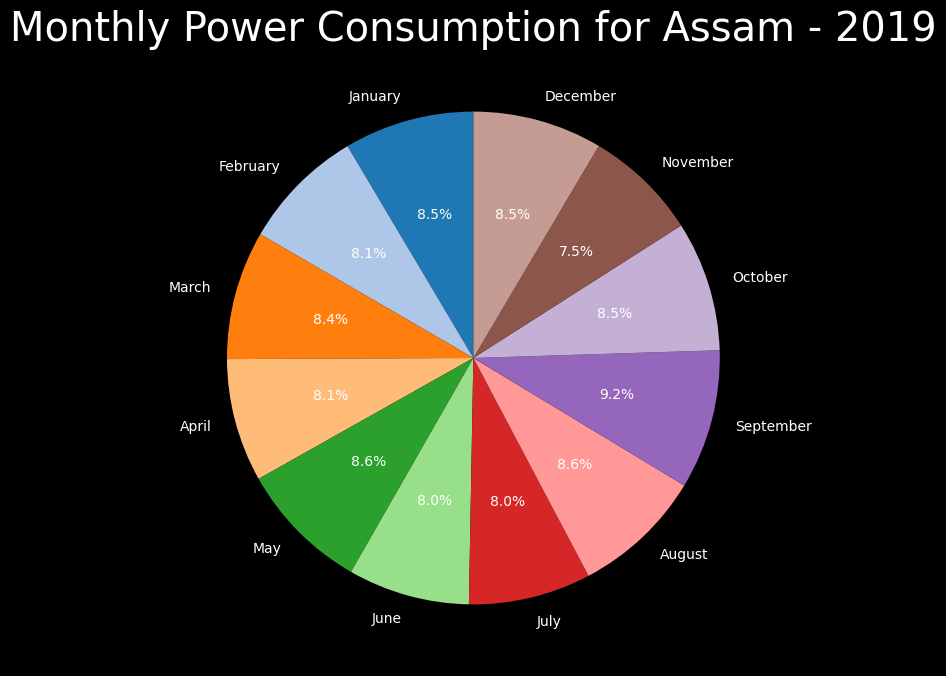

Generating pie chart for Manipur in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


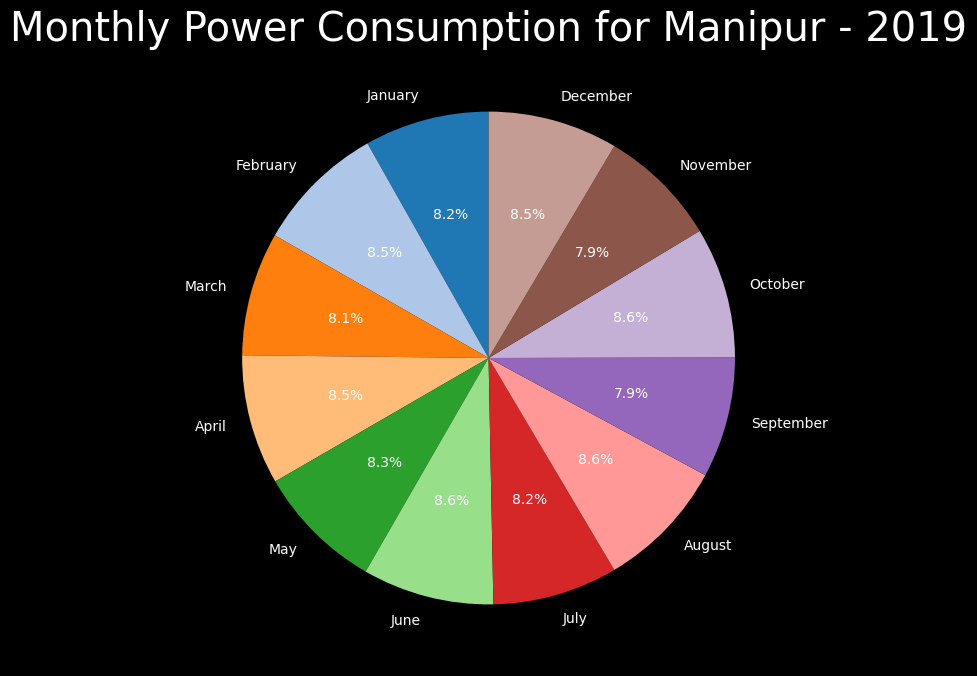

Generating pie chart for Meghalaya in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


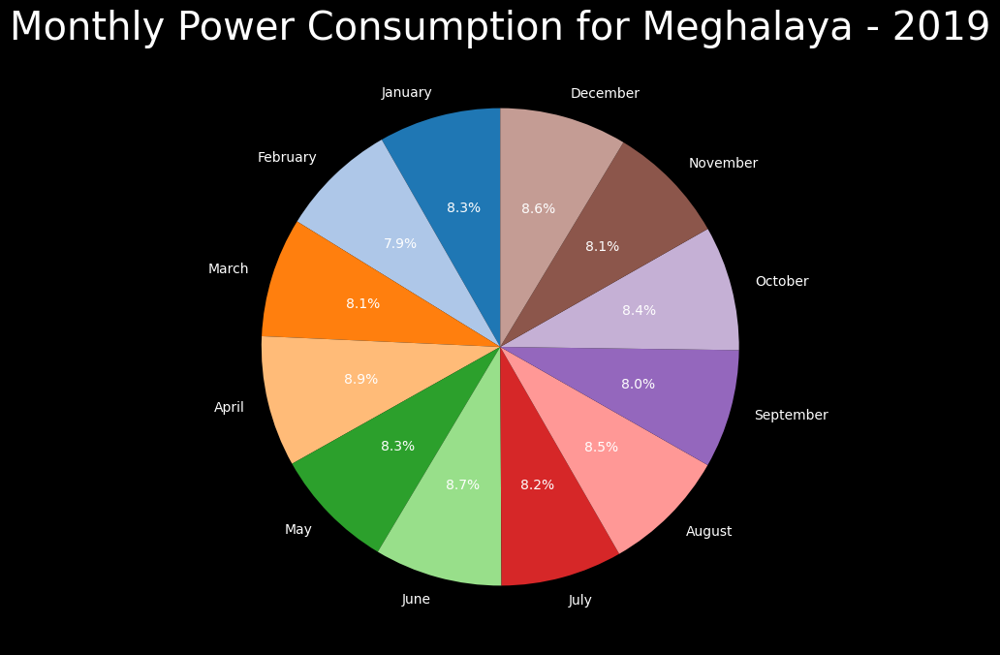

Generating pie chart for Mizoram in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


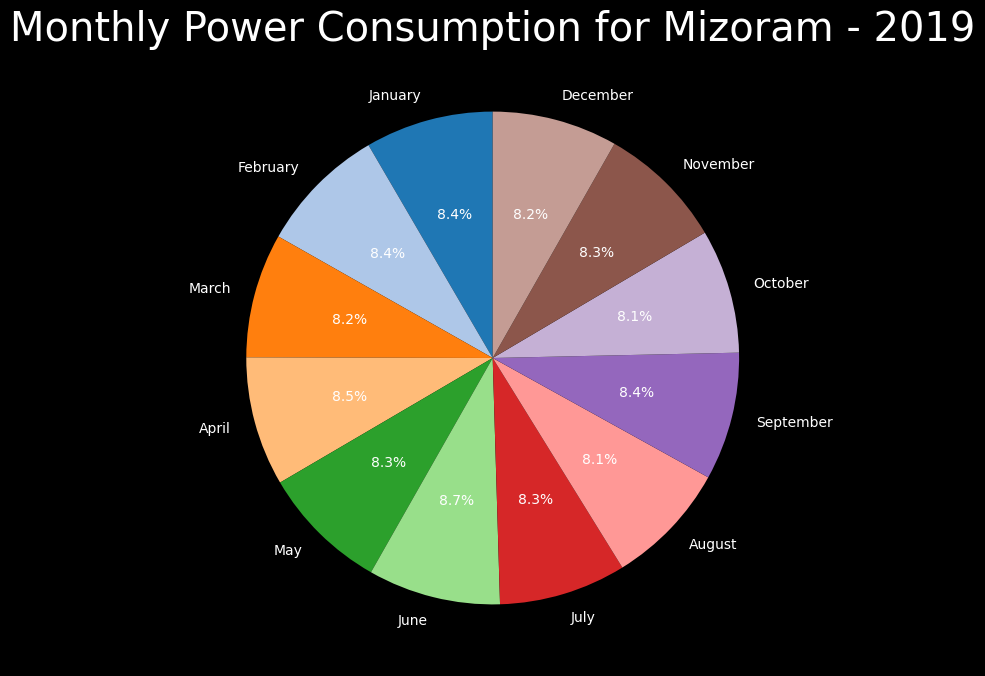

Generating pie chart for Nagaland in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


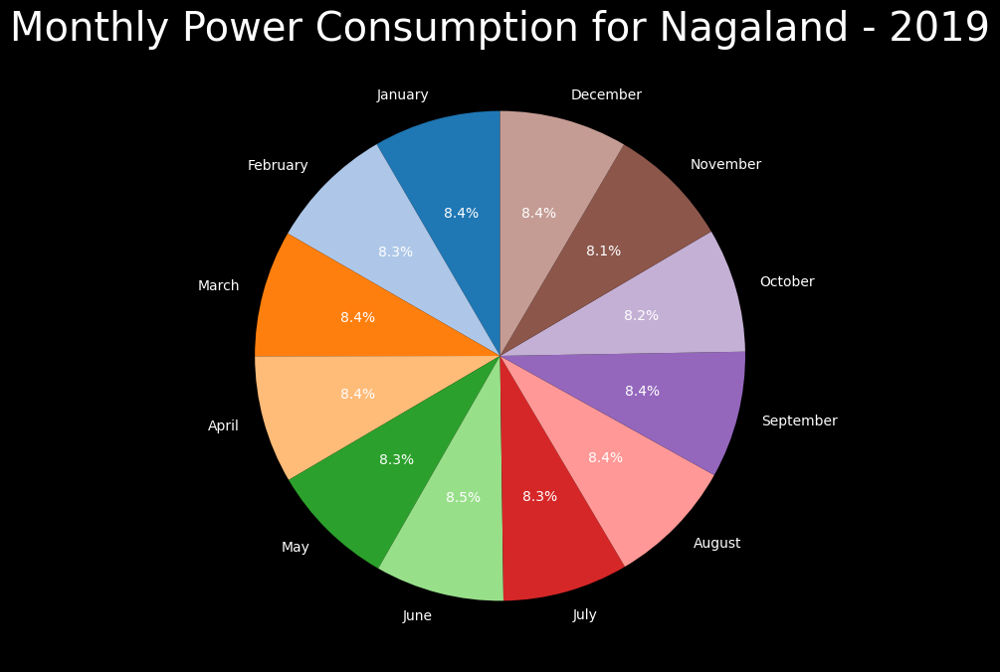

Generating pie chart for Tripura in 2019...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


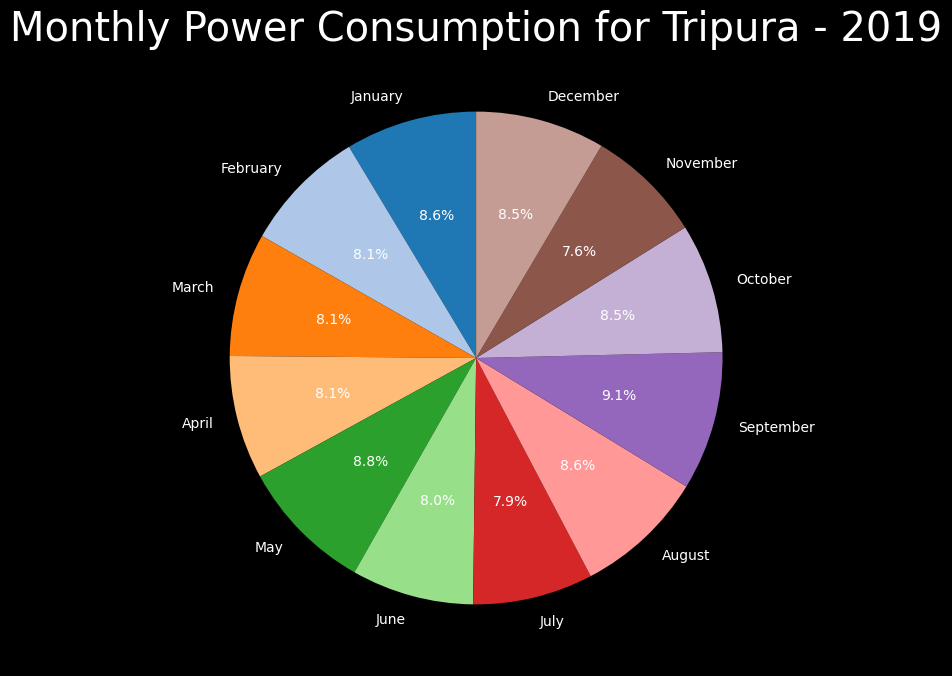

Generating pie chart for Punjab in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


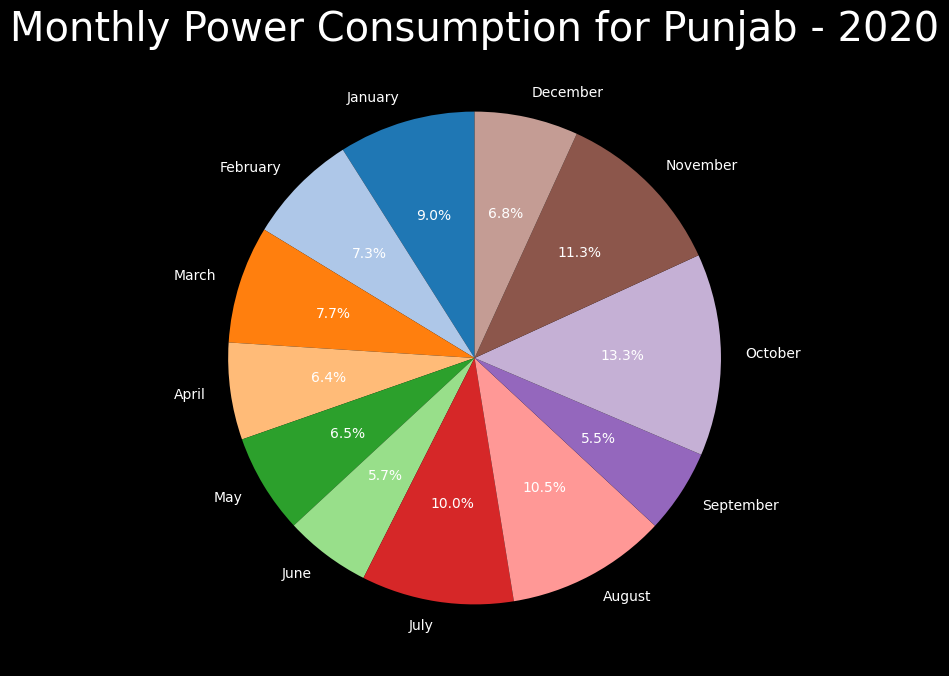

Generating pie chart for Haryana in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


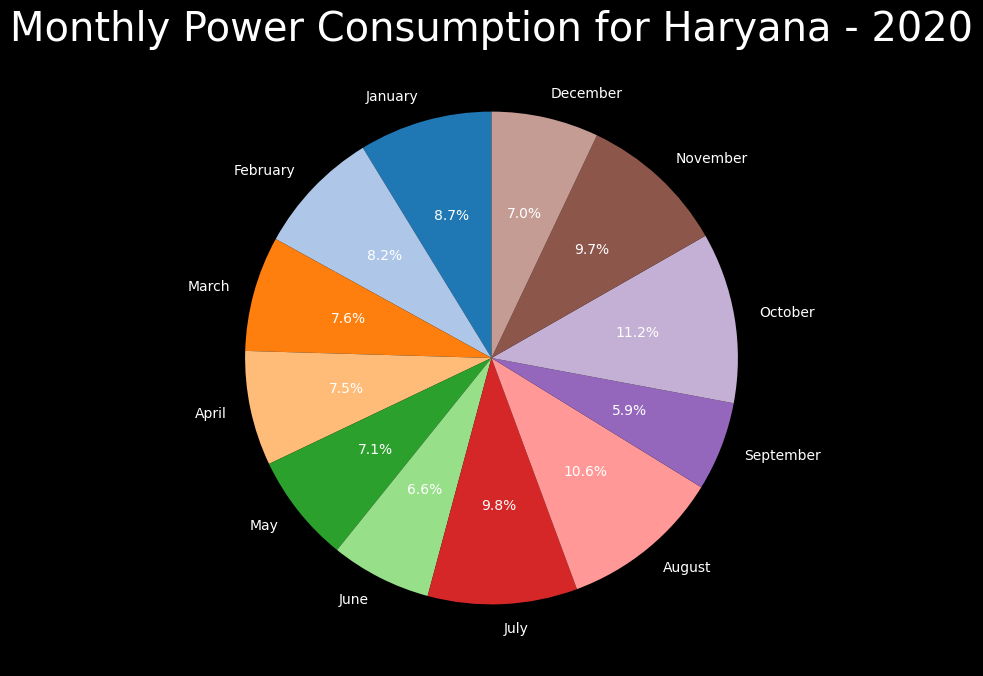

Generating pie chart for Rajasthan in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


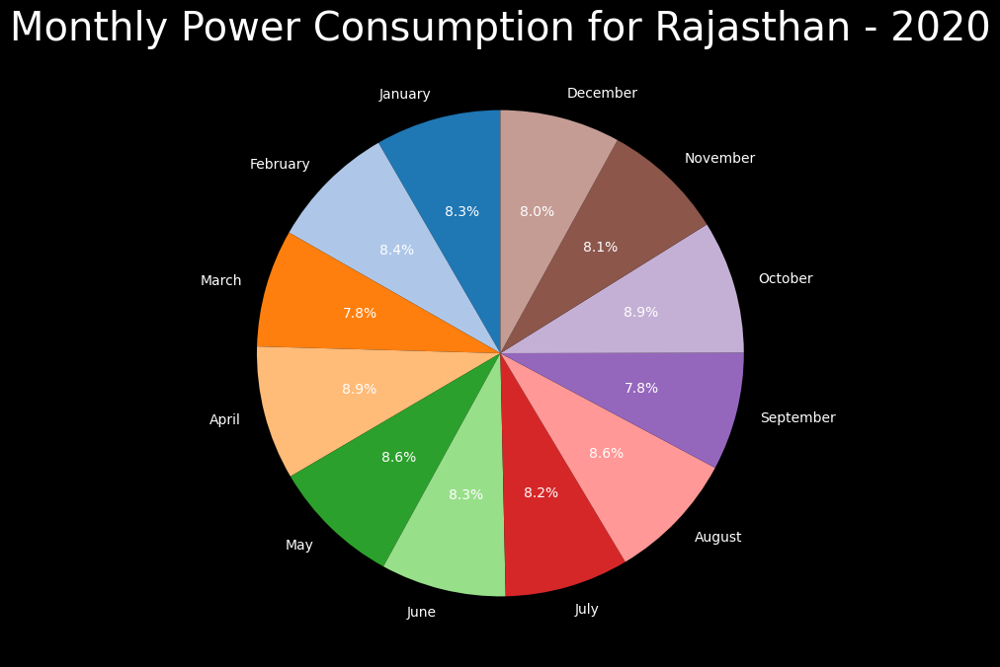

Generating pie chart for Delhi in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


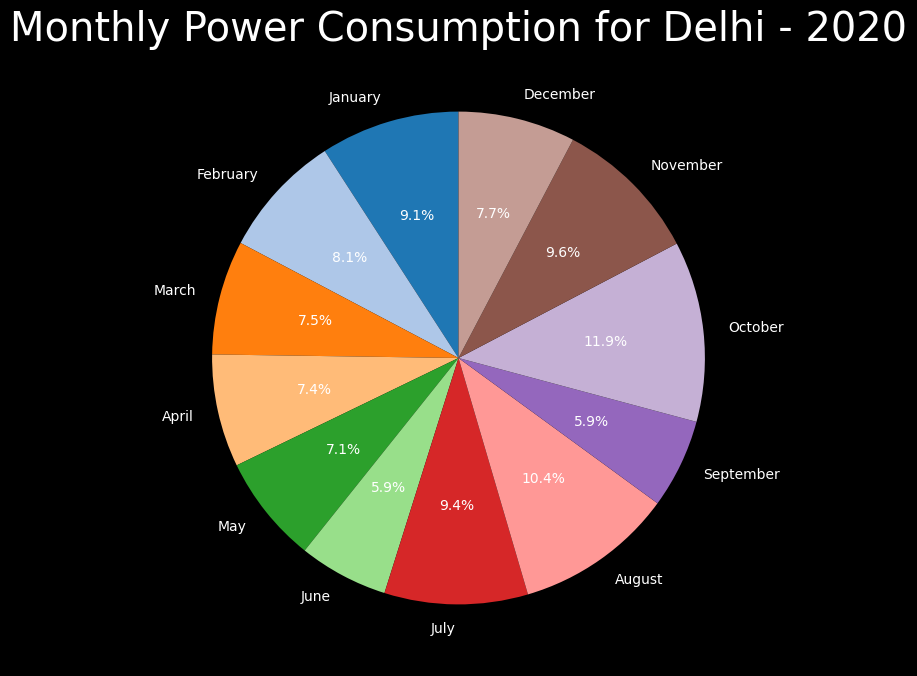

Generating pie chart for UP in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


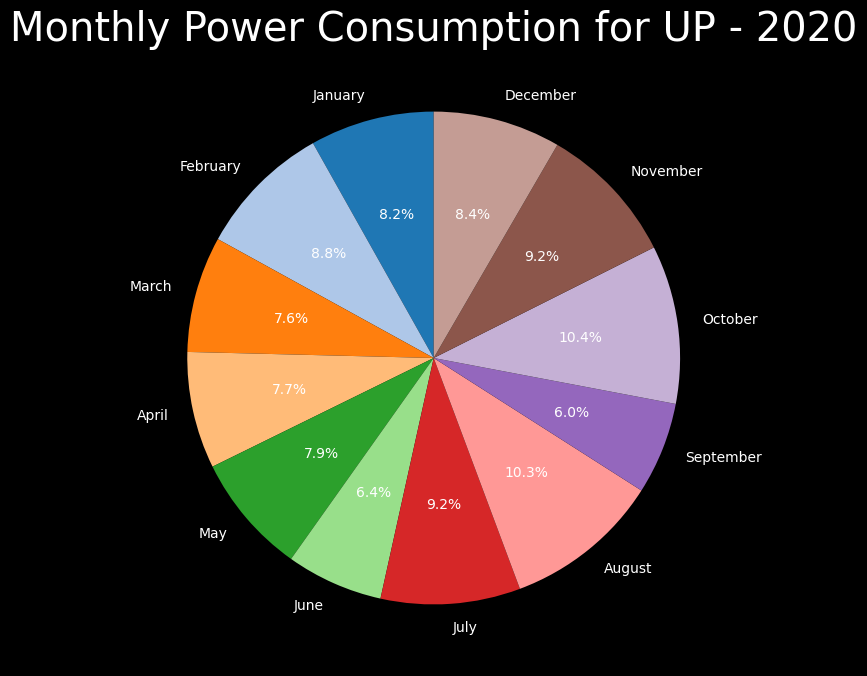

Generating pie chart for Uttarakhand in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


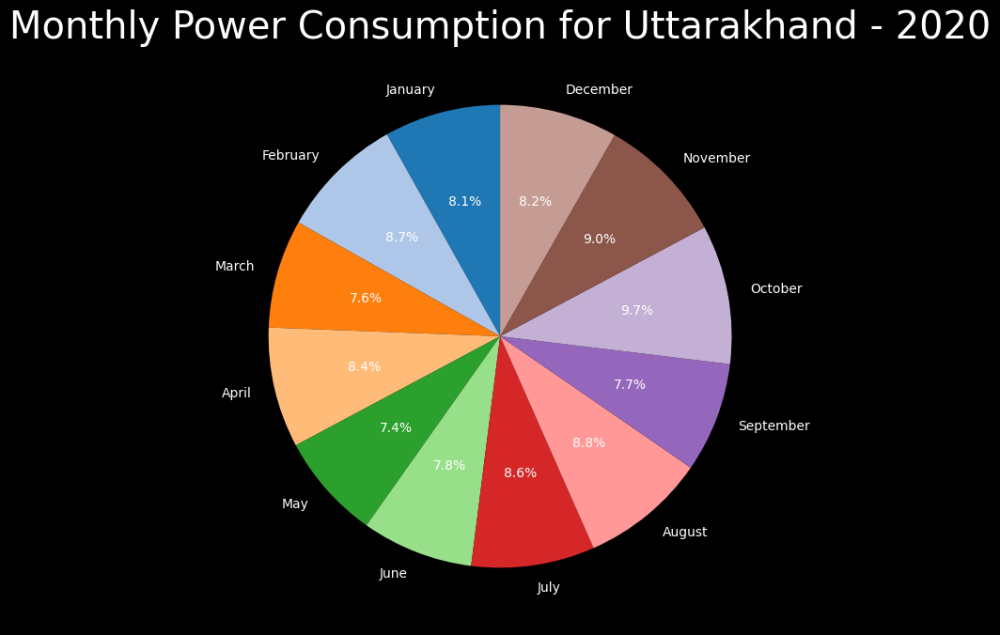

Generating pie chart for HP in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


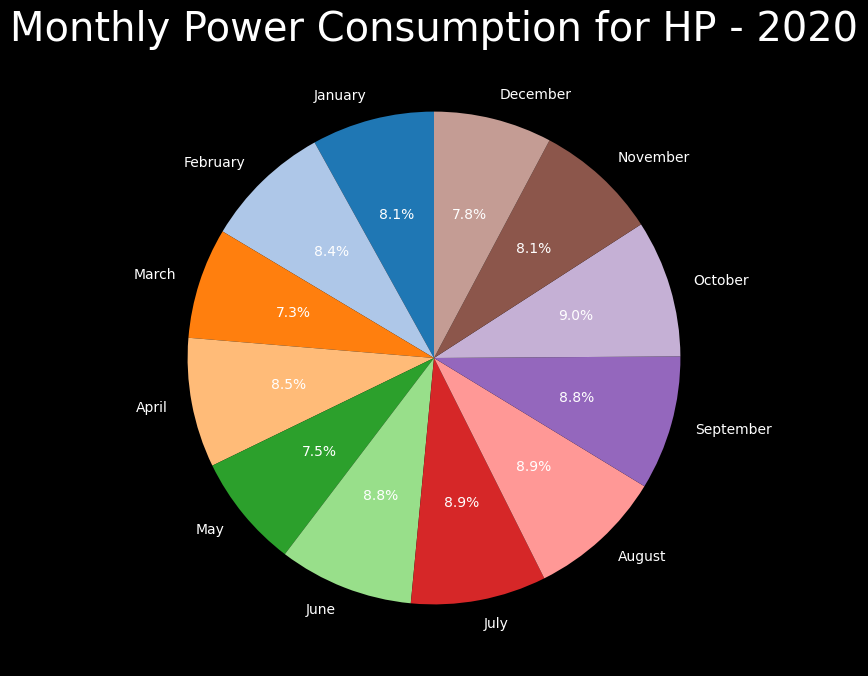

Generating pie chart for J&K in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


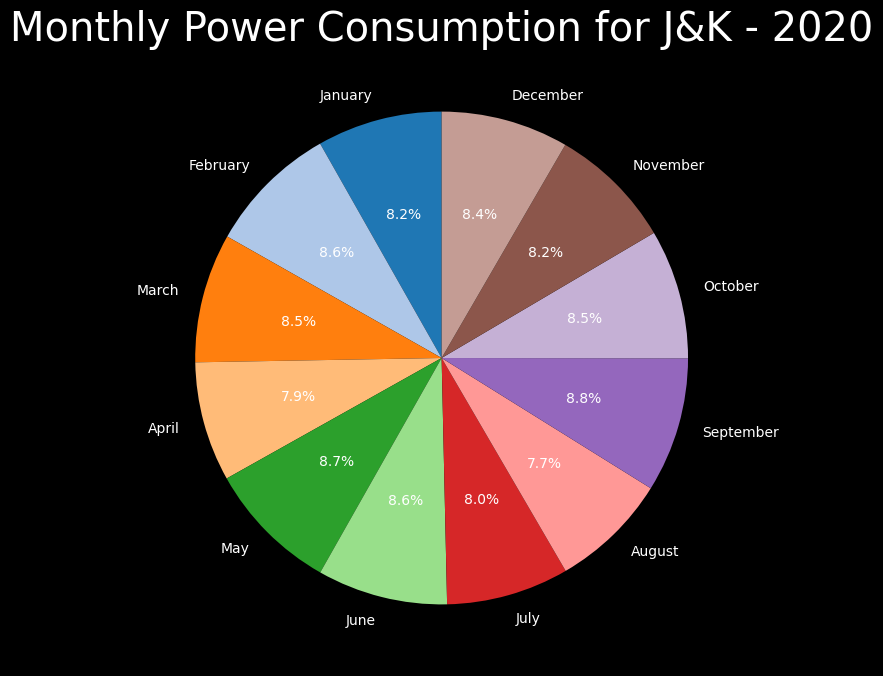

Generating pie chart for Chandigarh in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


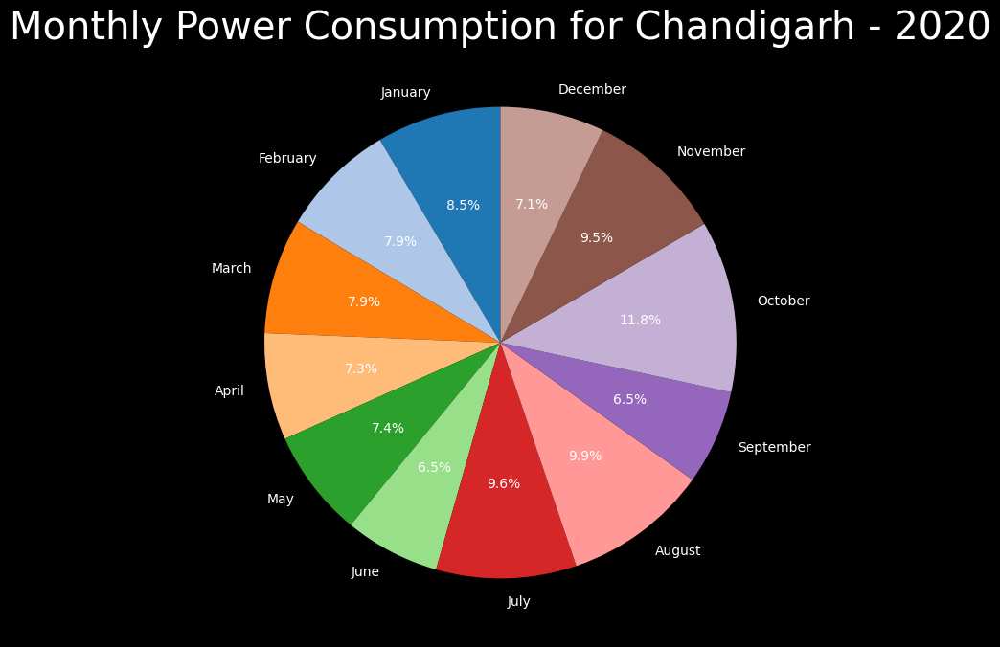

Generating pie chart for Chhattisgarh in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


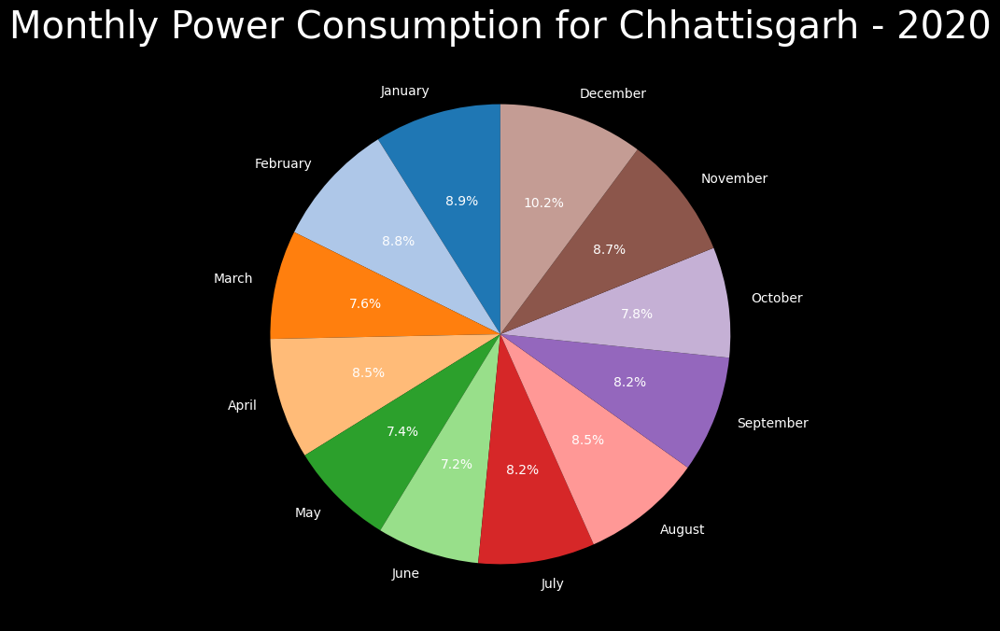

Generating pie chart for Gujarat in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


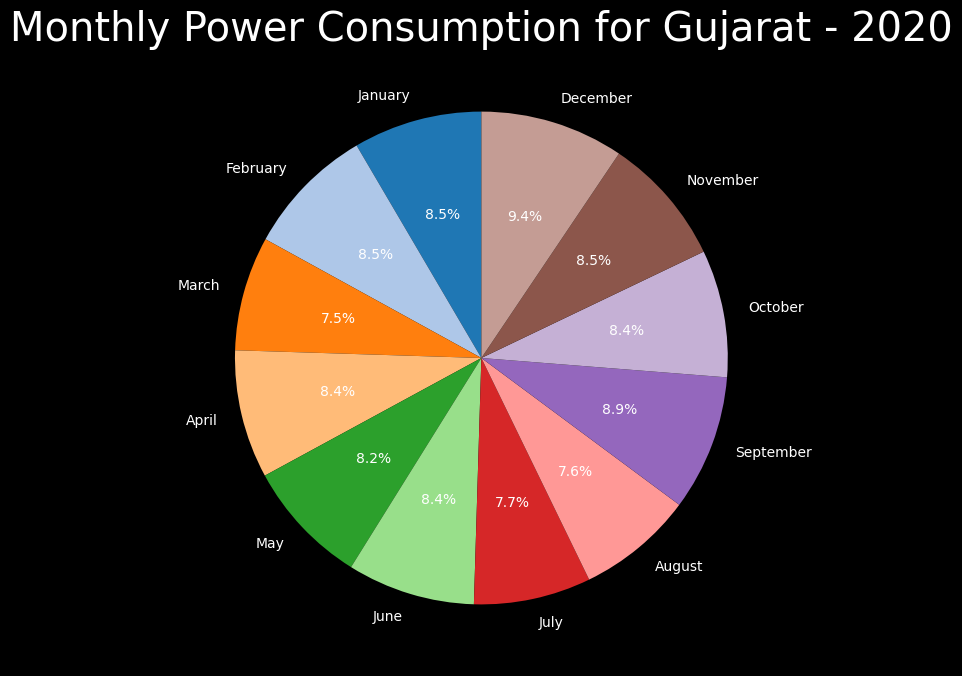

Generating pie chart for MP in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


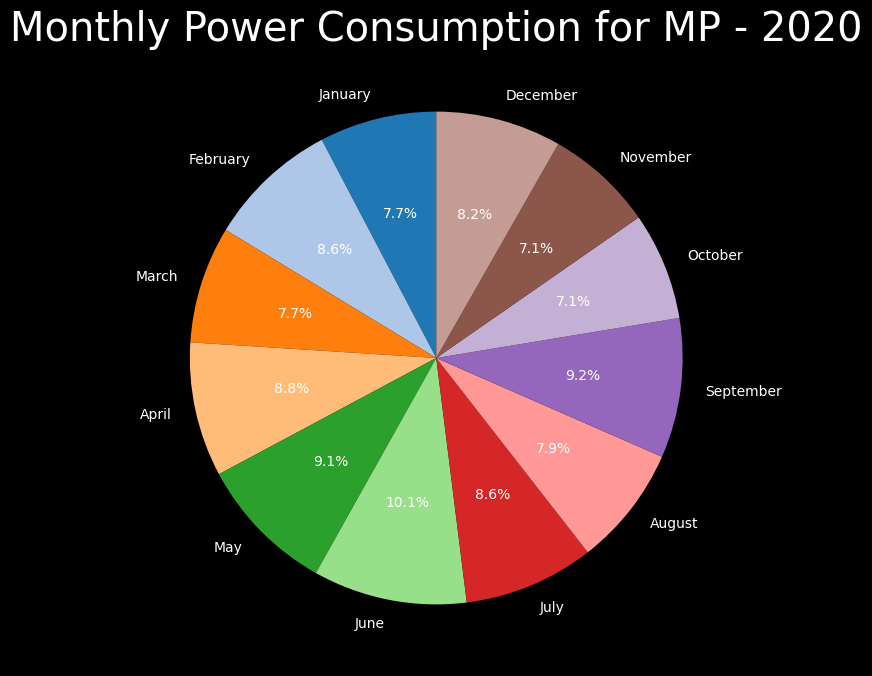

Generating pie chart for Maharashtra in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


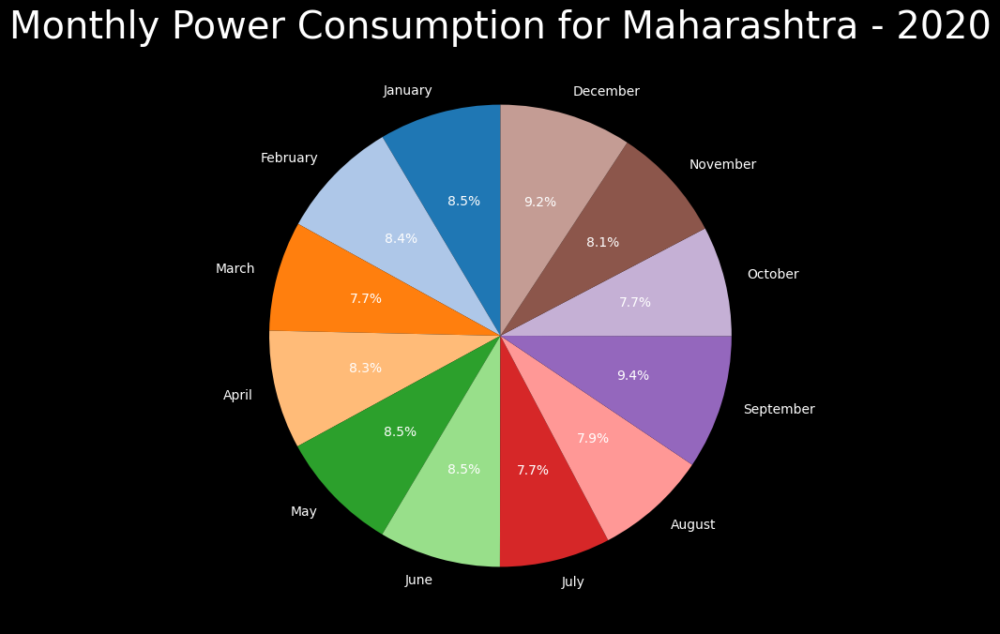

Generating pie chart for Goa in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


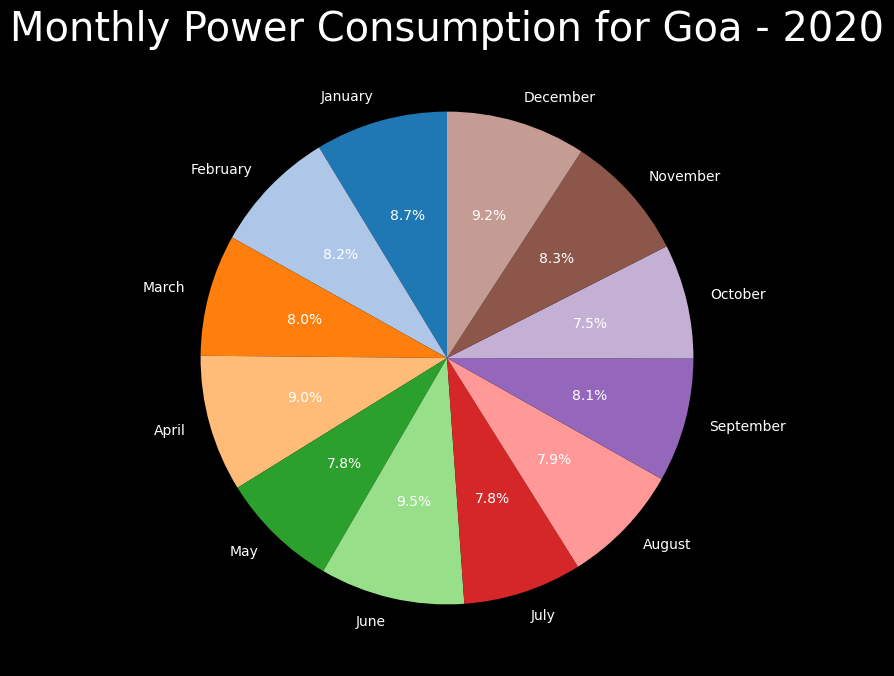

Generating pie chart for DNH in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


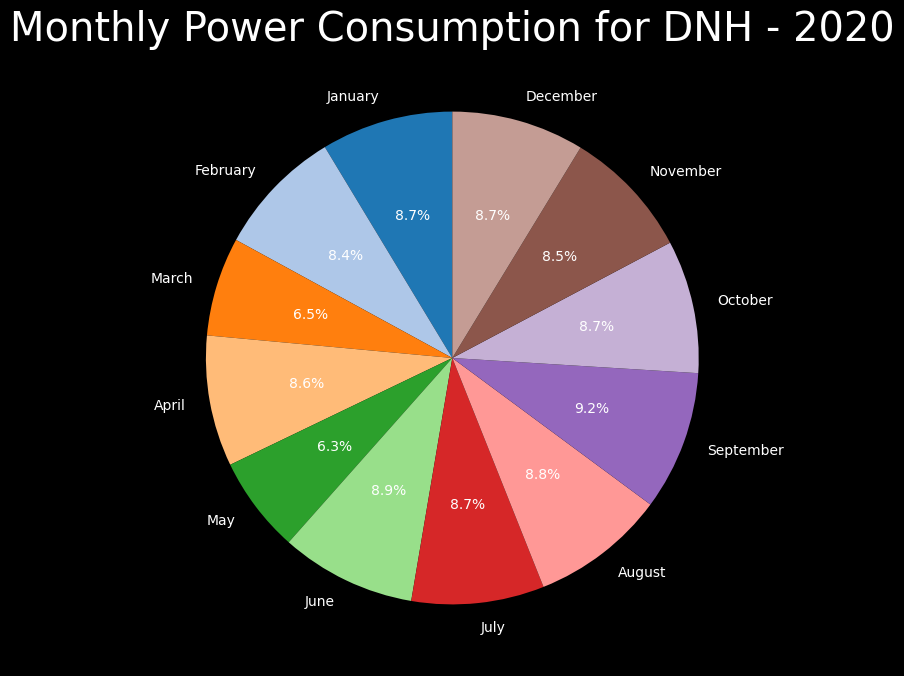

Generating pie chart for Andhra Pradesh in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


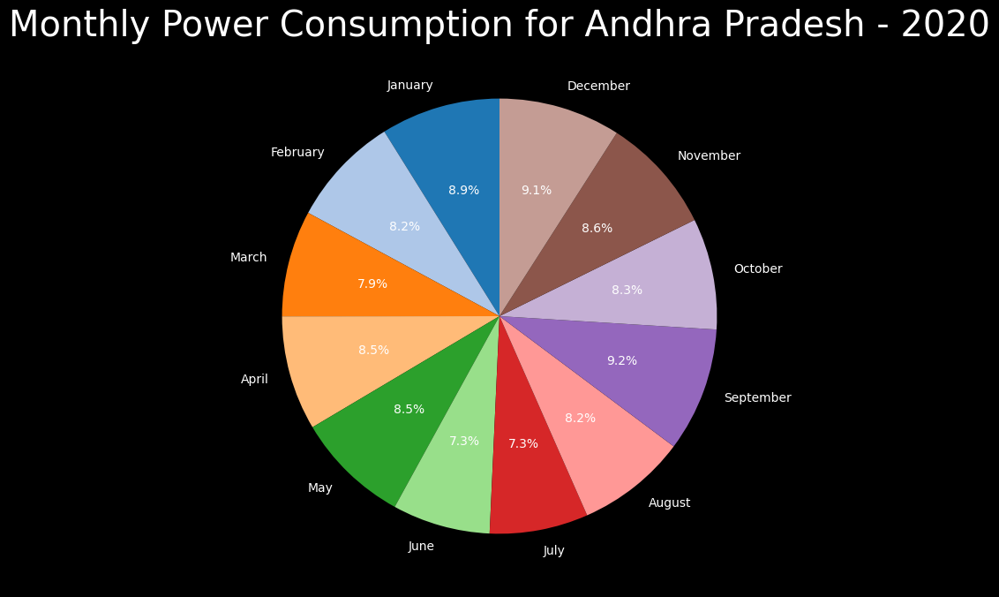

Generating pie chart for Telangana in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


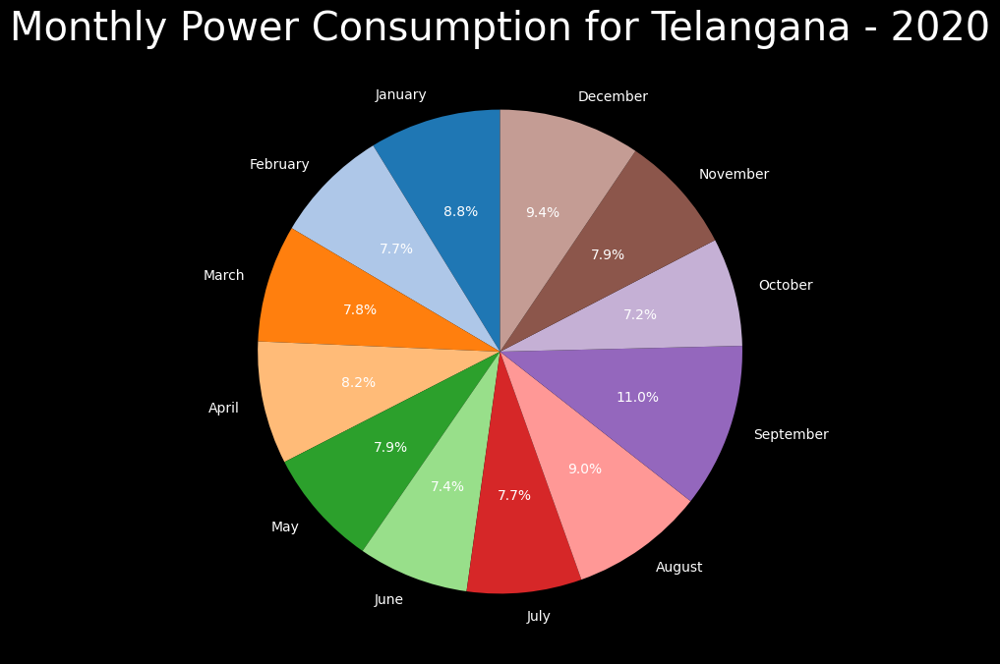

Generating pie chart for Karnataka in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


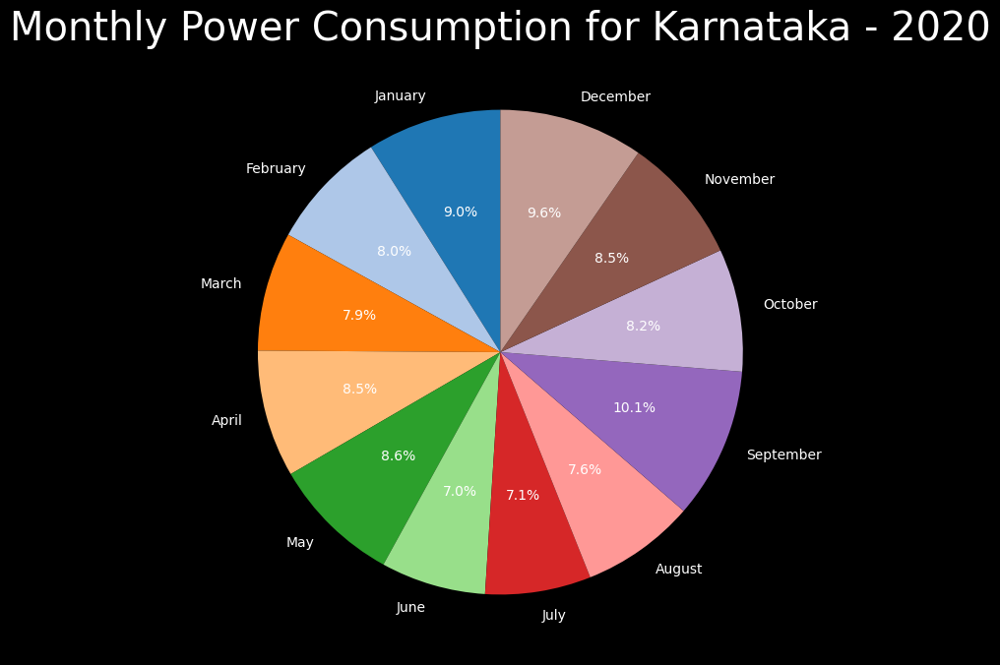

Generating pie chart for Kerala in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


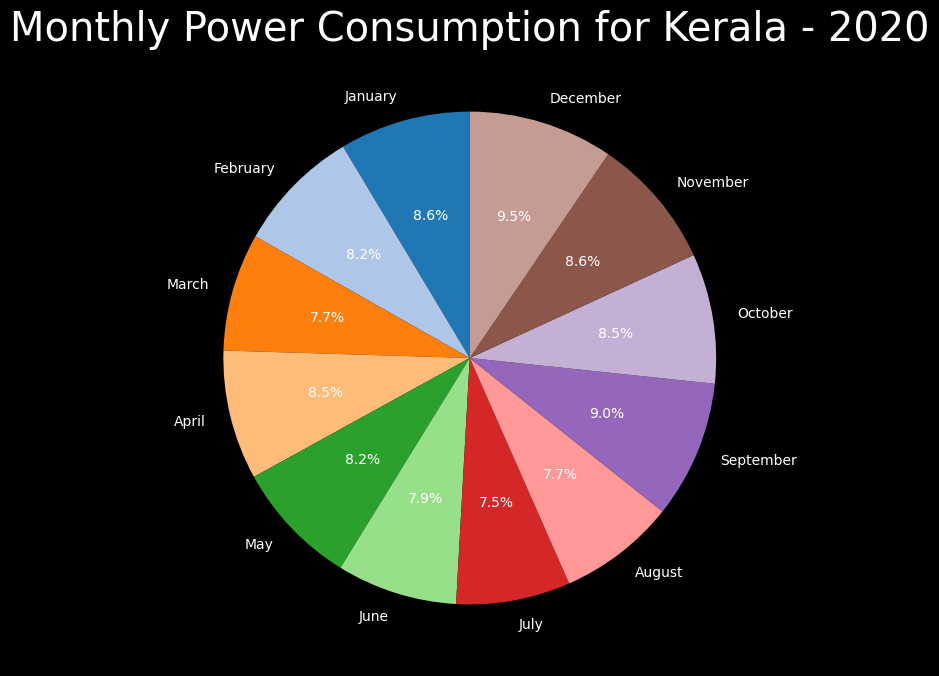

Generating pie chart for Tamil Nadu in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


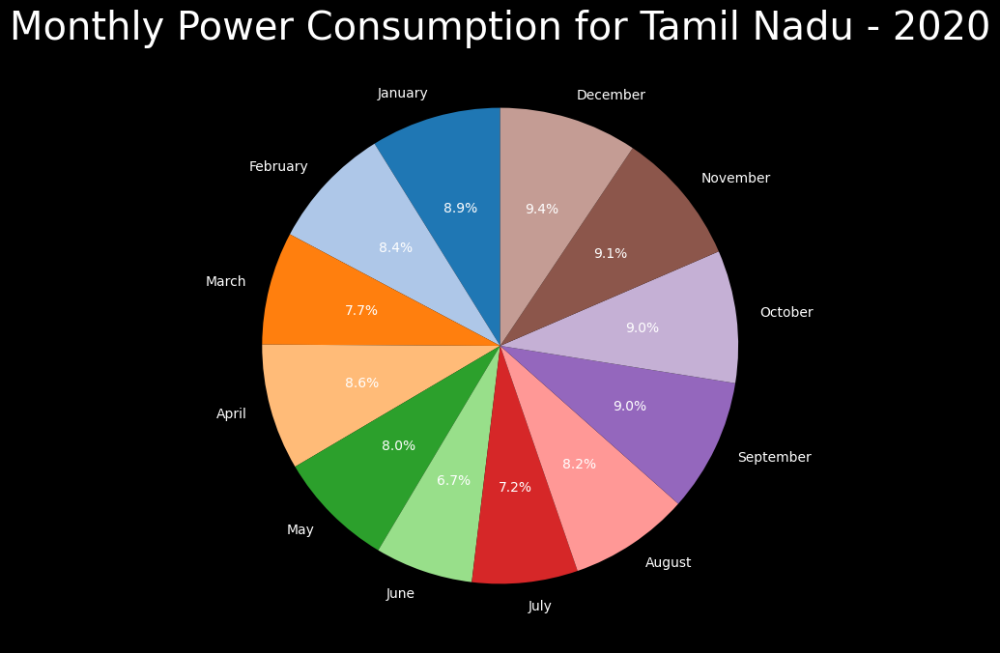

Generating pie chart for Pondy in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


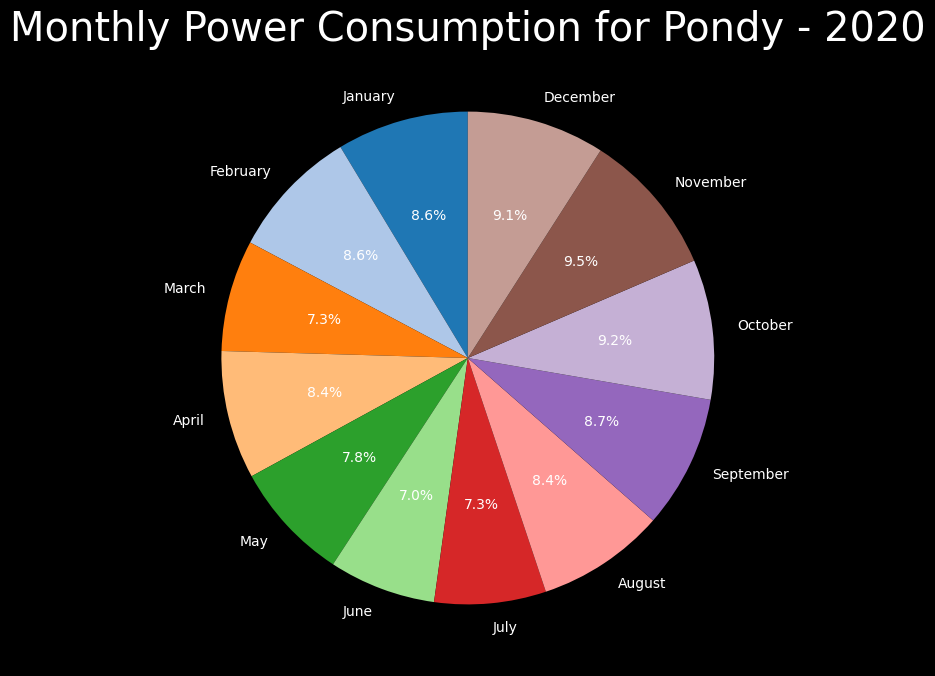

Generating pie chart for Bihar in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


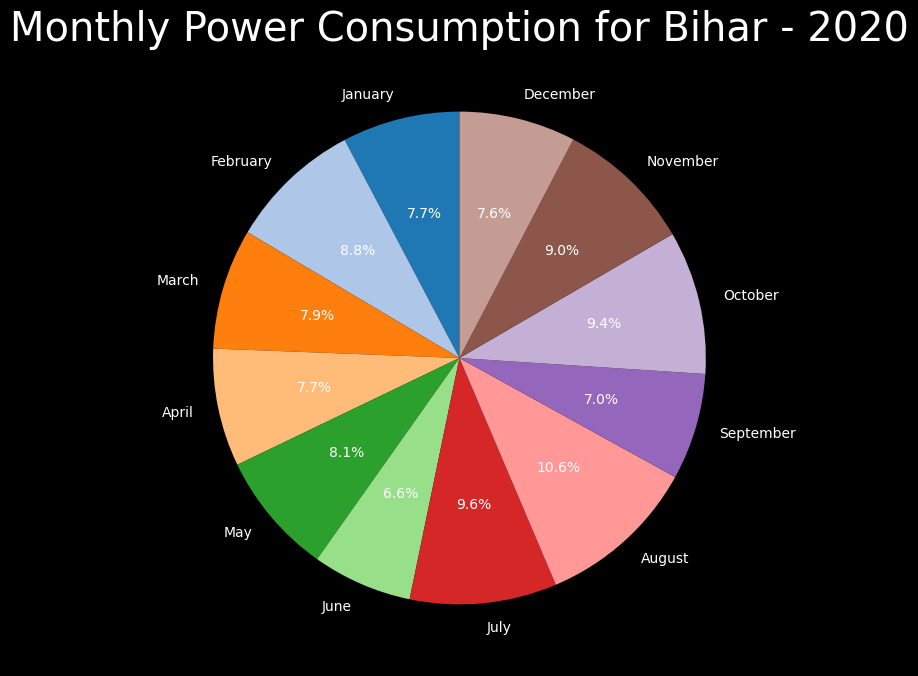

Generating pie chart for Jharkhand in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


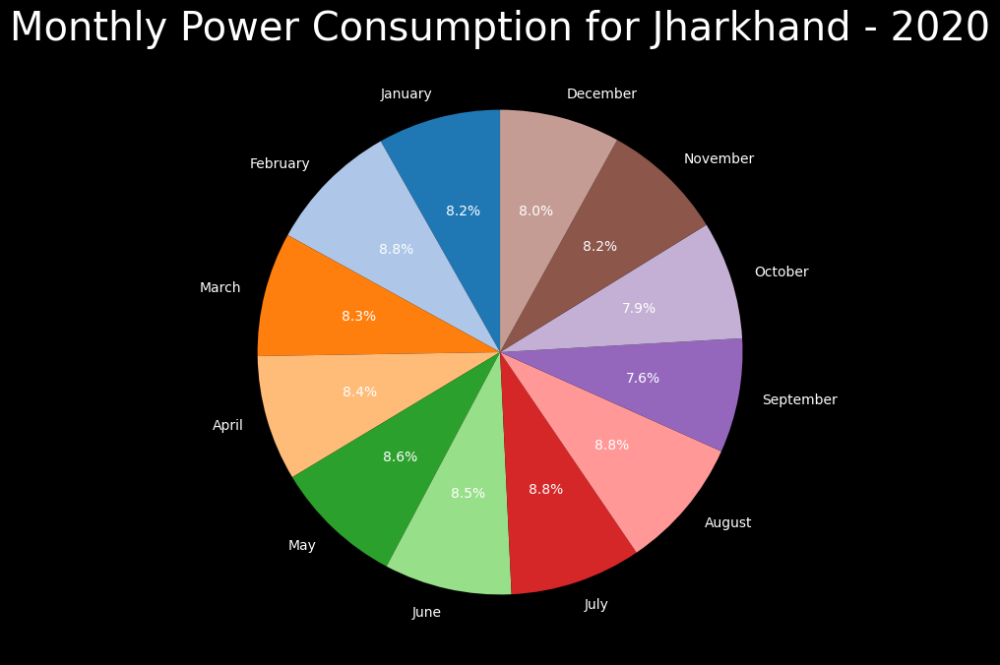

Generating pie chart for Odisha in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


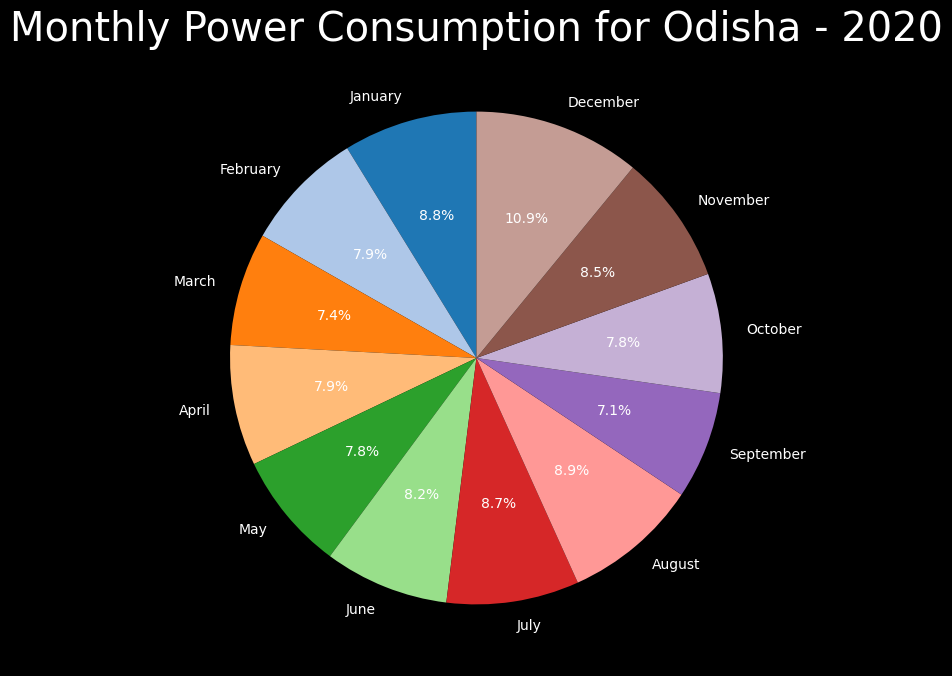

Generating pie chart for West Bengal in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


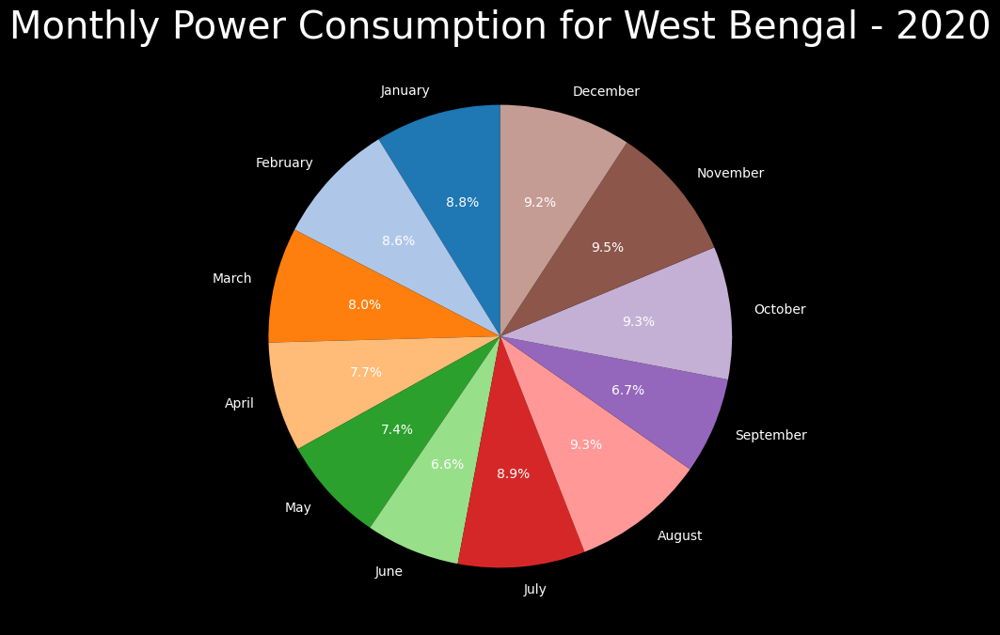

Generating pie chart for Sikkim in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


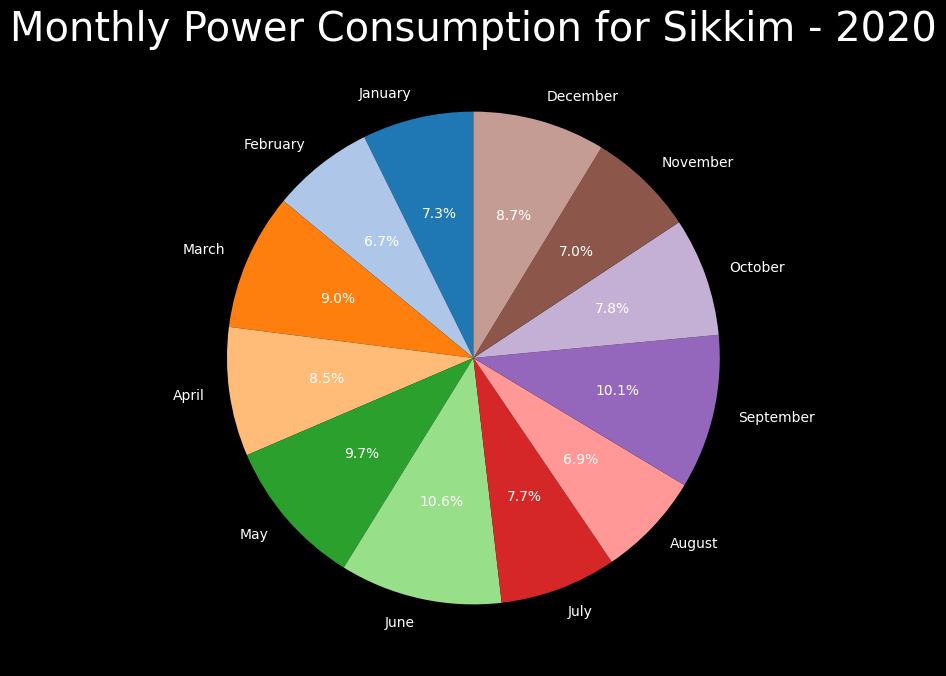

Generating pie chart for Arunachal Pradesh in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


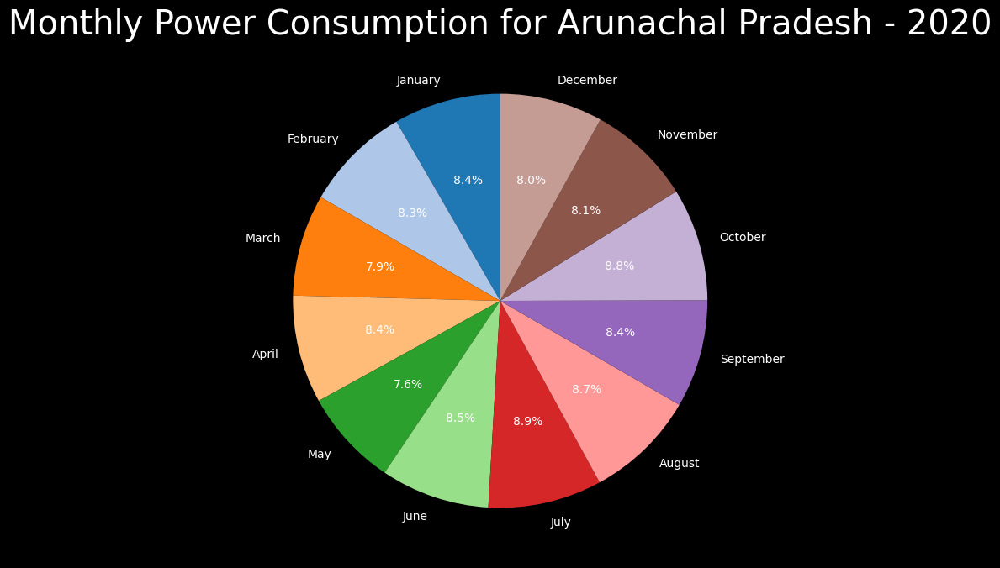

Generating pie chart for Assam in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


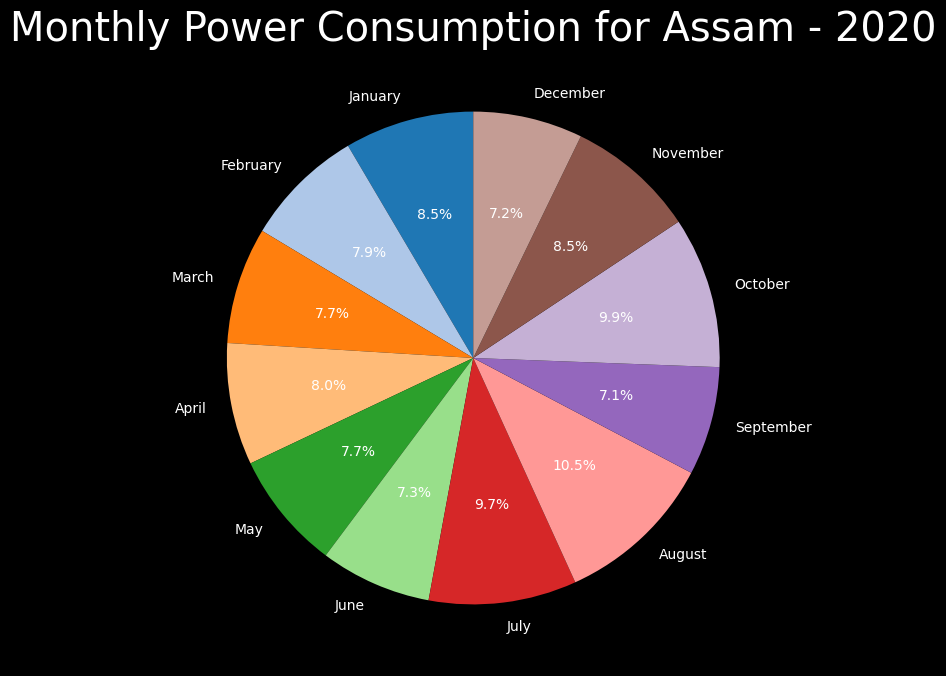

Generating pie chart for Manipur in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


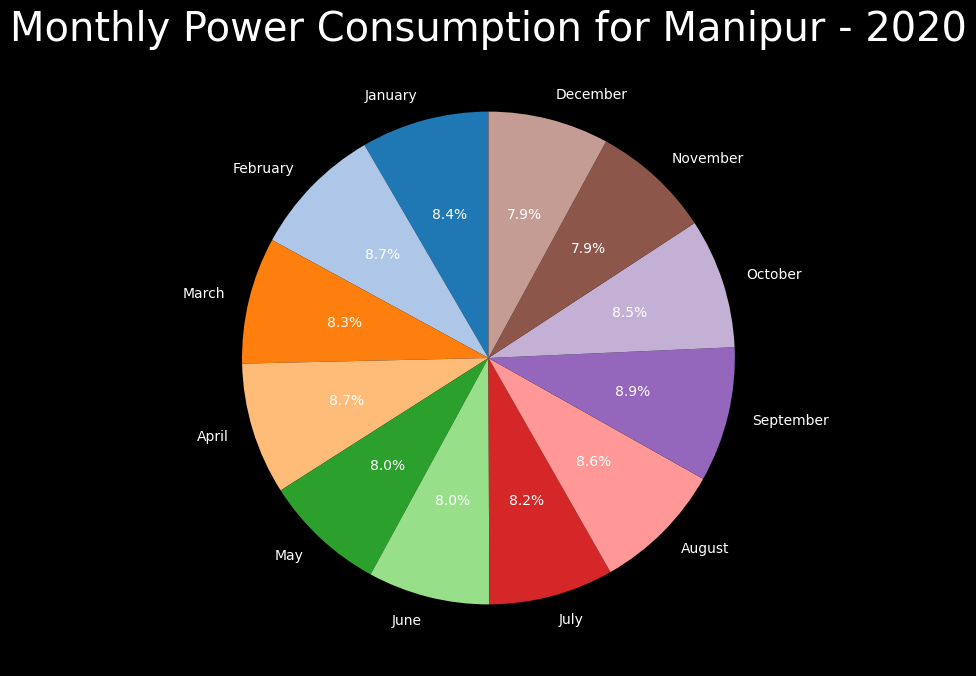

Generating pie chart for Meghalaya in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


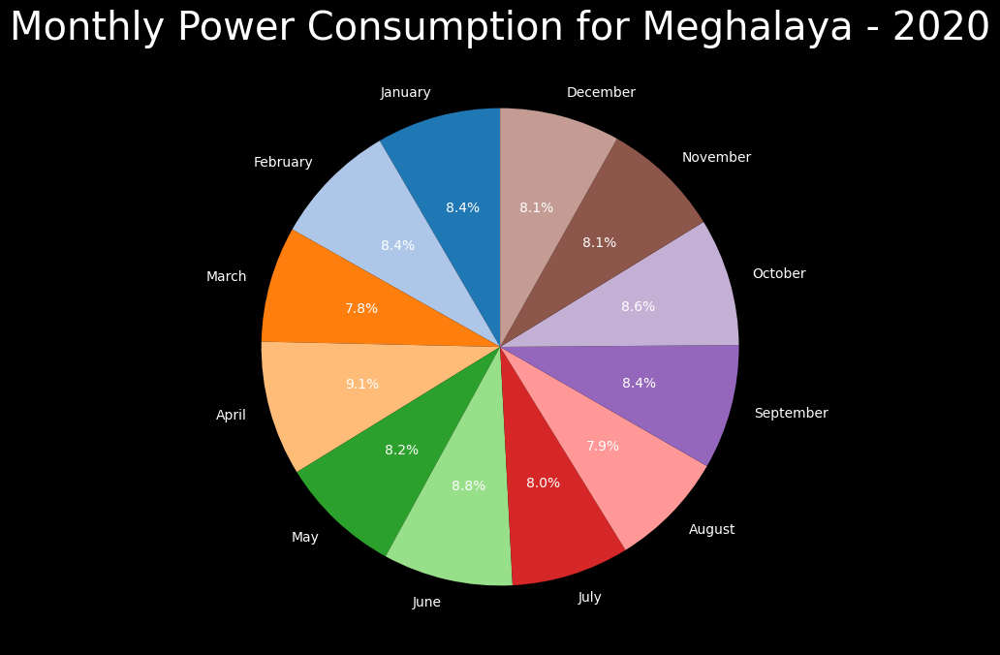

Generating pie chart for Mizoram in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


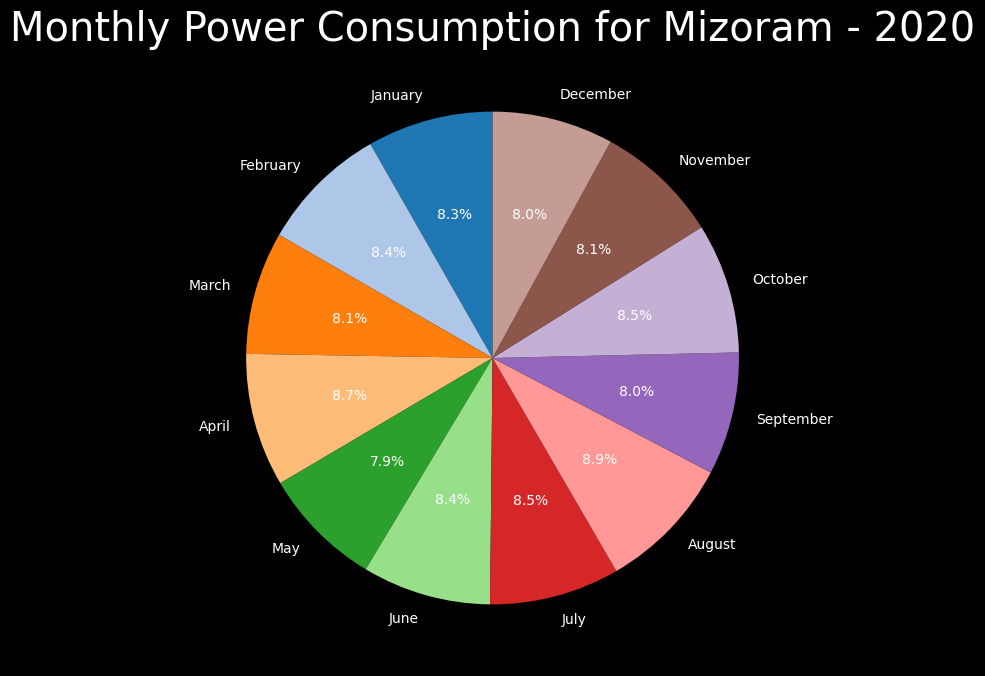

Generating pie chart for Nagaland in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


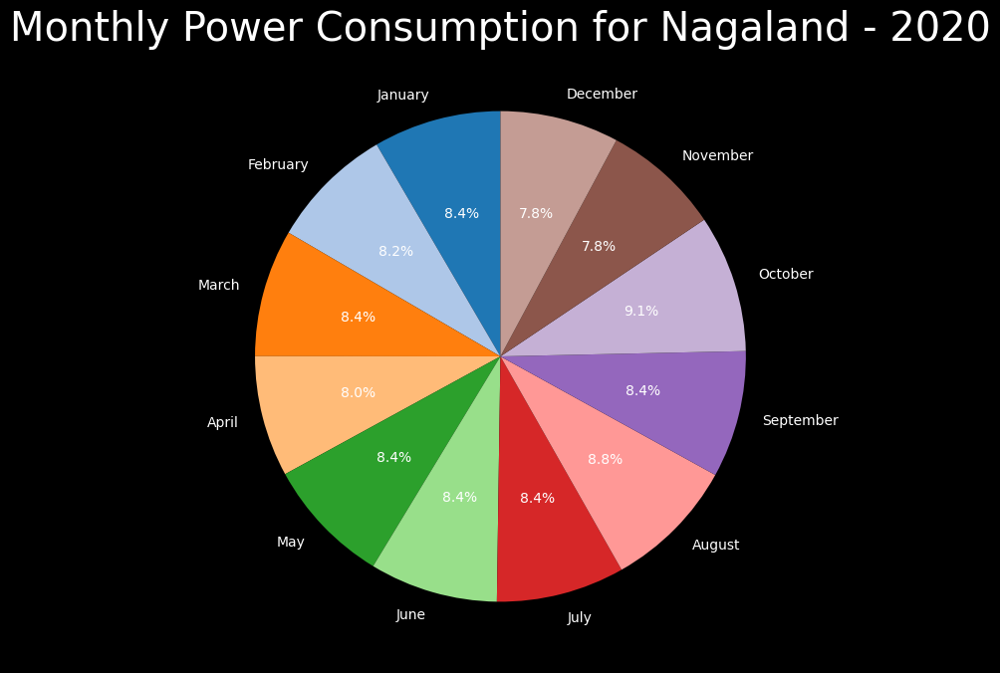

Generating pie chart for Tripura in 2020...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


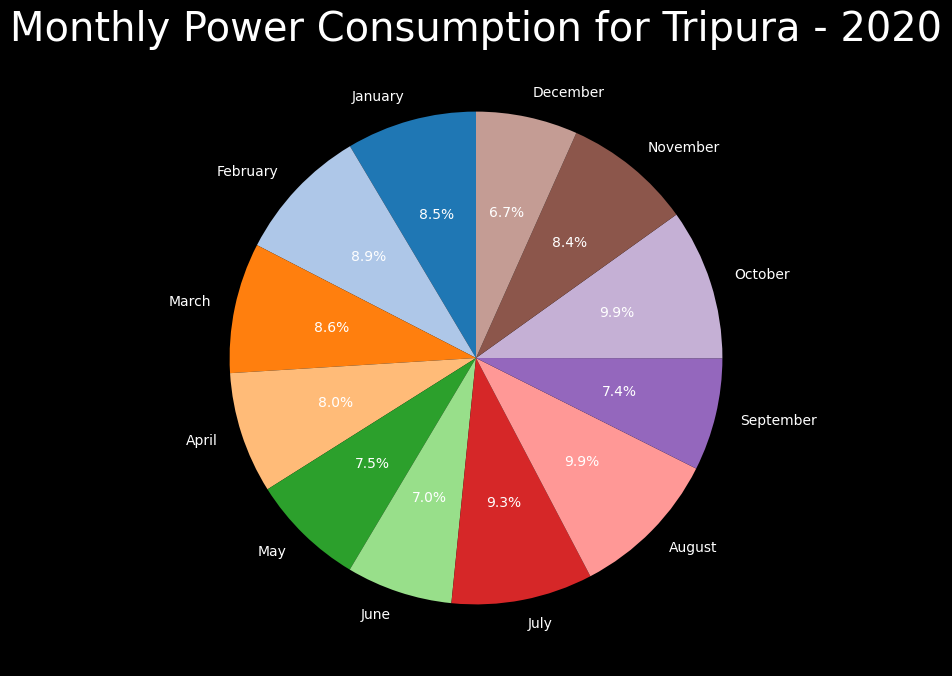

Generating pie chart for Punjab in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


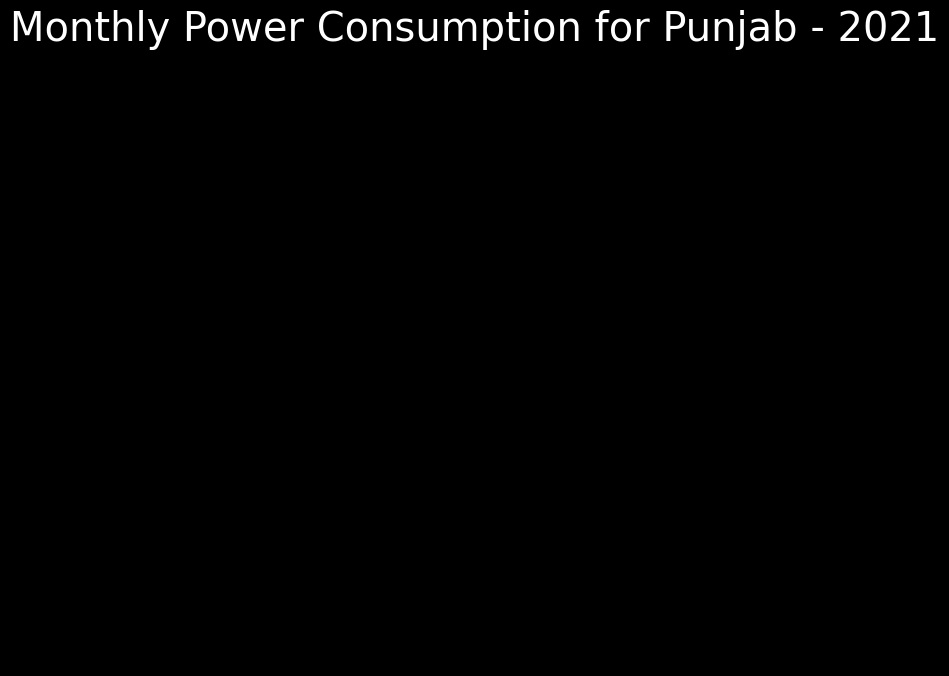

Generating pie chart for Haryana in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


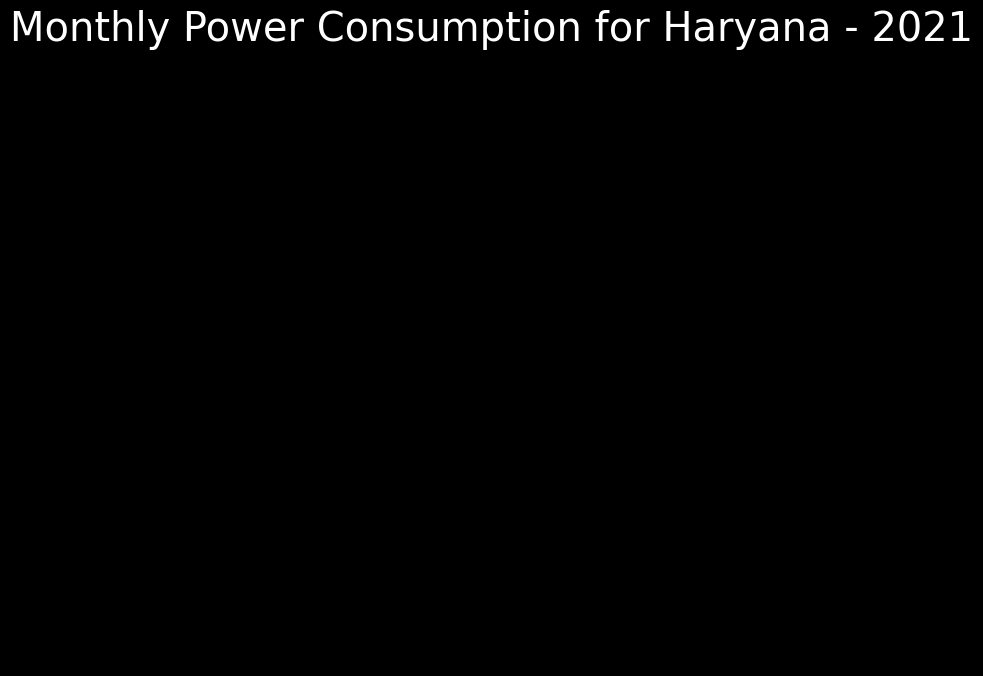

Generating pie chart for Rajasthan in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


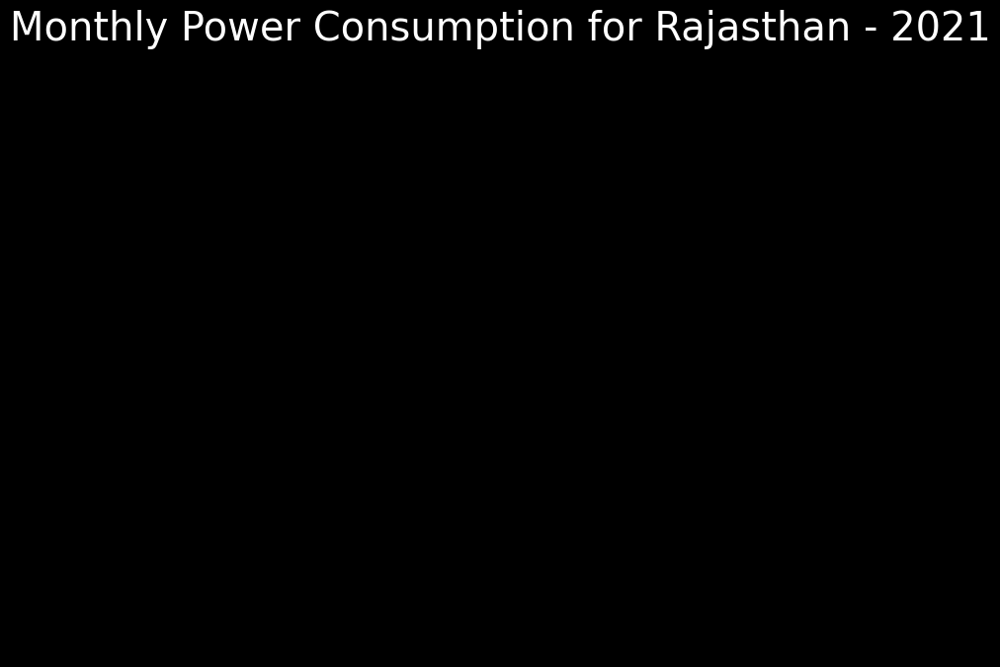

Generating pie chart for Delhi in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


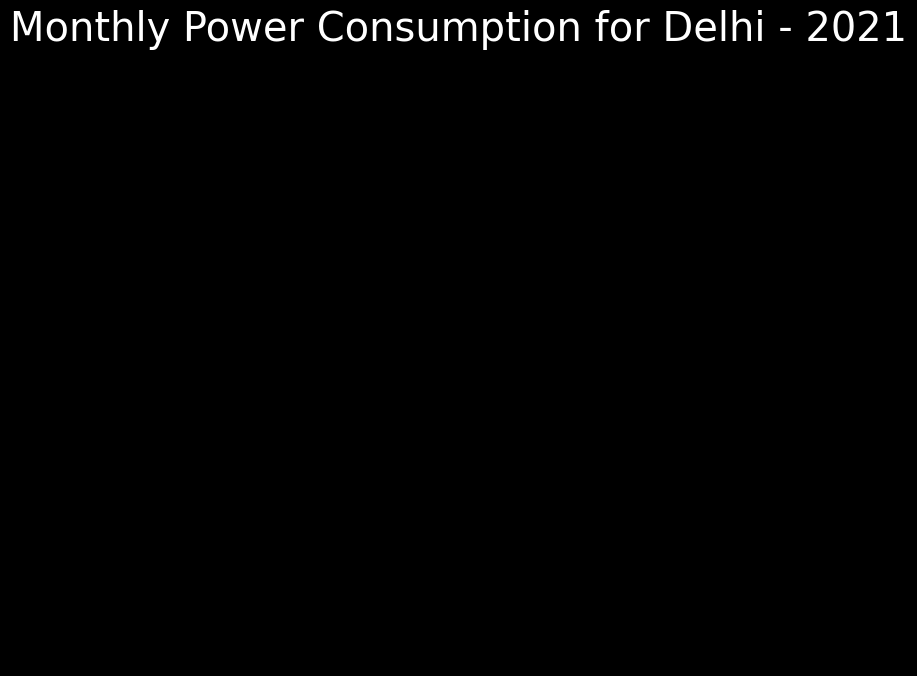

Generating pie chart for UP in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


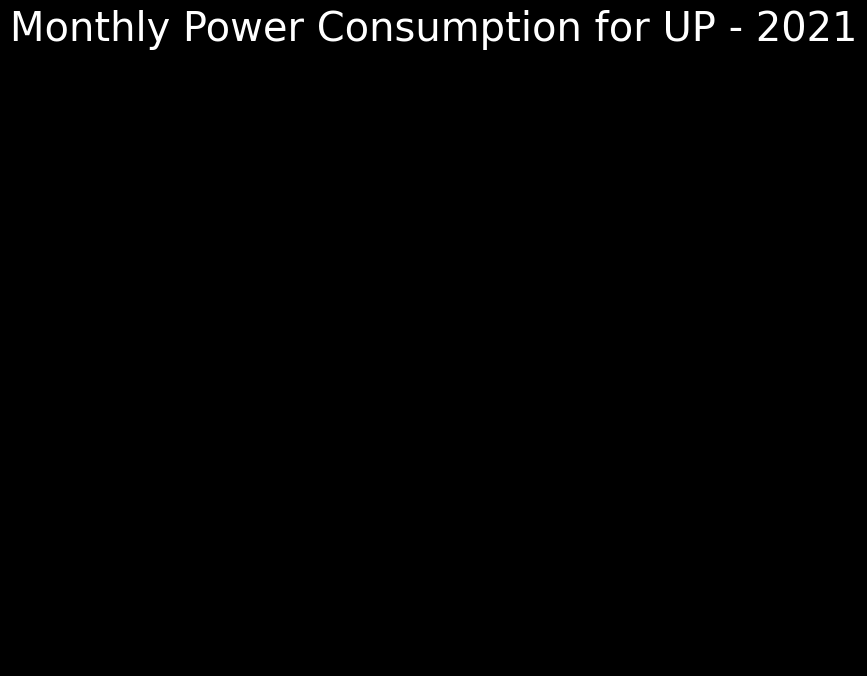

Generating pie chart for Uttarakhand in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


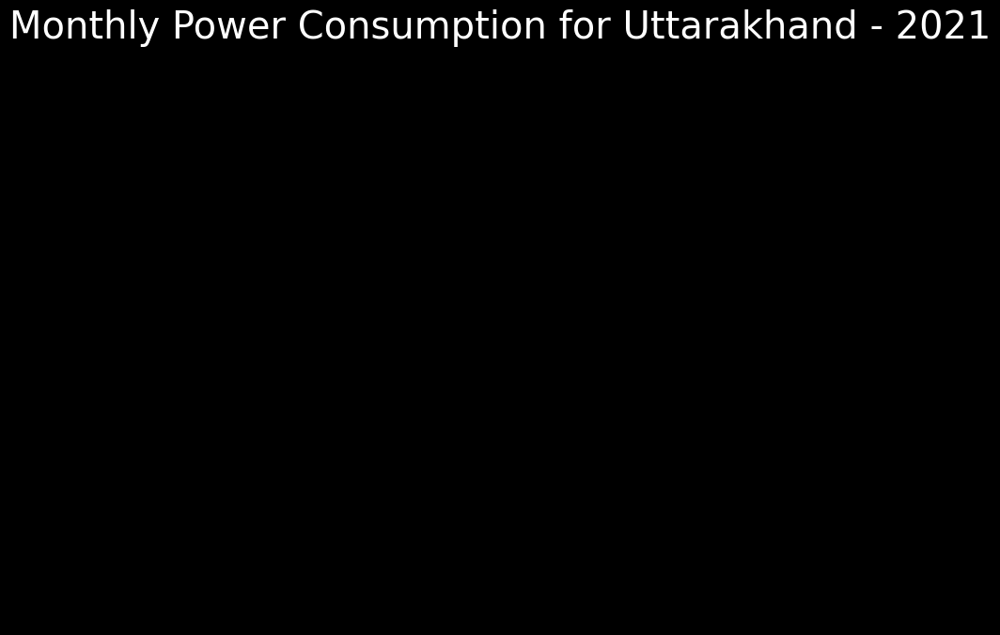

Generating pie chart for HP in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


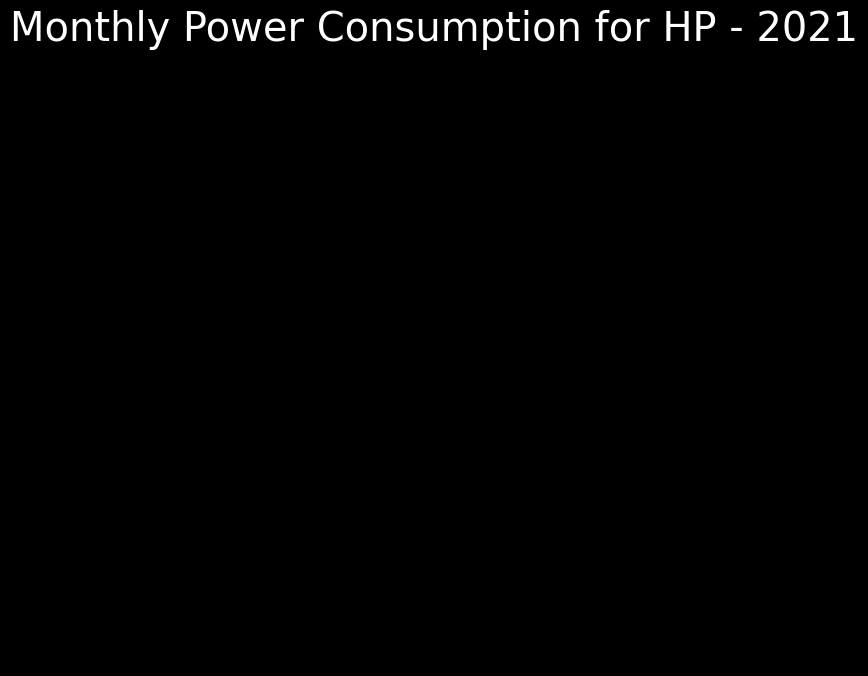

Generating pie chart for J&K in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


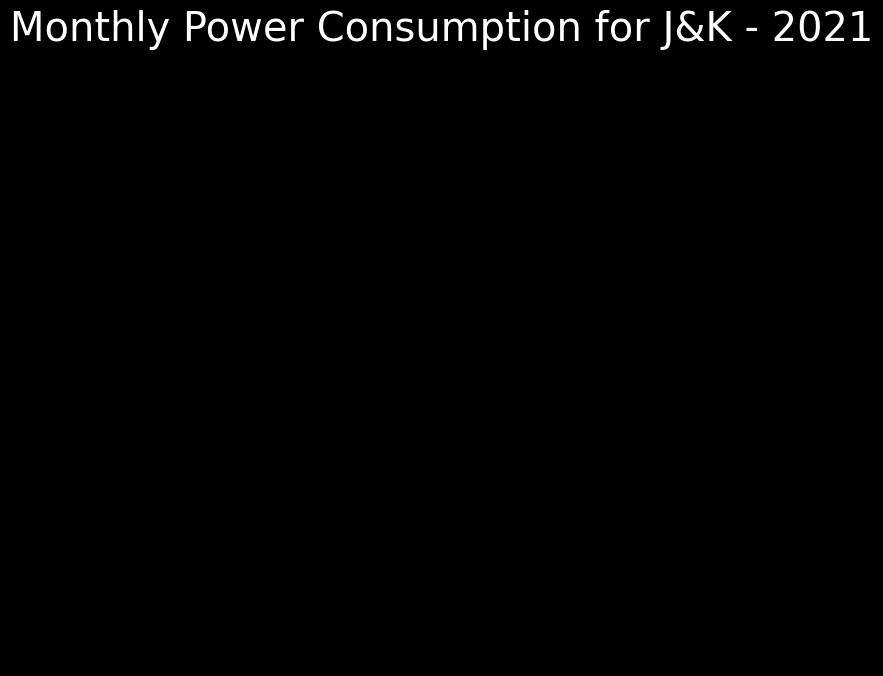

Generating pie chart for Chandigarh in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


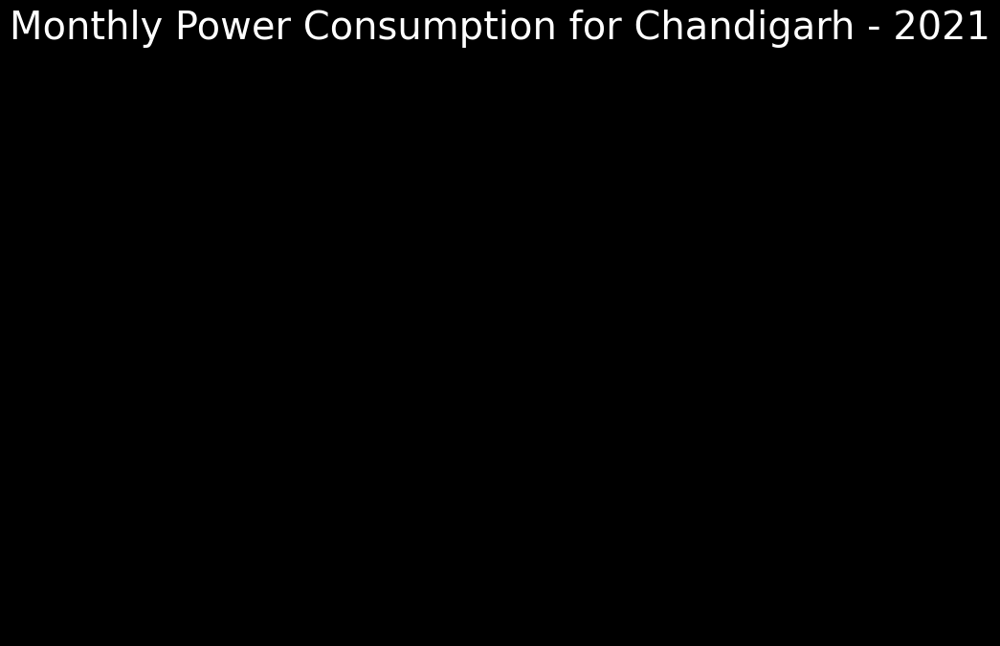

Generating pie chart for Chhattisgarh in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


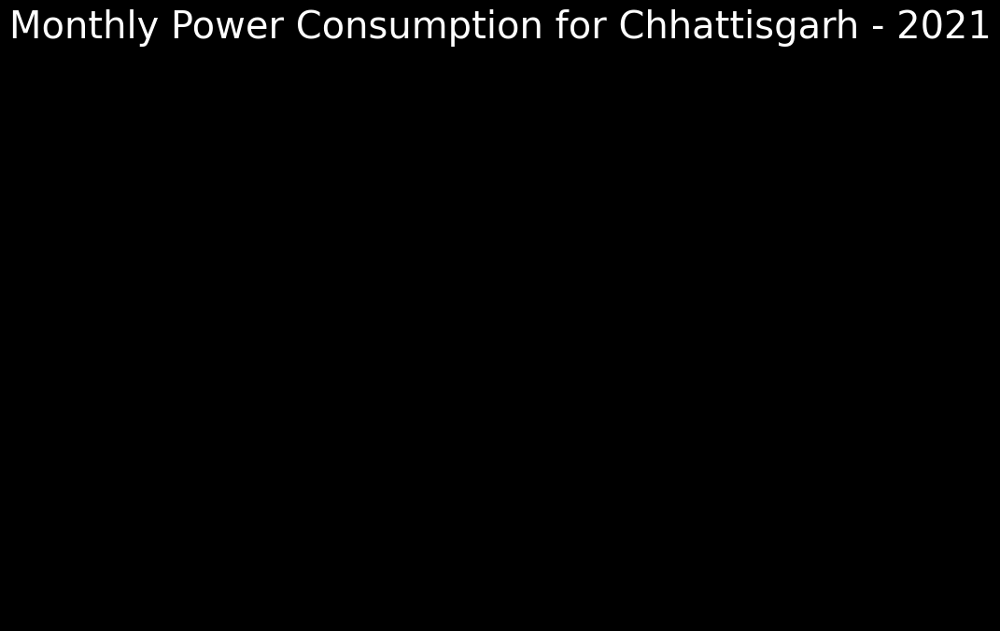

Generating pie chart for Gujarat in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


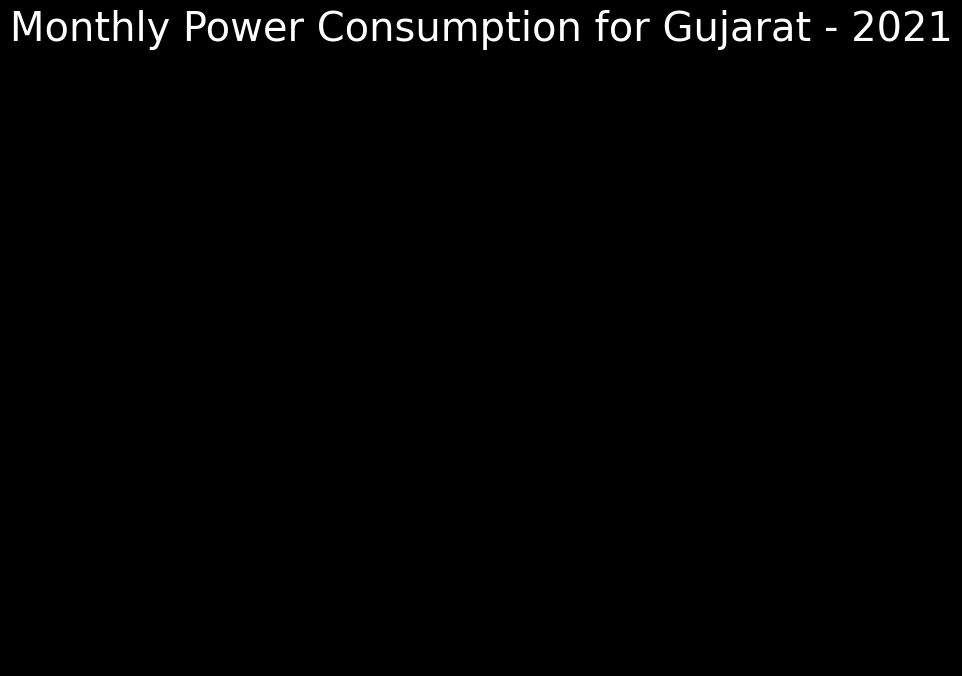

Generating pie chart for MP in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


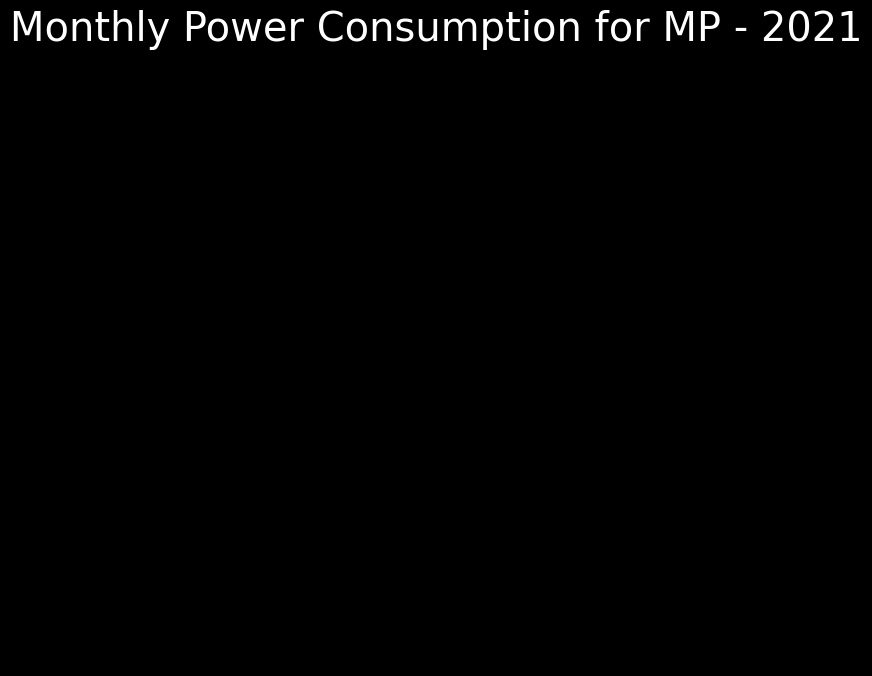

Generating pie chart for Maharashtra in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


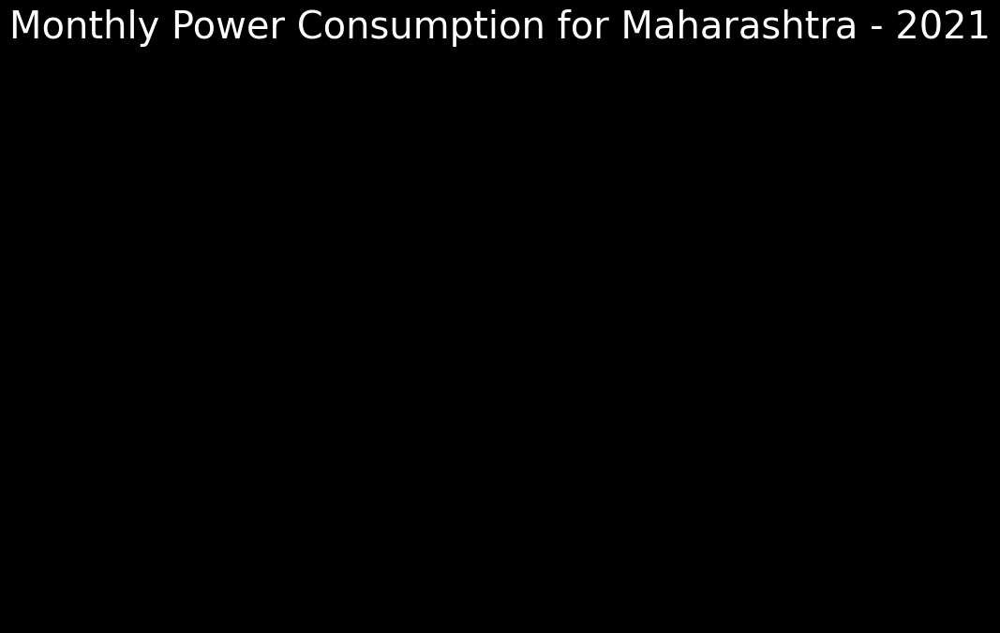

Generating pie chart for Goa in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


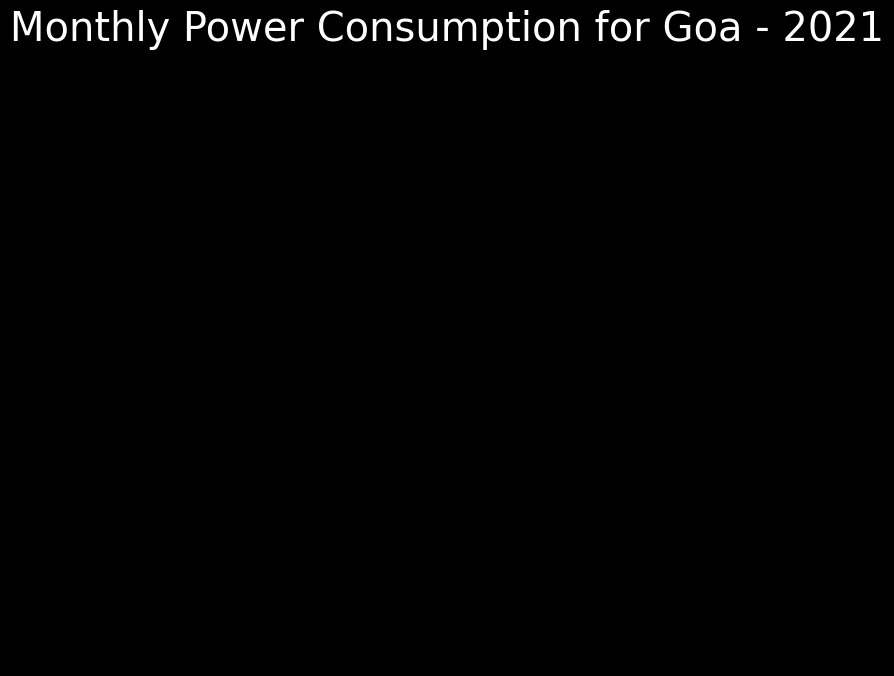

Generating pie chart for DNH in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


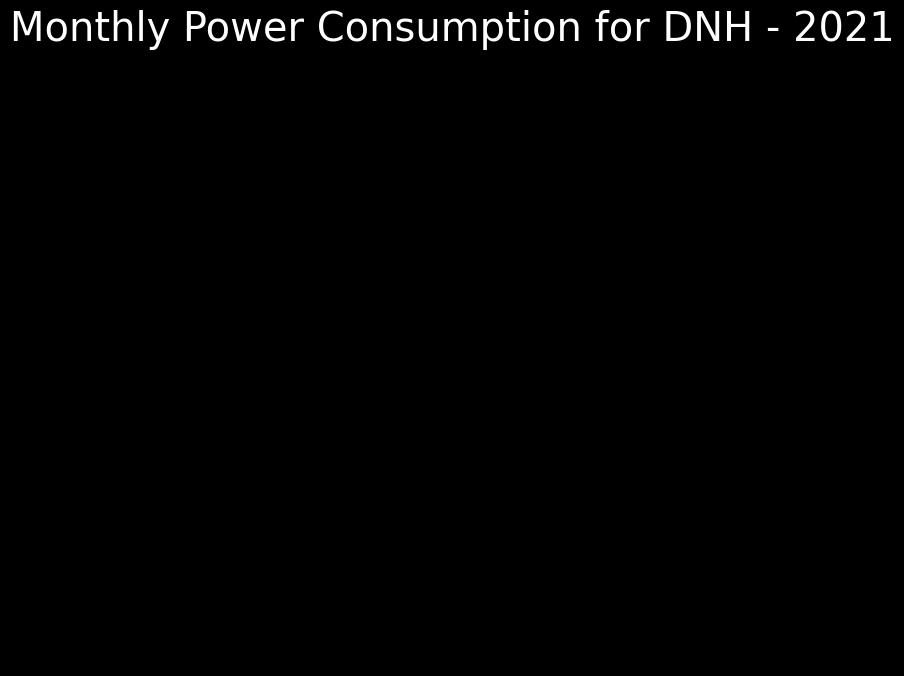

Generating pie chart for Andhra Pradesh in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


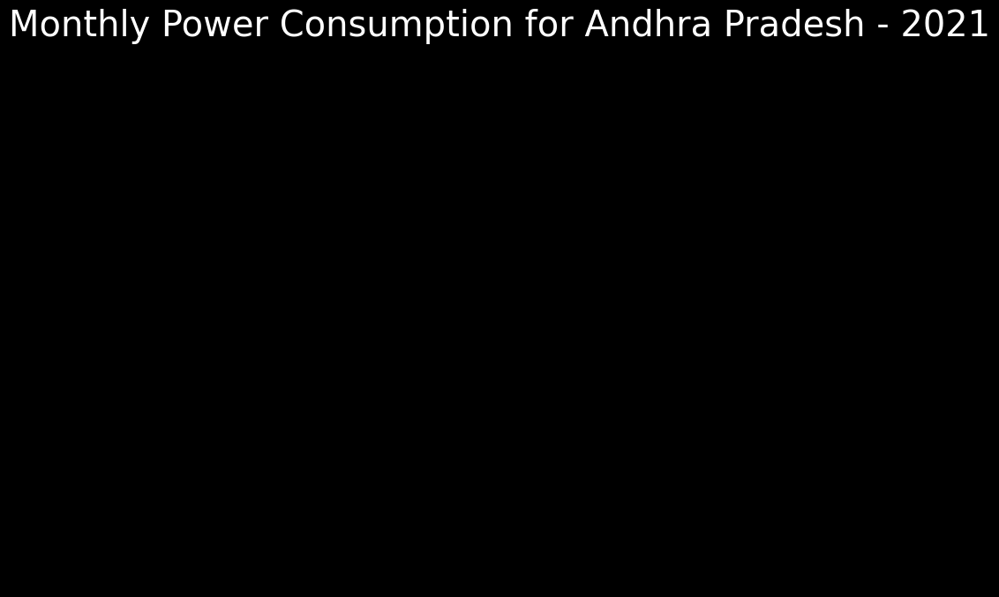

Generating pie chart for Telangana in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


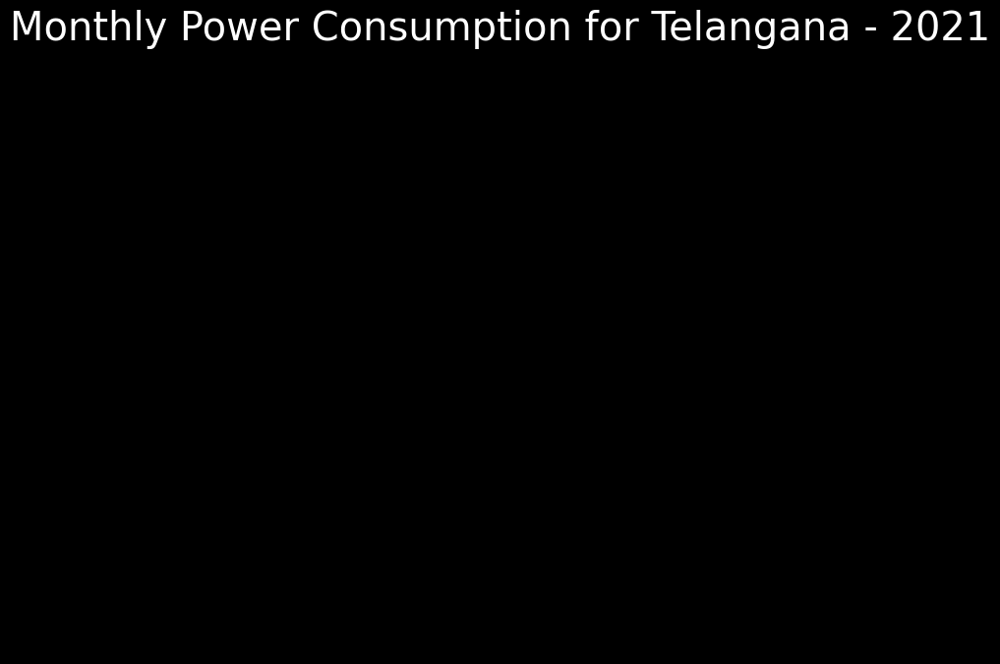

Generating pie chart for Karnataka in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


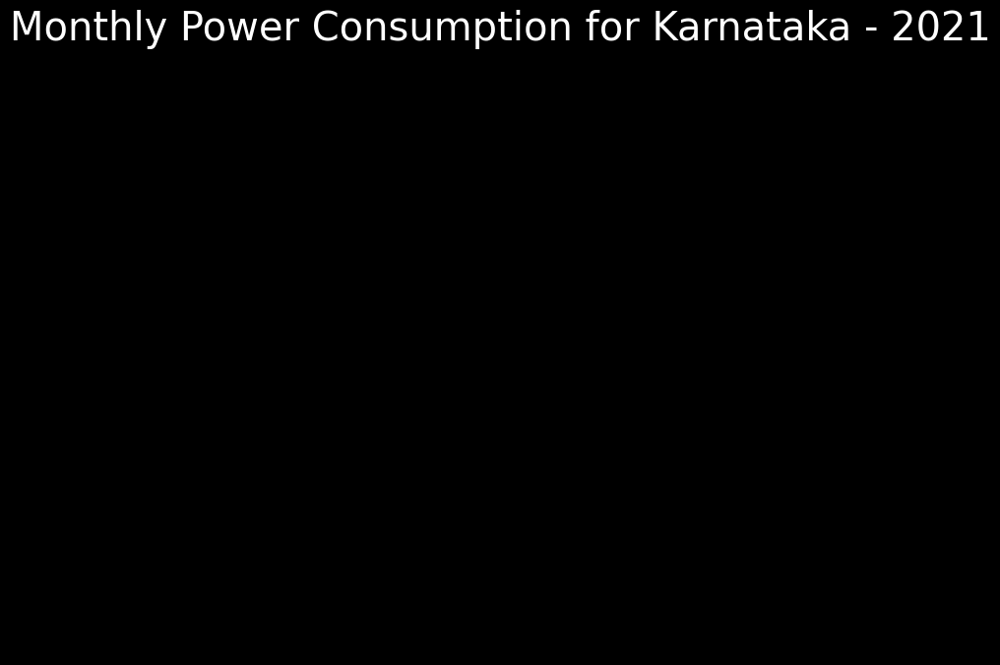

Generating pie chart for Kerala in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


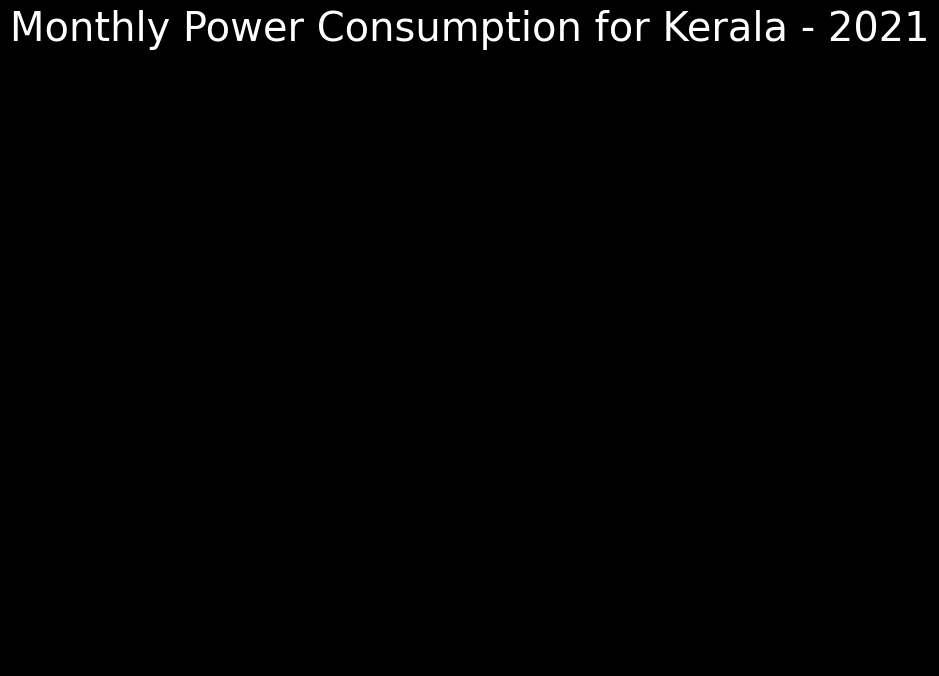

Generating pie chart for Tamil Nadu in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


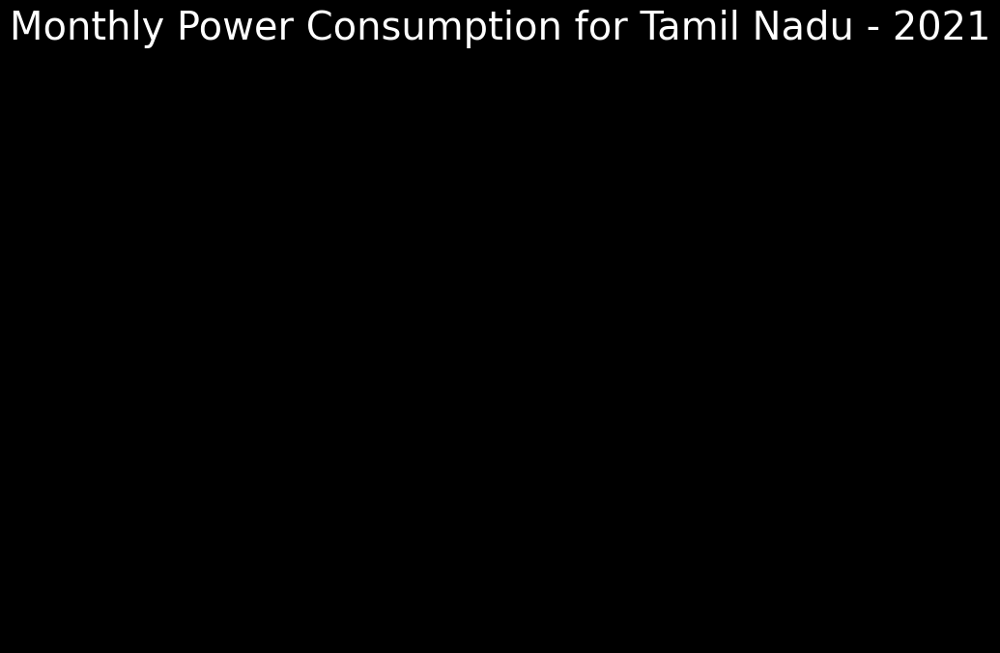

Generating pie chart for Pondy in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


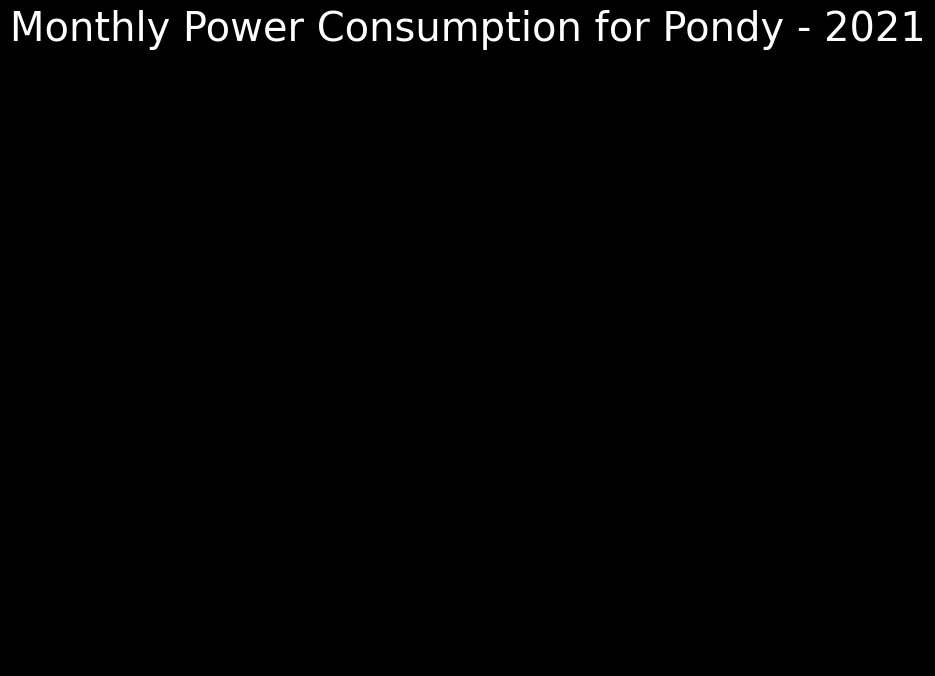

Generating pie chart for Bihar in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


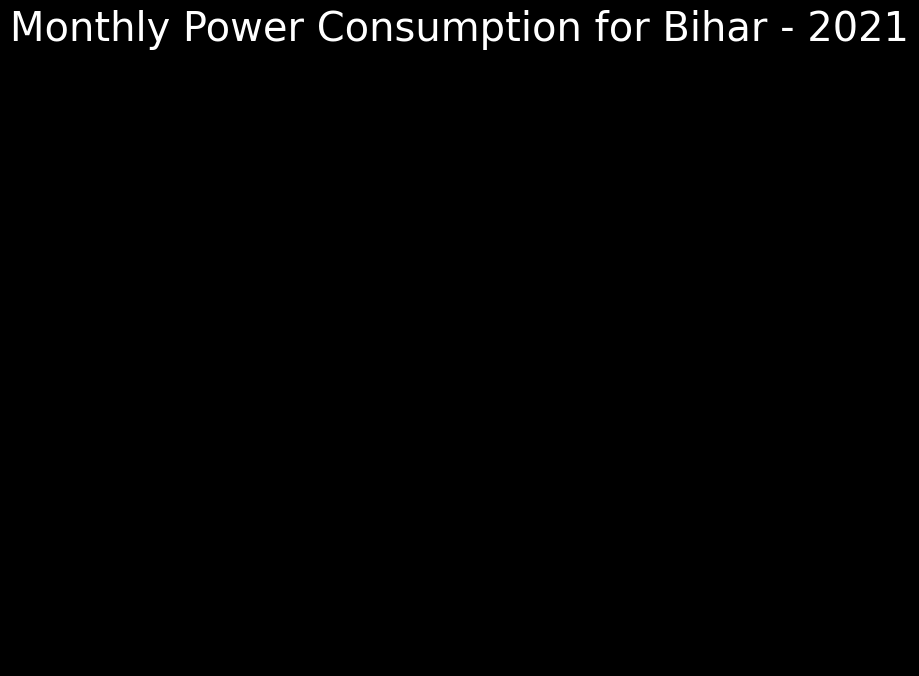

Generating pie chart for Jharkhand in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


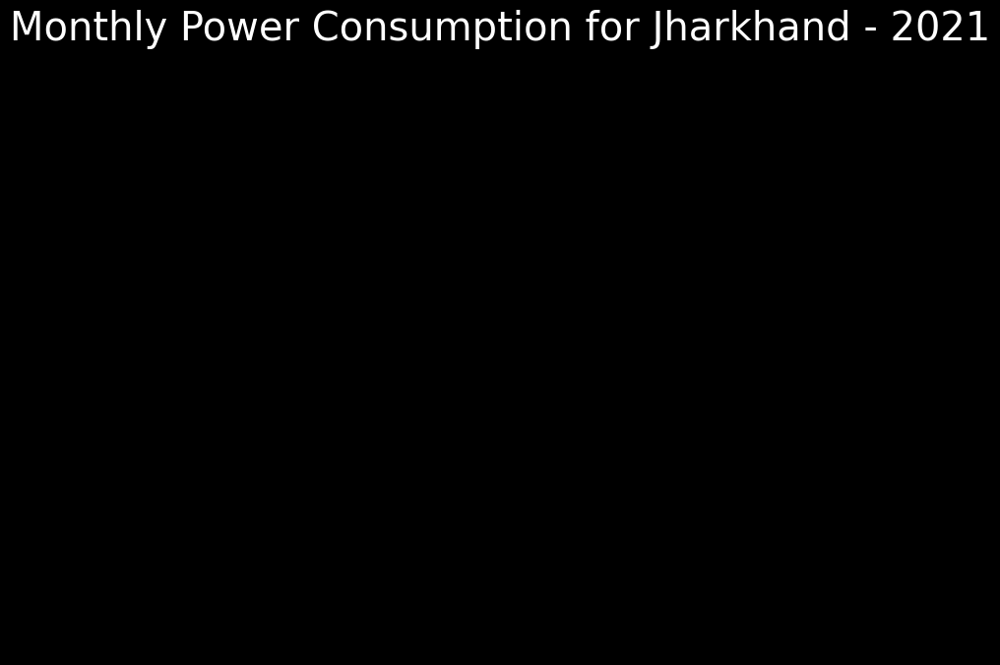

Generating pie chart for Odisha in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


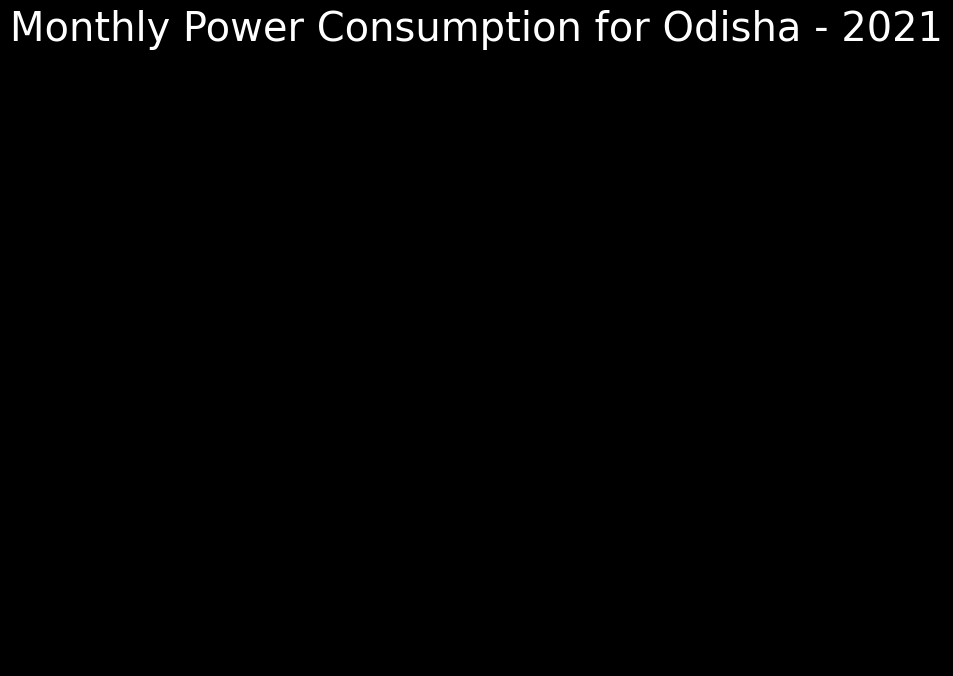

Generating pie chart for West Bengal in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


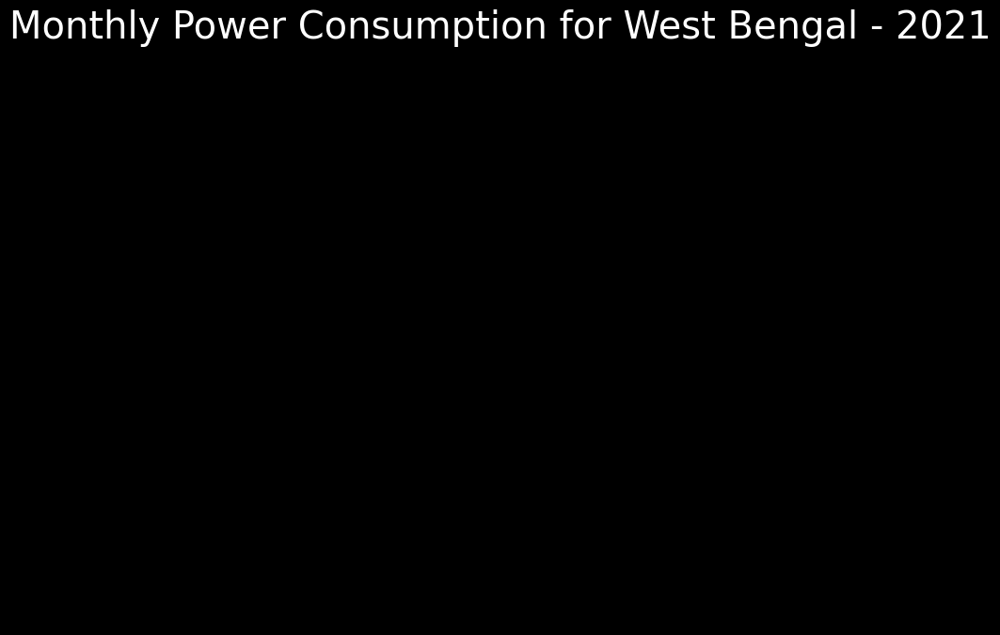

Generating pie chart for Sikkim in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


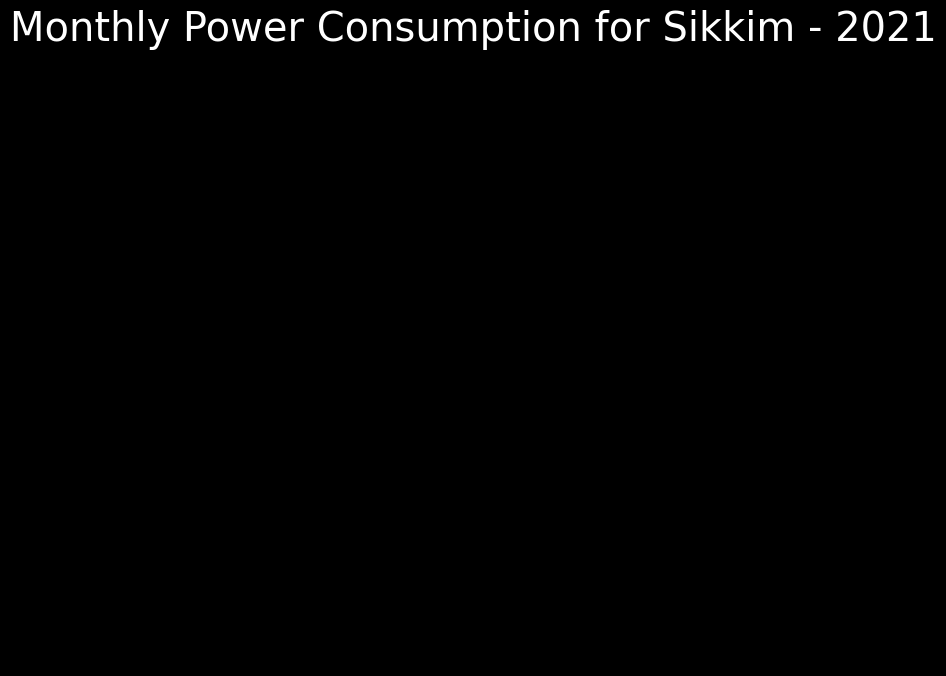

Generating pie chart for Arunachal Pradesh in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


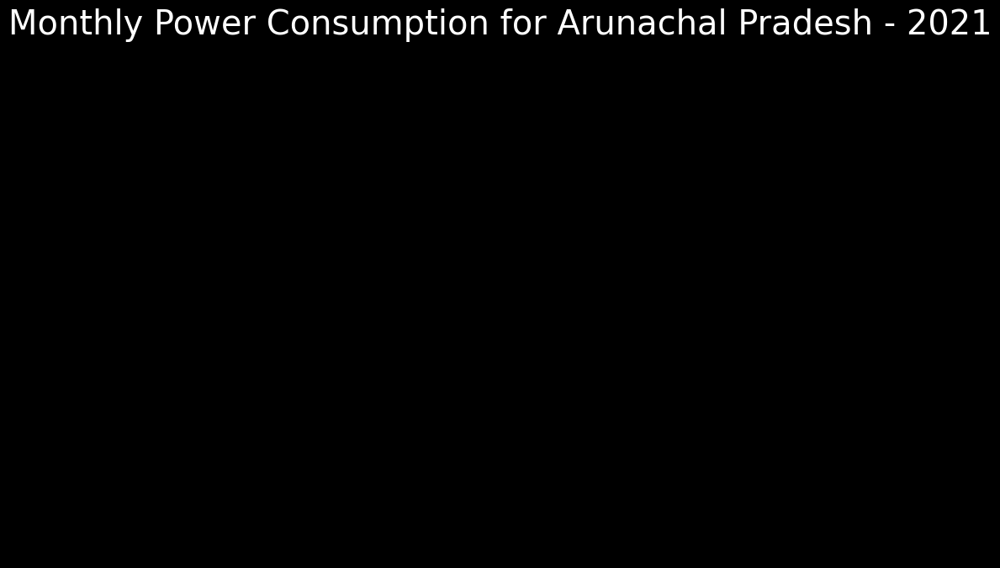

Generating pie chart for Assam in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


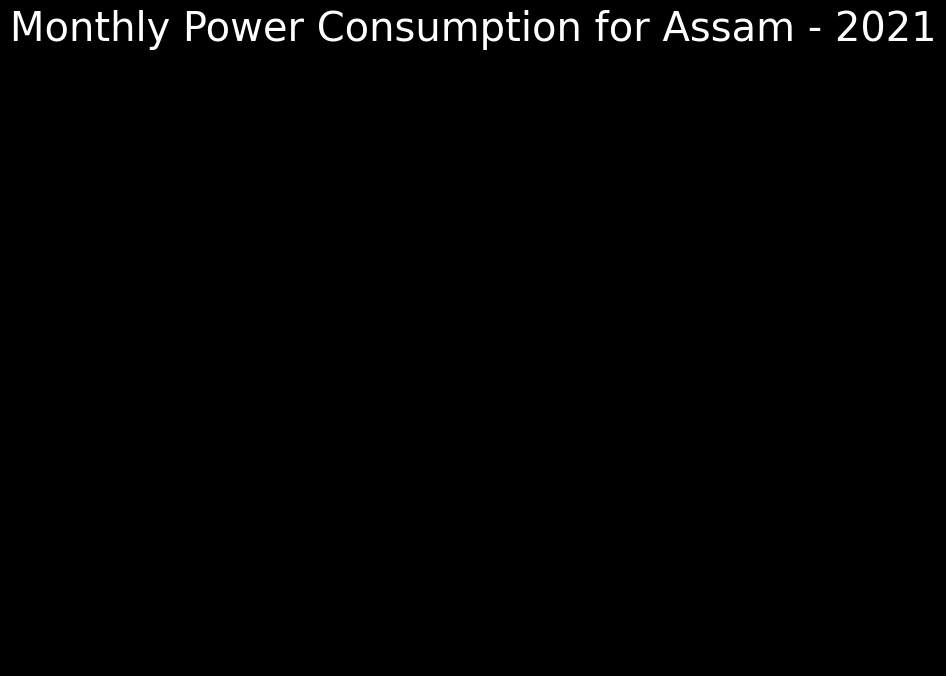

Generating pie chart for Manipur in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


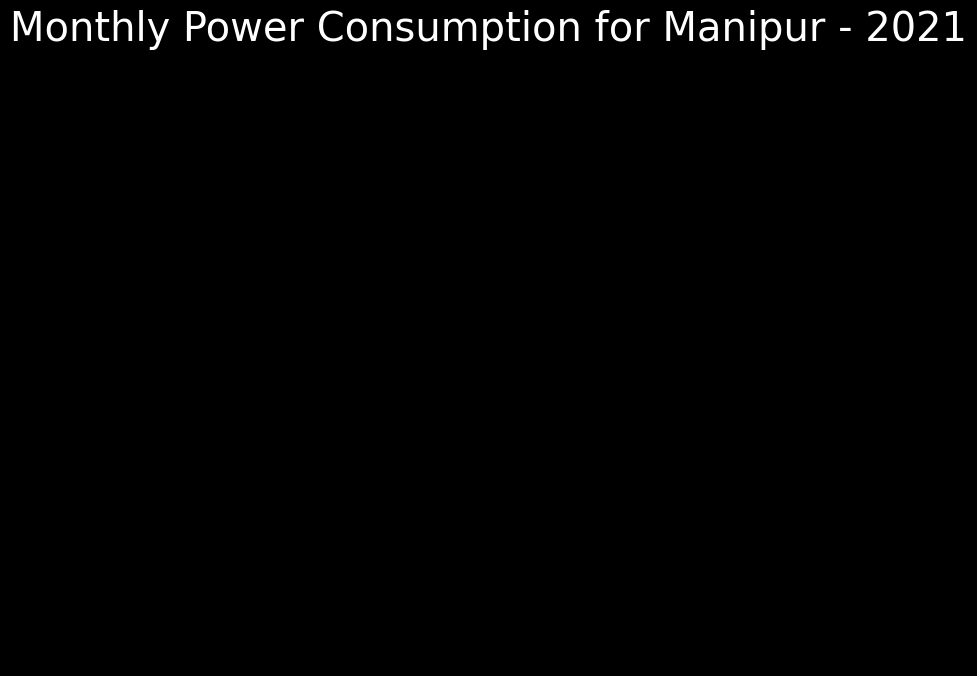

Generating pie chart for Meghalaya in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


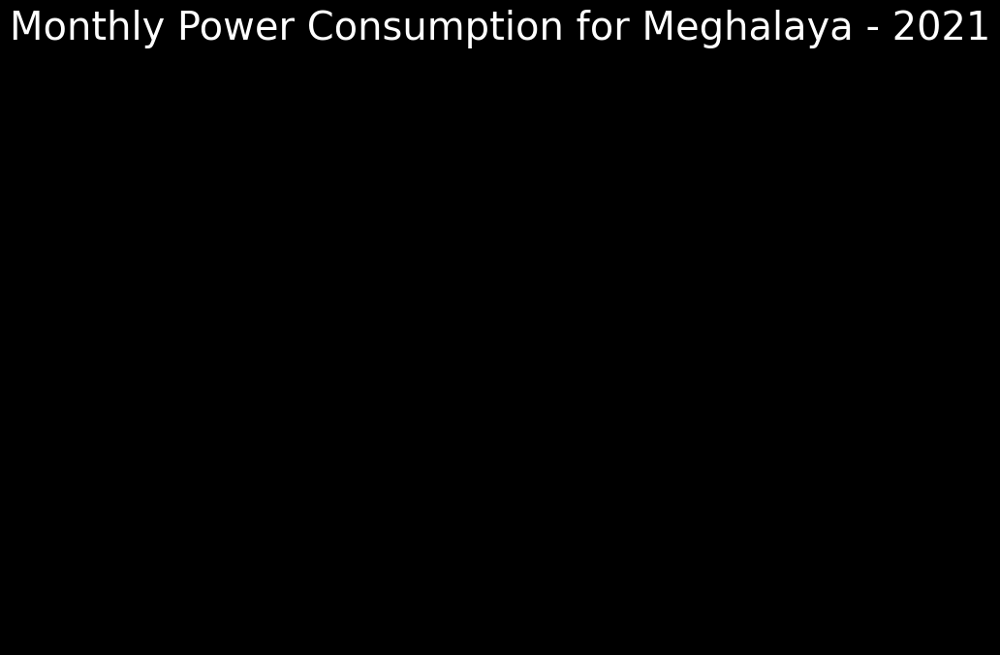

Generating pie chart for Mizoram in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


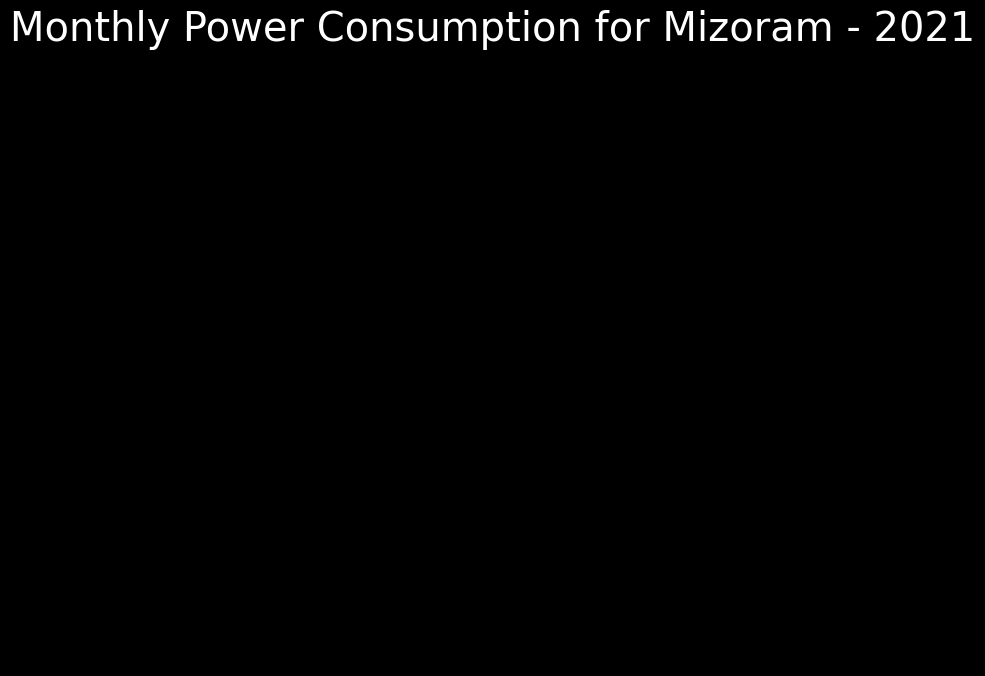

Generating pie chart for Nagaland in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


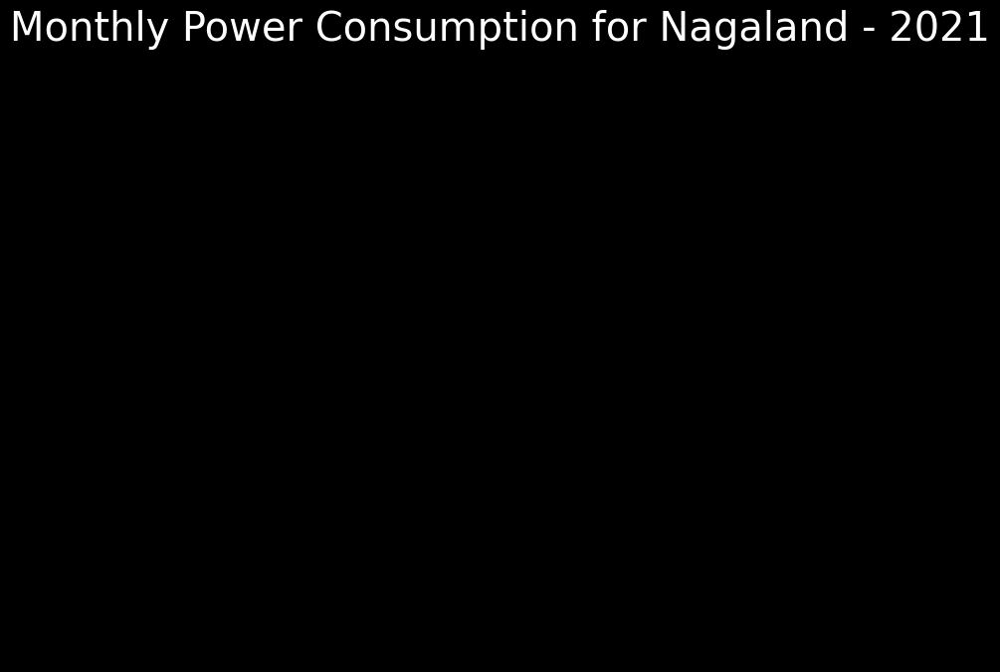

Generating pie chart for Tripura in 2021...


<ipython-input-49-5282358df139>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()


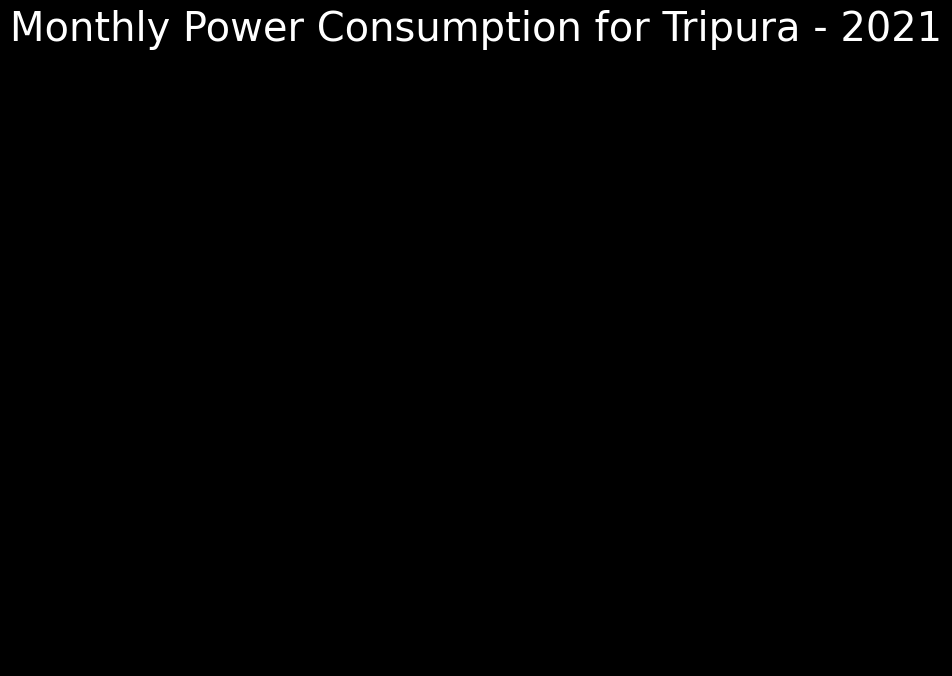

In [49]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming the data is already loaded into a DataFrame named 'df'
# Ensure 'DateTime' is parsed as datetime during loading
df['DateTime'] = pd.to_datetime(df['DateTime'], format='%d/%m/%Y %H:%M:%S')

# Extracting the year for filtering
df['Year'] = df['DateTime'].dt.year

# List of states
states = ['Punjab', 'Haryana', 'Rajasthan', 'Delhi', 'UP',
          'Uttarakhand', 'HP', 'J&K', 'Chandigarh', 'Chhattisgarh', 'Gujarat',
          'MP', 'Maharashtra', 'Goa', 'DNH', 'Andhra Pradesh', 'Telangana',
          'Karnataka', 'Kerala', 'Tamil Nadu', 'Pondy', 'Bihar', 'Jharkhand',
          'Odisha', 'West Bengal', 'Sikkim', 'Arunachal Pradesh', 'Assam',
          'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland', 'Tripura']

# Function to generate pie charts for a specific year and state
def plot_state_pie(df, year, state):
    # Filter data for the specific year
    yearly_data = df[df['Year'] == year]
    # Group by month and calculate the monthly average for the selected state
    monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()

    # Plot the pie chart
    plt.figure(figsize=(8, 8))
    plt.pie(
        monthly_avg,
        labels=monthly_avg.index.strftime('%B'),
        autopct='%1.1f%%',
        startangle=90,
        colors=plt.cm.tab20.colors,  # Use a color map for distinct colors
        textprops={'fontsize': 10}  # Adjust font size
    )
    plt.title(f"Monthly Power Consumption for {state} - {year}")
    plt.show()

# Generate pie charts for each state for 2019, 2020, and forecasted 2021
for year in [2019, 2020, 2021]:
    for state in states:
        print(f"Generating pie chart for {state} in {year}...")
        plot_state_pie(df, year, state)


<ipython-input-50-fbf1a7e4a65c>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()
<ipython-input-50-fbf1a7e4a65c>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()
<ipython-input-50-fbf1a7e4a65c>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()
<ipython-input-50-fbf1a7e4a65c>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()
<ipython-input-50-fbf1a7e4a65c>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M',

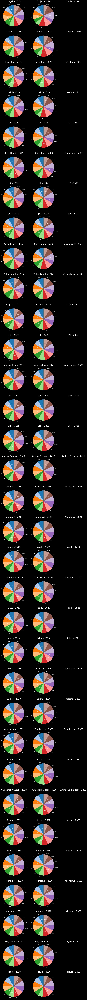

In [50]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming the data is already loaded into a DataFrame named 'df'
# Ensure 'DateTime' is parsed as datetime during loading
df['DateTime'] = pd.to_datetime(df['DateTime'], format='%d/%m/%Y %H:%M:%S')

# Extracting the year for filtering
df['Year'] = df['DateTime'].dt.year

# List of states
states = ['Punjab', 'Haryana', 'Rajasthan', 'Delhi', 'UP',
          'Uttarakhand', 'HP', 'J&K', 'Chandigarh', 'Chhattisgarh', 'Gujarat',
          'MP', 'Maharashtra', 'Goa', 'DNH', 'Andhra Pradesh', 'Telangana',
          'Karnataka', 'Kerala', 'Tamil Nadu', 'Pondy', 'Bihar', 'Jharkhand',
          'Odisha', 'West Bengal', 'Sikkim', 'Arunachal Pradesh', 'Assam',
          'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland', 'Tripura']

# Function to generate pie charts for a specific year and state
def plot_state_pie(ax, df, year, state):
    # Filter data for the specific year
    yearly_data = df[df['Year'] == year]
    # Group by month and calculate the monthly average for the selected state
    monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()

    # Plot the pie chart on the given axis
    ax.pie(
        monthly_avg,
        labels=monthly_avg.index.strftime('%B'),
        autopct='%1.1f%%',
        startangle=90,
        colors=plt.cm.tab20.colors,  # Use a color map for distinct colors
        textprops={'fontsize': 8}  # Adjust font size
    )
    ax.set_title(f"{state} - {year}")

# Create a figure with subplots for all states
fig, axes = plt.subplots(len(states), 3, figsize=(18, len(states) * 6))

# For each state, plot 3 pie charts (2019, 2020, and 2021)
for i, state in enumerate(states):
    for j, year in enumerate([2019, 2020, 2021]):
        # Pass the correct axis for the current state and year
        plot_state_pie(axes[i, j], df, year, state)

# Adjust layout for better visualization
plt.tight_layout()
plt.show()


<ipython-input-51-6f0f65a004cc>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()
<ipython-input-51-6f0f65a004cc>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()
<ipython-input-51-6f0f65a004cc>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()
<ipython-input-51-6f0f65a004cc>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()
<ipython-input-51-6f0f65a004cc>:24: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = yearly_data.resample('M',

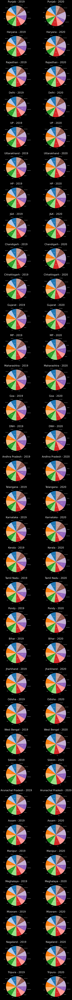

In [51]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming the data is already loaded into a DataFrame named 'df'
# Ensure 'DateTime' is parsed as datetime during loading
df['DateTime'] = pd.to_datetime(df['DateTime'], format='%d/%m/%Y %H:%M:%S')

# Extracting the year for filtering
df['Year'] = df['DateTime'].dt.year

# List of states
states = ['Punjab', 'Haryana', 'Rajasthan', 'Delhi', 'UP',
          'Uttarakhand', 'HP', 'J&K', 'Chandigarh', 'Chhattisgarh', 'Gujarat',
          'MP', 'Maharashtra', 'Goa', 'DNH', 'Andhra Pradesh', 'Telangana',
          'Karnataka', 'Kerala', 'Tamil Nadu', 'Pondy', 'Bihar', 'Jharkhand',
          'Odisha', 'West Bengal', 'Sikkim', 'Arunachal Pradesh', 'Assam',
          'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland', 'Tripura']

# Function to generate pie charts for a specific year and state
def plot_state_pie(ax, df, year, state):
    # Filter data for the specific year
    yearly_data = df[df['Year'] == year]
    # Group by month and calculate the monthly average for the selected state
    monthly_avg = yearly_data.resample('M', on='DateTime')[state].mean()

    # Plot the pie chart on the given axis
    ax.pie(
        monthly_avg,
        labels=monthly_avg.index.strftime('%B'),
        autopct='%1.1f%%',
        startangle=90,
        colors=plt.cm.tab20.colors,  # Use a color map for distinct colors
        textprops={'fontsize': 8}  # Adjust font size
    )
    ax.set_title(f"{state} - {year}")

# Create a figure with subplots for all states
fig, axes = plt.subplots(len(states), 2, figsize=(15, len(states) * 5))

# For each state, plot 2 pie charts (2019 and 2020)
for i, state in enumerate(states):
    for j, year in enumerate([2019, 2020]):
        # Pass the correct axis for the current state and year
        plot_state_pie(axes[i, j], df, year, state)

# Adjust layout for better visualization
plt.tight_layout()
plt.show()


In [57]:
print(data.columns)


Index(['Unnamed: 0', 'Punjab', 'Haryana', 'Rajasthan', 'Delhi', 'UP',
       'Uttarakhand', 'HP', 'J&K', 'Chandigarh', 'Chhattisgarh', 'Gujarat',
       'MP', 'Maharashtra', 'Goa', 'DNH', 'Andhra Pradesh', 'Telangana',
       'Karnataka', 'Kerala', 'Tamil Nadu', 'Pondy', 'Bihar', 'Jharkhand',
       'Odisha', 'West Bengal', 'Sikkim', 'Arunachal Pradesh', 'Assam',
       'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland', 'Tripura'],
      dtype='object')


In [58]:
data.rename(columns={'your_text_column': 'text', 'your_label_column': 'label'}, inplace=True)


In [59]:
data = pd.DataFrame({
    'text': [
        'Power consumption is high in Delhi',
        'Normal usage in Tamil Nadu',
        'Outage reported in Haryana',
        'Increased usage in Rajasthan',
        'Steady usage in Kerala'
    ],
    'label': [1, 0, 1, 1, 0]  # 1: High, 0: Normal
})


In [60]:
import pandas as pd

# Simulate text data based on power consumption
data = pd.DataFrame({
    'text': [
        'Punjab is experiencing high power usage',
        'Normal consumption in Haryana',
        'Rajasthan reports increased demand',
        'Delhi has steady power usage',
        'Kerala reports low power usage'
    ],
    'label': [1, 0, 1, 0, 0]  # Labels: 1 = High, 0 = Normal/Low
})

print(data.head())


                                      text  label
0  Punjab is experiencing high power usage      1
1            Normal consumption in Haryana      0
2       Rajasthan reports increased demand      1
3             Delhi has steady power usage      0
4           Kerala reports low power usage      0


In [62]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report, accuracy_score

# Step 1: Create a sample dataset with textual descriptions and labels
data = pd.DataFrame({
    'text': [
        'Punjab has high power consumption',
        'Haryana reports normal power usage',
        'Rajasthan sees an increase in demand',
        'Delhi maintains steady power usage',
        'UP is facing power outages due to high demand'
    ],
    'label': [1, 0, 1, 0, 1]  # Labels: 1 = High, 0 = Normal/Low
})

# Step 2: Preprocessing the textual data
vectorizer = CountVectorizer(stop_words='english')
X = vectorizer.fit_transform(data['text'])  # Transform text to numeric vectors
y = data['label']  # Target labels

# Step 3: Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Train a simple model (e.g., Naive Bayes)
model = MultinomialNB()
model.fit(X_train, y_train)

# Step 5: Evaluate the model
y_pred = model.predict(X_test)
print("Classification Report:\n", classification_report(y_test, y_pred))
print("Accuracy:", accuracy_score(y_test, y_pred))

# Step 6: Make predictions on new data
new_data = ['Punjab reports heavy power usage', 'Delhi is stable in power demand']
new_data_vectorized = vectorizer.transform(new_data)
predictions = model.predict(new_data_vectorized)

for text, label in zip(new_data, predictions):
    print(f"Text: '{text}' => Predicted Label: {'High' if label == 1 else 'Normal/Low'}")


Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00         1

    accuracy                           1.00         1
   macro avg       1.00      1.00      1.00         1
weighted avg       1.00      1.00      1.00         1

Accuracy: 1.0
Text: 'Punjab reports heavy power usage' => Predicted Label: High
Text: 'Delhi is stable in power demand' => Predicted Label: High


In [63]:


import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score
import pickle

# Step 1: Simulated dataset for training
data = pd.DataFrame({
    'text': [
        'Punjab has high power consumption',
        'Haryana reports normal power usage',
        'Rajasthan sees an increase in demand',
        'Delhi maintains steady power usage',
        'UP is facing power outages due to high demand',
        'Kerala power usage remains low this season',
        'Tamil Nadu is experiencing a surge in demand',
        'Chandigarh has consistent power usage',
        'Maharashtra records very high power consumption',
        'Gujarat power usage is moderate',
    ],
    'label': [1, 0, 1, 0, 1, 0, 1, 0, 1, 0]  # 1 = High, 0 = Normal/Low
})

# Step 2: Text preprocessing using TF-IDF
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(data['text'])  # Transform text to numeric vectors
y = data['label']  # Target labels

# Step 3: Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Train a more advanced model (Random Forest)
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Step 5: Evaluate the model
y_pred = model.predict(X_test)
print("Classification Report:\n", classification_report(y_test, y_pred))
print("Accuracy:", accuracy_score(y_test, y_pred))

# Step 6: Save the model and vectorizer for future use
with open('power_prediction_model.pkl', 'wb') as model_file:
    pickle.dump(model, model_file)
with open('vectorizer.pkl', 'wb') as vectorizer_file:
    pickle.dump(vectorizer, vectorizer_file)

# Step 7: Future prediction on new data
def predict_power_consumption(texts):
    # Load the saved model and vectorizer
    with open('power_prediction_model.pkl', 'rb') as model_file:
        loaded_model = pickle.load(model_file)
    with open('vectorizer.pkl', 'rb') as vectorizer_file:
        loaded_vectorizer = pickle.load(vectorizer_file)

    # Transform new data and predict
    texts_vectorized = loaded_vectorizer.transform(texts)
    predictions = loaded_model.predict(texts_vectorized)
    return predictions

# New data for prediction
new_texts = [
    'Punjab faces extreme power demand this summer',
    'Kerala reports stable power usage patterns'
]
predictions = predict_power_consumption(new_texts)

# Display predictions
for text, label in zip(new_texts, predictions):
    print(f"Text: '{text}' => Predicted Label: {'High' if label == 1 else 'Normal/Low'}")


Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1

    accuracy                           1.00         2
   macro avg       1.00      1.00      1.00         2
weighted avg       1.00      1.00      1.00         2

Accuracy: 1.0
Text: 'Punjab faces extreme power demand this summer' => Predicted Label: High
Text: 'Kerala reports stable power usage patterns' => Predicted Label: Normal/Low


In [68]:
# Check the columns of the dataset
print(data_2019_2020_encoded.columns)


Index(['Unnamed: 0', 'Year', 'Punjab_56.1', 'Punjab_57.6', 'Punjab_60.0',
       'Punjab_62.7', 'Punjab_63.1', 'Punjab_63.5', 'Punjab_63.6',
       'Punjab_66.9',
       ...
       'Tripura_5.3', 'Tripura_5.4', 'Tripura_5.5', 'Tripura_5.6',
       'Tripura_5.7', 'Tripura_5.8', 'Tripura_5.9', 'Tripura_6.0',
       'Tripura_6.2', 'Tripura_6.6'],
      dtype='object', length=7315)


In [69]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Load the dataset
data = pd.read_csv('dataset_tk.csv')

# Display the first few rows to understand the structure
print(data.head())

# Step 1: Prepare the data for modeling
# Let's assume that columns like 'Punjab_56.1', 'Punjab_57.6' represent power consumption over the years

# Select the columns relevant for power consumption (excluding non-relevant ones like 'Unnamed: 0' and 'Year')
columns_of_interest = [col for col in data.columns if col not in ['Unnamed: 0', 'Year']]

# Create a target variable for prediction (e.g., predicting power consumption for the next year)
# Here, we are assuming the last column represents 2021 power consumption (or the next time period)
target_column = columns_of_interest[-1]  # Adjust based on how you structure the prediction

# Step 2: Create the feature set (using 2019 and 2020 data as features)
# Assume the columns represent power consumption data for previous years (e.g., 'Punjab_56.1', 'Punjab_57.6')
X = data[columns_of_interest[:-1]]  # Use all columns except the last one (2021 data) as features
y = data[target_column]  # The last column will be the target (2021)

# Step 3: Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Train the Random Forest model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Step 5: Make predictions
y_pred = rf_model.predict(X_test)

# Step 6: Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')


            Unnamed: 0  Punjab  Haryana  Rajasthan  Delhi     UP  Uttarakhand  \
0  02/01/2019 00:00:00   119.9    130.3      234.1   85.8  313.9         40.7   
1  03/01/2019 00:00:00   121.9    133.5      240.2   85.5  311.8         39.3   
2  04/01/2019 00:00:00   118.8    128.2      239.8   83.5  320.7         38.1   
3  05/01/2019 00:00:00   121.0    127.5      239.1   79.2  299.0         39.2   
4  06/01/2019 00:00:00   121.4    132.6      240.4   76.6  286.8         39.2   

     HP   J&K  Chandigarh  Chhattisgarh  Gujarat     MP  Maharashtra   Goa  \
0  30.0  52.5         5.0          78.7    319.5  253.0        428.6  12.8   
1  30.1  54.1         4.9          78.8    316.7  253.6        419.6  13.7   
2  30.1  53.2         4.8          74.8    301.9  239.3        395.8  12.6   
3  30.2  51.5         4.3          69.0    313.2  228.2        411.1  13.0   
4  31.0  53.2         4.3          68.1    320.7  227.4        408.6  12.9   

    DNH  Andhra Pradesh  Telangana  Karnatak

In [70]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Step 1: Load your dataset
# Assuming the dataset is in a CSV format and contains data from 2019 and 2020
data = pd.read_csv('dataset_tk.csv')

# Step 2: Prepare the features and target
# Let's assume each state has power consumption data for each year (e.g., 'Punjab_56.1', 'Punjab_57.6', ...)
# We'll use data from 2019 and 2020 as the features (X), and the target will be the power consumption in 2021 (target)

# Get the column names related to power consumption
columns_of_interest = [col for col in data.columns if col not in ['Unnamed: 0', 'Year']]

# For example, assume columns like 'Punjab_56.1' represent power consumption for 2019 and 2020,
# and we are trying to predict 2021 consumption.
X = data[columns_of_interest[:-1]]  # Using all columns except the last one as features (2019 and 2020 data)
y = data[columns_of_interest[-1]]   # The last column is the target (2021 power consumption)

# Step 3: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Train the Random Forest model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Step 5: Predict future power consumption (for 2021)
y_pred = rf_model.predict(X_test)

# Step 6: Evaluate the model's performance
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')

# Step 7: Predict power consumption for 2021 for any given state
# Assuming 'X_new' is the new data you want to predict for 2021
# X_new = some_input_data_for_state
# y_future_pred = rf_model.predict(X_new)


Mean Squared Error: 0.1631518118811878


In [72]:
from google.colab import files
uploads2 = files.upload()

Saving long_data_.csv to long_data_.csv


In [80]:
import io

ds = pd.read_csv(io.BytesIO(uploads2['long_data_.csv']))